# Machine Learning Refresher


AI - application is able to do its own tasks without human intervention:
- ML is a subset of AI
- DL is a subset of ML

Most of the ML use cases:
- Supervised -e.g. Regression & Calissification
- Unsupervided - Clustering, Dimensionality reduction e.g PCA

 ## **Linear Regression:Gradient Descent & Cost Function**

- A linear regression simply tries to plot a line of best fit through the points
- Y = Mx + C : M is slope and C is y intercept
- Cost Function:J(m) or sum of residuals The goal is to minimise the error. 
- Gradient Descent is an algorithm that finds the best fit line for a given training data set.
- The cost function generates the gradient descent curve: Where using different slopes, the model calculates the cost function and plots on the gradent descent curve. Then using the convergence theorem, calcuates the next m value until the global minima is achieved
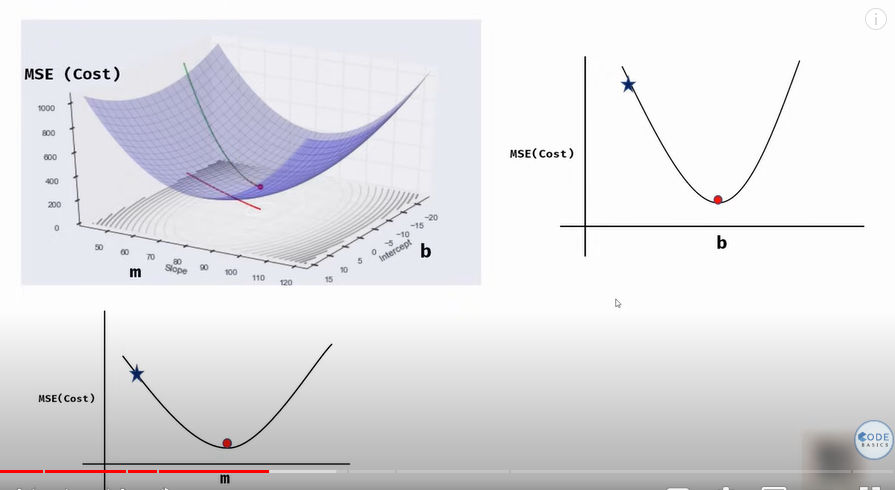

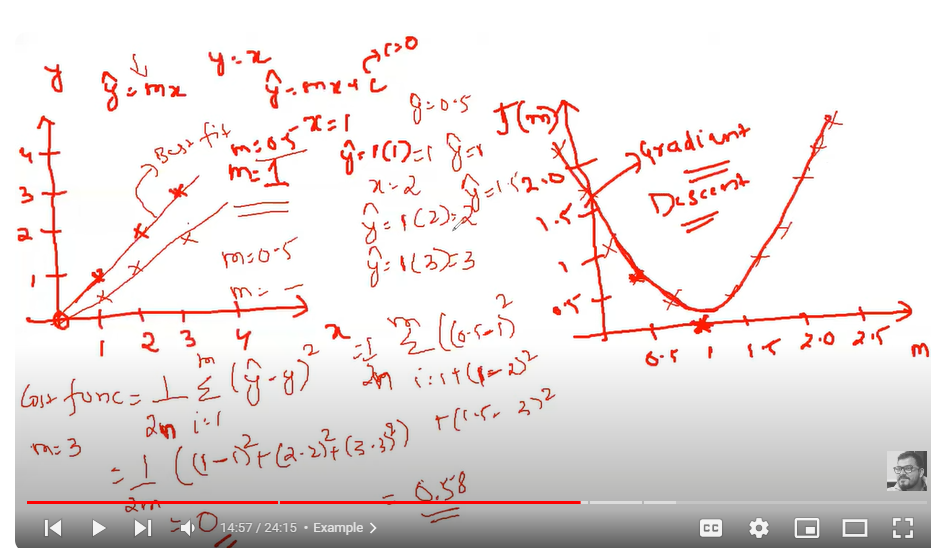

- The goal of using the gradient descent is to attain the global minima point
- Convergence Theorem: A small value should be selected for the learning rate; a larger value will make it harder to reach the global minima. 
- In cases of local minima - mainly is deep learning: Cost function in linear regression does not give local minima. 
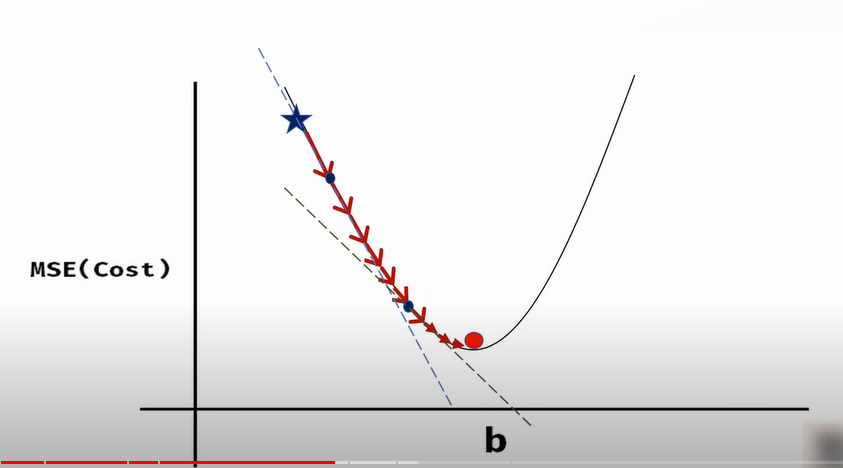

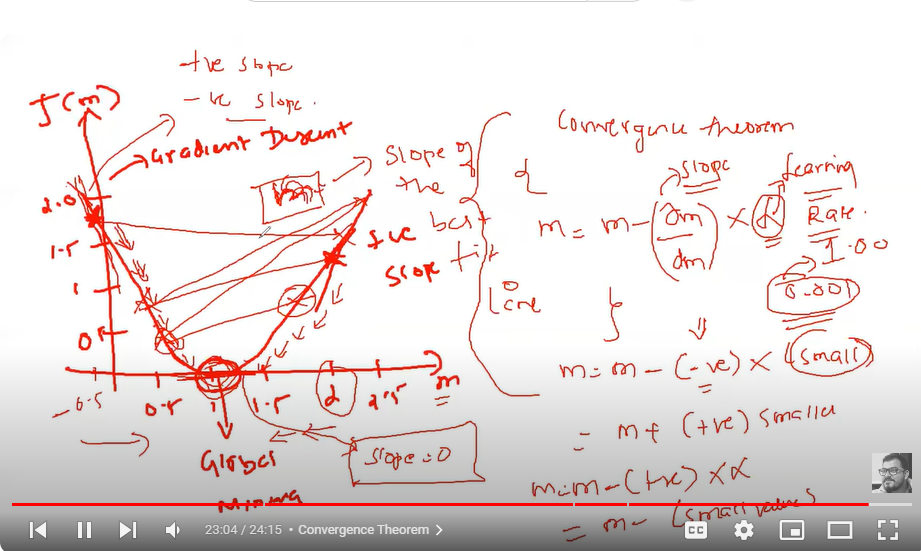

**R square and Adjusted R square Clearly Explained**

The adjusted R-squared is a modified version of R-squared that has been adjusted for the number of predictors in the model. The adjusted R-squared increases only if the new term improves the model more than would be expected by chance. It decreases when a predictor improves the model by less than expected by chance

- In cases where the SS_total value is smaller than he SS_residual value, R2 will be < 0. 
- R2 is used to check the accuracy or the goodness of the best fit line. 
- Adjusted R2 penalizes where the independent variables are not correlated.
- Every time you add an independent variable to a model, the R-squared increases, even if the independent variable is insignificant. It never declines. Whereas Adjusted R-squared increases only when independent variable is significant and affects the dependent variable. 
- Adjusted r-squared value always will be less than or equal to the r-squared value. 

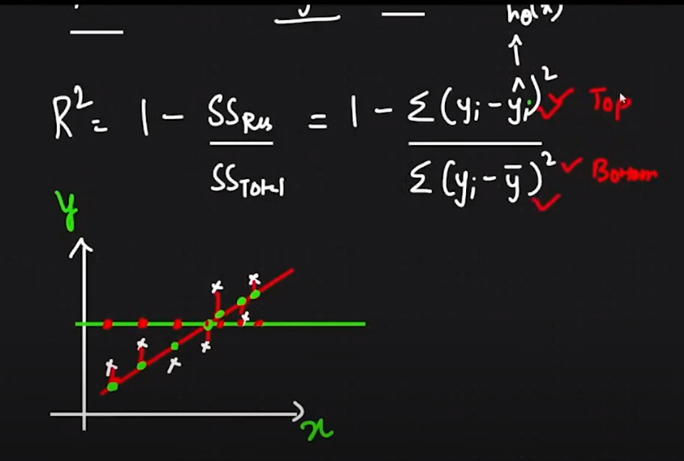
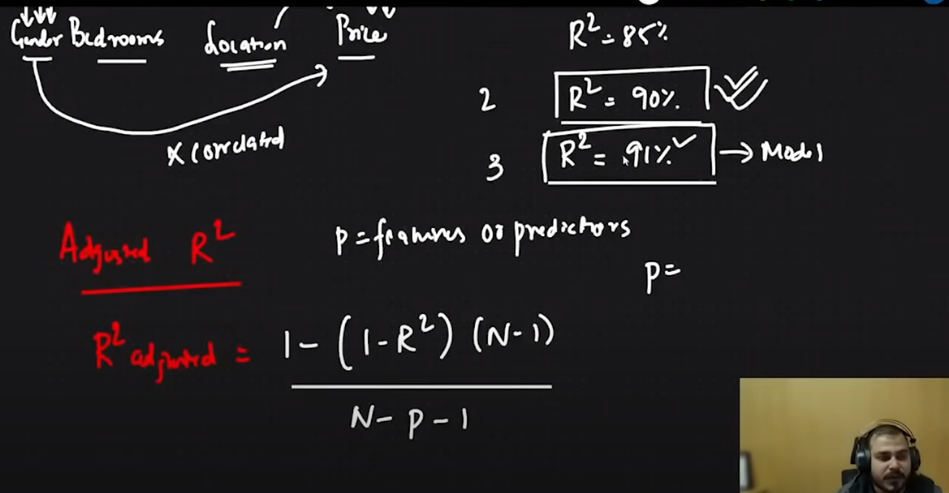
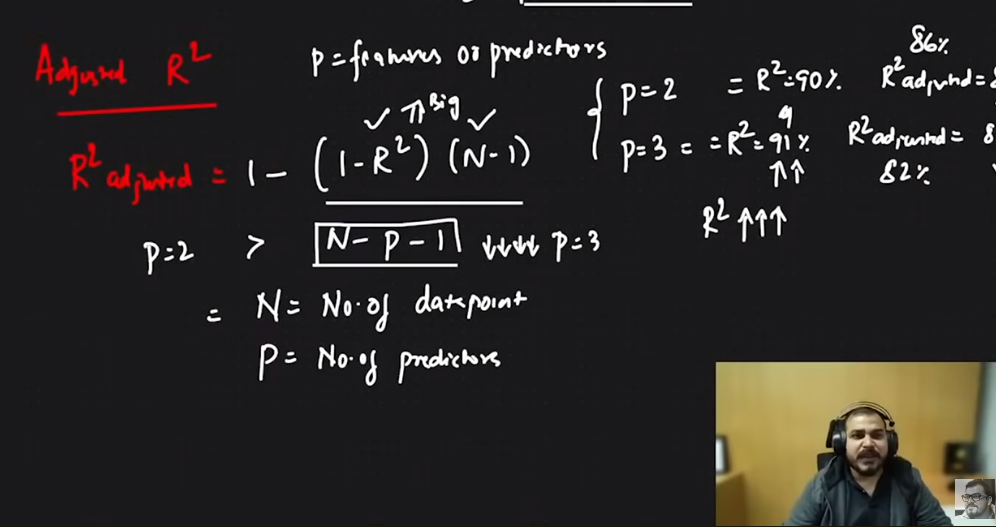


### **Practicals: Linear Regression Single Variable**

In [1]:
import pandas as pd
import numpy as np
from sklearn import linear_model
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
df = pd.read_csv('homeprices.csv')
df

,area,price
0,2600,550000
1,3000,565000
2,3200,610000
3,3600,680000
4,4000,725000


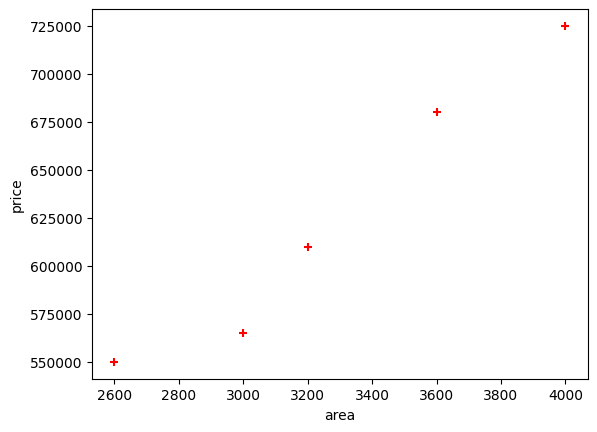

In [3]:
plt.xlabel('area')
plt.ylabel('price')
plt.scatter(df.area,df.price,color='red',marker='+')

In [4]:
new_df = df.drop('price',axis='columns')
new_df

,area
0,2600
1,3000
2,3200
3,3600
4,4000


In [5]:
price = df.price
price

0    550000
1    565000
2    610000
3    680000
4    725000
Name: price, dtype: int64

In [16]:
# Create linear regression object
reg = linear_model.LinearRegression()
reg.fit(new_df,price)

NameError: name 'linear_model' is not defined

In [7]:
reg.predict([[3300]])

c:\Users\ADMIN\Documents\Data Analytics\Machine Learning\Machine Learning Concepts\venv\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(


array([628715.75342466])

In [8]:
reg.coef_

array([135.78767123])

In [9]:
reg.intercept_

np.float64(180616.43835616432)

## **Ridge and Lasso Regression - L1 and L2 Regularization**

- Overfitting:Cases where the model gets low error when using the training dataset but a high error when using the test dataset. Overfit models have high variance. 
- Underfitting: getting high errors both test and train. 
- Ridge and lasso regression used to reduce high variance to low variance in overfitting cases:
- A good generalized model should have low bias and low variance. 
- Bias used with training data while variance is used for test data
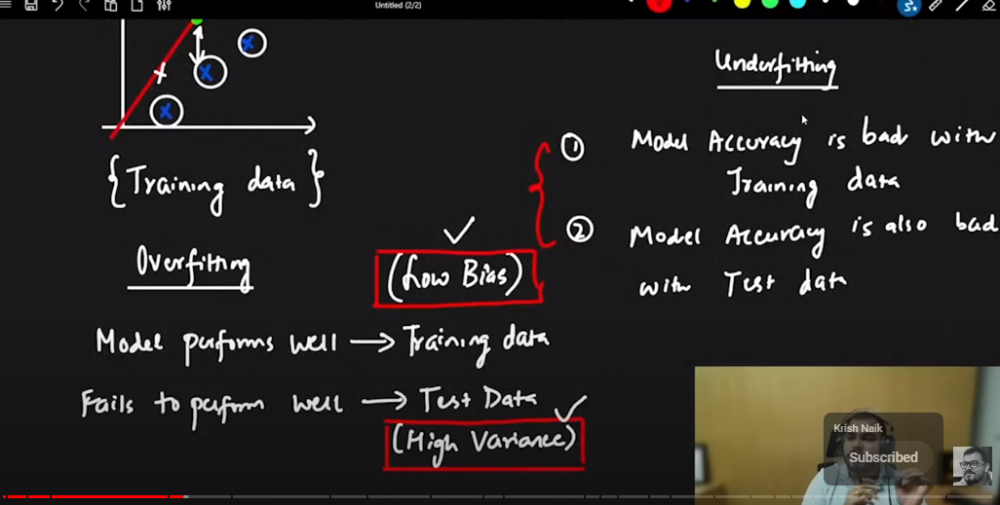
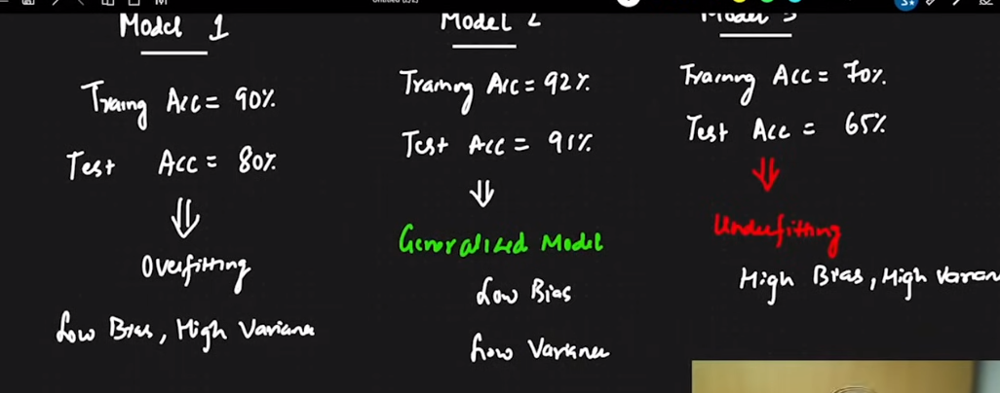

**Ridge Regression - L2 regularization**
- Ridge regression (Also called L2 regularization); penalizing higher slopes - using square
- Lambda value is selected through cross validation. 
- Ridge regression helps reduce overfitting by getting a generalised model

**Lasso Regression - L1 Regularization**
- Lasso regression uses magnitude of slope; Lasso regression also helps to do feature selection
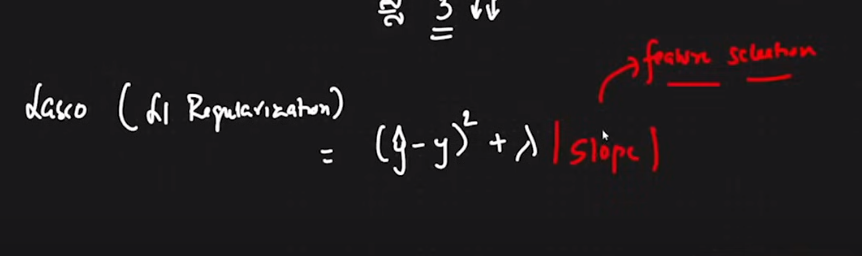

Ridge use square of the slope * lambda whereas lasso uses mode/magnitude. Lasso helps with both preventing overfitting & feature selection

**Assumption of Linear Regression**
- Normal/Gaussian dist - model will get gtrained well. 
- Standardization of the data. 
- Multi colinearity:

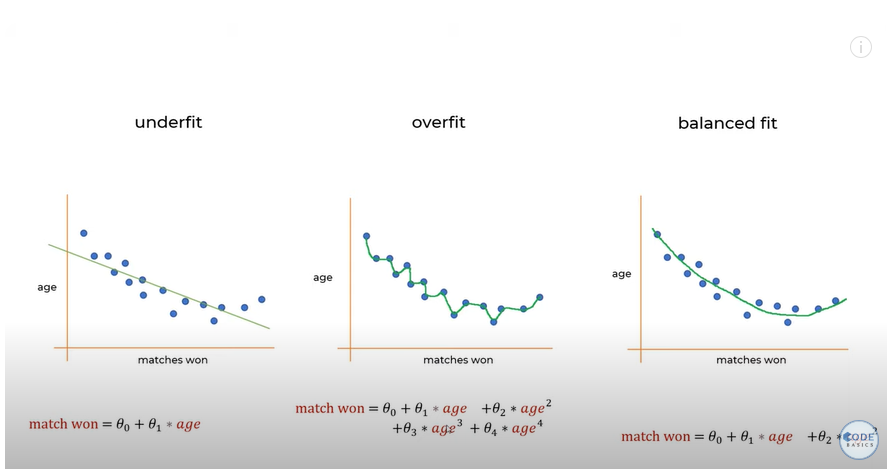
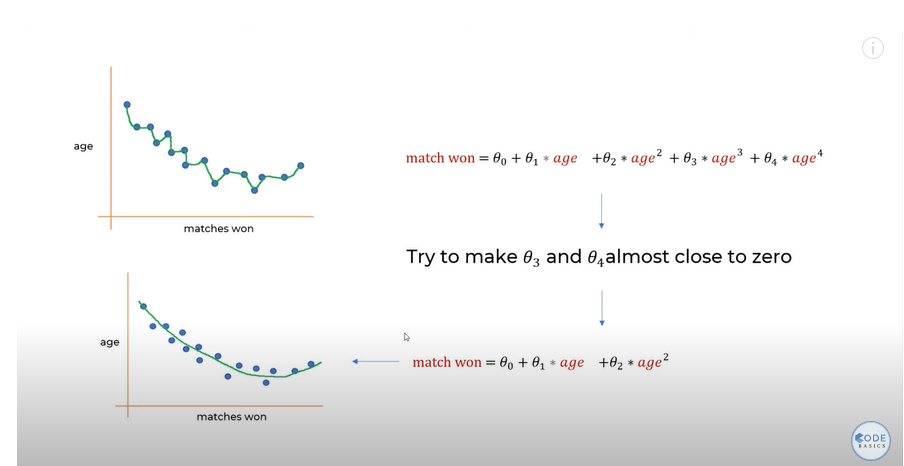
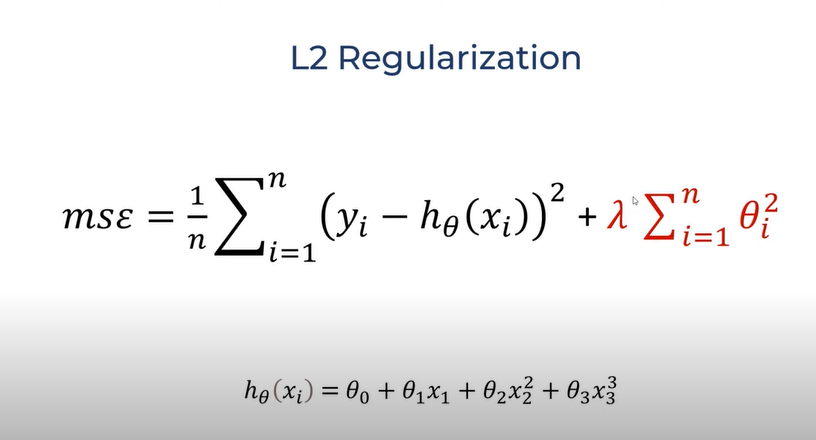
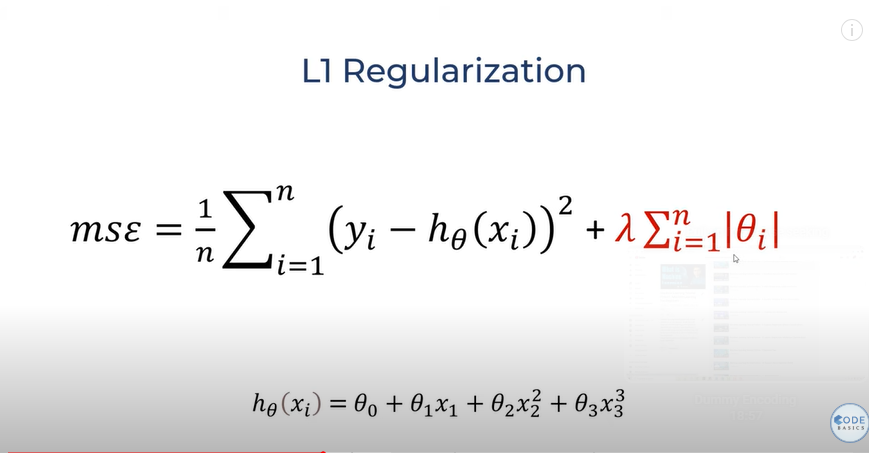

**L1 & L2 Regularization: Practical Implementation**

In [117]:
# import libraries
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

In [118]:
# Suppress Warnings for clean notebook
import warnings
warnings.filterwarnings('ignore')

We are going to use Melbourne House Price Dataset where we'll predict House Predictions based on various features.

The Dataset Link is
https://www.kaggle.com/anthonypino/melbourne-housing-market

In [119]:
# read dataset
dataset = pd.read_csv('./Melbourne_housing_FULL.csv')

In [120]:
dataset.head()

,Suburb,Address,Rooms,Type,Price,Method,SellerG,Date,Distance,Postcode,...,Bathroom,Car,Landsize,BuildingArea,YearBuilt,CouncilArea,Lattitude,Longtitude,Regionname,Propertycount
0,Abbotsford,68 Studley St,2,h,NaN,SS,Jellis,3/09/2016,2.5,3067.0,...,1.0,1.0,126.0,NaN,NaN,Yarra City Council,-37.8014,144.9958,Northern Metropolitan,4019.0
1,Abbotsford,85 Turner St,2,h,1480000.0,S,Biggin,3/12/2016,2.5,3067.0,...,1.0,1.0,202.0,NaN,NaN,Yarra City Council,-37.7996,144.9984,Northern Metropolitan,4019.0
2,Abbotsford,25 Bloomburg St,2,h,1035000.0,S,Biggin,4/02/2016,2.5,3067.0,...,1.0,0.0,156.0,79.0,1900.0,Yarra City Council,-37.8079,144.9934,Northern Metropolitan,4019.0
3,Abbotsford,18/659 Victoria St,3,u,NaN,VB,Rounds,4/02/2016,2.5,3067.0,...,2.0,1.0,0.0,NaN,NaN,Yarra City Council,-37.8114,145.0116,Northern Metropolitan,4019.0
4,Abbotsford,5 Charles St,3,h,1465000.0,SP,Biggin,4/03/2017,2.5,3067.0,...,2.0,0.0,134.0,150.0,1900.0,Yarra City Council,-37.8093,144.9944,Northern Metropolitan,4019.0


In [121]:
# let's use limited columns which makes more sense for serving our purpose
cols_to_use = ['Suburb', 'Rooms', 'Type', 'Method', 'SellerG', 'Regionname', 'Propertycount', 
               'Distance', 'CouncilArea', 'Bedroom2', 'Bathroom', 'Car', 'Landsize', 'BuildingArea', 'Price']
dataset = dataset[cols_to_use]

In [122]:
dataset.shape

(34857, 15)

Checking for Nan values

In [123]:
dataset.isna().sum()

Suburb               0
Rooms                0
Type                 0
Method               0
SellerG              0
Regionname           3
Propertycount        3
Distance             1
CouncilArea          3
Bedroom2          8217
Bathroom          8226
Car               8728
Landsize         11810
BuildingArea     21115
Price             7610
dtype: int64

In [124]:
# Some feature's missing values can be treated as zero (another class for NA values or absence of that feature)
# like 0 for Propertycount, Bedroom2 will refer to other class of NA values
# like 0 for Car feature will mean that there's no car parking feature with house
cols_to_fill_zero = ['Propertycount', 'Distance', 'Bedroom2', 'Bathroom', 'Car']
dataset[cols_to_fill_zero] = dataset[cols_to_fill_zero].fillna(0)

# other continuous features can be imputed with mean for faster results since our focus is on Reducing overfitting
# using Lasso and Ridge Regression
dataset['Landsize'] = dataset['Landsize'].fillna(dataset.Landsize.mean())
dataset['BuildingArea'] = dataset['BuildingArea'].fillna(dataset.BuildingArea.mean())

In [125]:
#Drop NA values of Price, since it's our predictive variable we won't impute it
dataset.dropna(inplace=True)

Let's one hot encode the categorical features

In [126]:
dataset = pd.get_dummies(dataset, drop_first=True)

In [127]:
dataset.head()

,Rooms,Propertycount,Distance,Bedroom2,Bathroom,Car,Landsize,BuildingArea,Price,Suburb_Aberfeldie,...,CouncilArea_Moorabool Shire Council,CouncilArea_Moreland City Council,CouncilArea_Nillumbik Shire Council,CouncilArea_Port Phillip City Council,CouncilArea_Stonnington City Council,CouncilArea_Whitehorse City Council,CouncilArea_Whittlesea City Council,CouncilArea_Wyndham City Council,CouncilArea_Yarra City Council,CouncilArea_Yarra Ranges Shire Council
1,2,4019.0,2.5,2.0,1.0,1.0,202.0,160.2564,1480000.0,False,...,False,False,False,False,False,False,False,False,True,False
2,2,4019.0,2.5,2.0,1.0,0.0,156.0,79.0000,1035000.0,False,...,False,False,False,False,False,False,False,False,True,False
4,3,4019.0,2.5,3.0,2.0,0.0,134.0,150.0000,1465000.0,False,...,False,False,False,False,False,False,False,False,True,False
5,3,4019.0,2.5,3.0,2.0,1.0,94.0,160.2564,850000.0,False,...,False,False,False,False,False,False,False,False,True,False
6,4,4019.0,2.5,3.0,1.0,2.0,120.0,142.0000,1600000.0,False,...,False,False,False,False,False,False,False,False,True,False


Let's bifurcate our dataset into train and test dataset

In [128]:
X = dataset.drop('Price', axis=1)
y = dataset['Price']

In [129]:
from sklearn.model_selection import train_test_split
train_X, test_X, train_y, test_y = train_test_split(X, y, test_size=0.3, random_state=2)

Let's train our Linear Regression Model on training dataset and check the accuracy on test set

In [130]:
from sklearn.linear_model import LinearRegression
reg = LinearRegression().fit(train_X, train_y)

**Let's train our Linear Regression Model on training dataset and check the accuracy on test set**

In [131]:
reg.score(test_X, test_y)

0.13853683161504515

In [132]:
reg.score(train_X, train_y)

0.6827792395792723

Here training score is 68% but test score is 13.85% which is very low. **Normal Regression is clearly overfitting the data, let's try other models**

**Using Lasso(L1 Regularization)**

In [133]:
from sklearn import linear_model
lasso_reg = linear_model.Lasso(alpha=50, max_iter=100, tol=0.1)
lasso_reg.fit(train_X, train_y)

Lasso(alpha=50, max_iter=100, tol=0.1)

In [134]:
lasso_reg.score(test_X, test_y)

0.6636111369404489

In [135]:
lasso_reg.score(train_X, train_y)

0.6766985624766824

**Using Ridge (L2 Regularization**)

In [136]:
from sklearn.linear_model import Ridge
ridge_reg= Ridge(alpha=50, max_iter=100, tol=0.1)
ridge_reg.fit(train_X, train_y)

Ridge(alpha=50, max_iter=100, tol=0.1)

In [137]:
ridge_reg.score(test_X, test_y)

0.6670848945194958

In [138]:
ridge_reg.score(train_X, train_y)

0.6622376739684328

We see that Lasso and Ridge Regularizations prove to be beneficial when our Simple Linear Regression Model overfits. These results may not be that contrast but significant in most cases.Also that L1 & L2 Regularizations are used in Neural Networks too

### **Linear Regression - Multiple Variables**

Multiple linear regression is the most common form of linear regression analysis. As a predictive analysis, the multiple linear regression is used to explain the relationship between one continuous dependent variable and two or more independent variables.


In [10]:
# Importing the libraries
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

# Importing the dataset
dataset = pd.read_csv('50_Startups.csv')
#Getting the dependent and independent featuures
X = dataset.iloc[:, :-1]
y = dataset.iloc[:, 4]

In [11]:
dataset.head(5)

,R&D Spend,Administration,Marketing Spend,State,Profit
0,165349.20,136897.80,471784.10,New York,192261.83
1,162597.70,151377.59,443898.53,California,191792.06
2,153441.51,101145.55,407934.54,Florida,191050.39
3,144372.41,118671.85,383199.62,New York,182901.99
4,142107.34,91391.77,366168.42,Florida,166187.94


In [12]:
X['State'].value_counts()

State
New York      17
California    17
Florida       16
Name: count, dtype: int64

In [13]:
#Convert the column into categorical columns; & droping the first; dummy varaible trap

states=pd.get_dummies(X['State'],drop_first=True)

In [14]:
states.head()

,Florida,New York
0,False,True
1,False,False
2,True,False
3,False,True
4,True,False


In [15]:
# Drop the state coulmn
X=X.drop('State',axis=1)

# concat the dummy variables
X=pd.concat([X,states],axis=1)

In [16]:
X.head()

,R&D Spend,Administration,Marketing Spend,Florida,New York
0,165349.20,136897.80,471784.10,False,True
1,162597.70,151377.59,443898.53,False,False
2,153441.51,101145.55,407934.54,True,False
3,144372.41,118671.85,383199.62,False,True
4,142107.34,91391.77,366168.42,True,False


In [17]:
# Splitting the dataset into the Training set and Test set
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)


In [18]:
# Fitting Multiple Linear Regression to the Training set
from sklearn.linear_model import LinearRegression
regressor = LinearRegression()
regressor.fit(X_train, y_train)

LinearRegression()

In [23]:
regressor.coef_

array([ 7.73467193e-01,  3.28845975e-02,  3.66100259e-02, -9.59284160e+02,
        6.99369053e+02])

In [19]:
# Predicting the Test set results
y_pred = regressor.predict(X_test)

In [20]:
from sklearn.metrics import r2_score
score=r2_score(y_test,y_pred)

In [21]:
score

0.9347068473282423

**MultiCollinearity In Linear Regression**

n regression, "multicollinearity" refers to predictors that are correlated with other predictors. Multicollinearity occurs when your model includes multiple factors that are correlated not just to your response variable, but also to each other. In other words, it results when you have factors that are a bit redundant

In [26]:
import pandas as pd
import statsmodels.api as sm
df_adv = pd.read_csv('Advertising.csv', index_col=0)
X = df_adv[['TV', 'radio','newspaper']]
y = df_adv['sales']
df_adv.head()

,TV,radio,newspaper,sales
1,230.1,37.8,69.2,22.1
2,44.5,39.3,45.1,10.4
3,17.2,45.9,69.3,9.3
4,151.5,41.3,58.5,18.5
5,180.8,10.8,58.4,12.9


In [27]:
X = sm.add_constant(X)

In [28]:
X.head()

,const,TV,radio,newspaper
1,1.0,230.1,37.8,69.2
2,1.0,44.5,39.3,45.1
3,1.0,17.2,45.9,69.3
4,1.0,151.5,41.3,58.5
5,1.0,180.8,10.8,58.4


In [29]:
## fit a OLS model with intercept on TV and Radio

model= sm.OLS(y, X).fit()

In [30]:
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  sales   R-squared:                       0.897
Model:                            OLS   Adj. R-squared:                  0.896
Method:                 Least Squares   F-statistic:                     570.3
Date:                Tue, 23 Jul 2024   Prob (F-statistic):           1.58e-96
Time:                        10:48:00   Log-Likelihood:                -386.18
No. Observations:                 200   AIC:                             780.4
Df Residuals:                     196   BIC:                             793.6
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          2.9389      0.312      9.422      0.000       2.324       3.554
TV             0.0458      0.001     32.809      0.000       0.043       0.049
radio          0.1885      0.009     21.893      0.000       0.172       0.206
newspaper     -0.0010      0.006     -0.177      0.860      -0.013       0.011
==============================================================================
Omnibus:                       60.414   Durbin-Watson:                   2.084
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              151.241
Skew:                          -1.327   Prob(JB):                     1.44e-33
Kurtosis:                       6.332   Cond. No.                         454.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [31]:
import matplotlib.pyplot as plt
X.iloc[:,1:].corr()

,TV,radio,newspaper
TV,1.000000,0.054809,0.056648
radio,0.054809,1.000000,0.354104
newspaper,0.056648,0.354104,1.000000


In [33]:
df_salary = pd.read_csv('Salary_Data.csv')
df_salary.head()

,YearsExperience,Age,Salary
0,1.1,21.0,39343
1,1.3,21.5,46205
2,1.5,21.7,37731
3,2.0,22.0,43525
4,2.2,22.2,39891


In [34]:
X = df_salary[['YearsExperience', 'Age']]
y = df_salary['Salary']

In [35]:
## fit a OLS model with intercept on TV and Radio
X = sm.add_constant(X)
model= sm.OLS(y, X).fit()

In [36]:
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                 Salary   R-squared:                       0.960
Model:                            OLS   Adj. R-squared:                  0.957
Method:                 Least Squares   F-statistic:                     323.9
Date:                Tue, 23 Jul 2024   Prob (F-statistic):           1.35e-19
Time:                        10:48:43   Log-Likelihood:                -300.35
No. Observations:                  30   AIC:                             606.7
Df Residuals:                      27   BIC:                             610.9
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
===================================================================================
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
const           -6661.9872   2.28e+04     -0.292      0.773   -5.35e+04    4.02e+04
YearsExperience  6153.3533   2337.092      2.633      0.014    1358.037    1.09e+04
Age              1836.0136   1285.034      1.429      0.165    -800.659    4472.686
==============================================================================
Omnibus:                        2.695   Durbin-Watson:                   1.711
Prob(Omnibus):                  0.260   Jarque-Bera (JB):                1.975
Skew:                           0.456   Prob(JB):                        0.372
Kurtosis:                       2.135   Cond. No.                         626.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [37]:
X.iloc[:,1:].corr()

,YearsExperience,Age
YearsExperience,1.000000,0.987258
Age,0.987258,1.000000


The above shows age and experience have a high correlation: You can use the p value to decide which feature to drop; drop the feature with the higher p value. 

## **Bias And Variance In Depth Intuition**

In statistics and machine learning, the bias–variance tradeoff is the property of a set of predictive models whereby models with a lower bias in parameter estimation have a higher variance of the parameter estimates across samples, and vice versa

Bias is the error of the training data while variance is the error of the test data

Bias is a measurement of how accurately a model can capture a pattern on a training dataset. 

The following case for regression & classification:
- Underfitting; The training data has high error(**high bias**) and test data also has a high error (**High Variance**). 
- Overfitting: The error from training data is very low(**Low Bias**) but a high error (**High Variance**) on the test data.
- A generalised model has a low error(**Low Bias**) on training data and low error on test data.(**Low Variance**) 

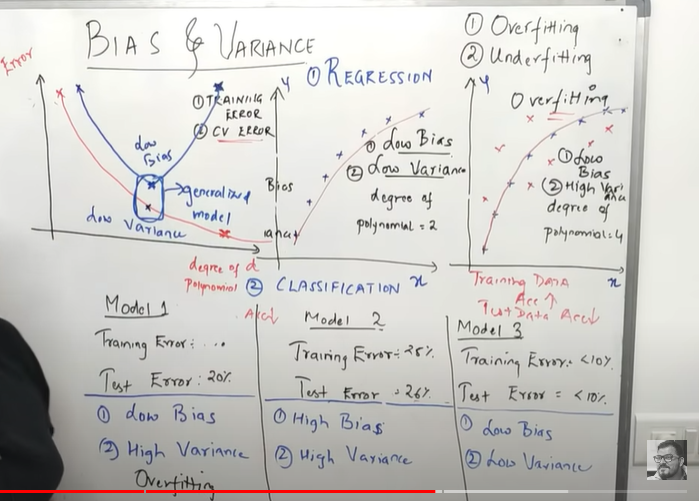

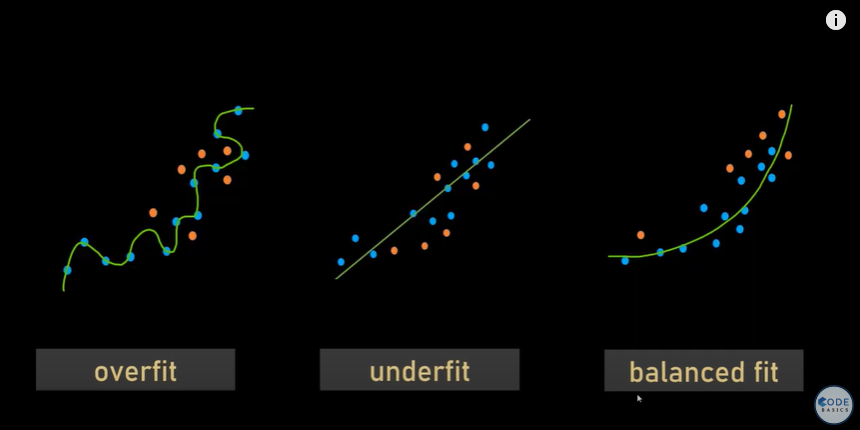

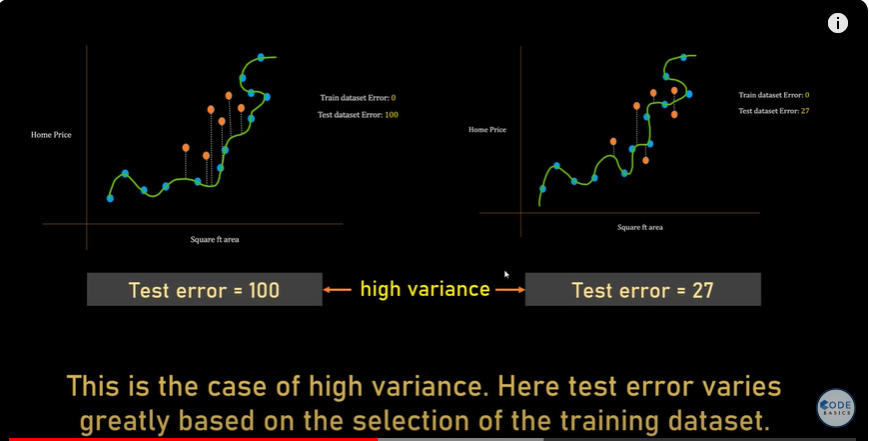

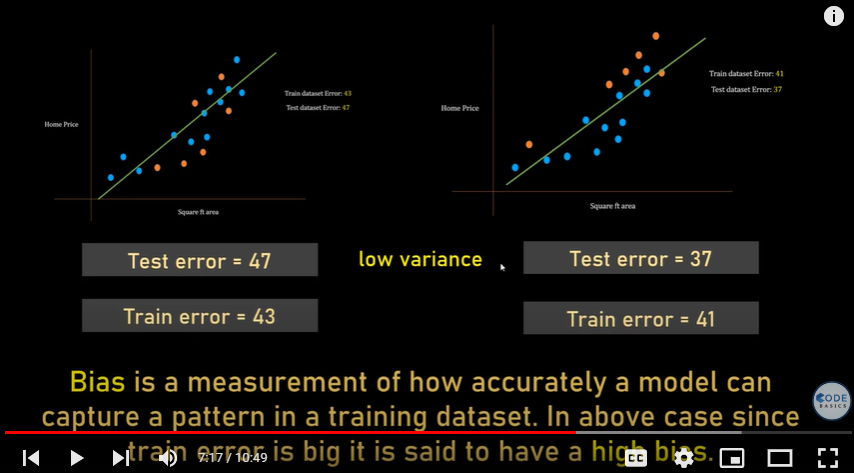

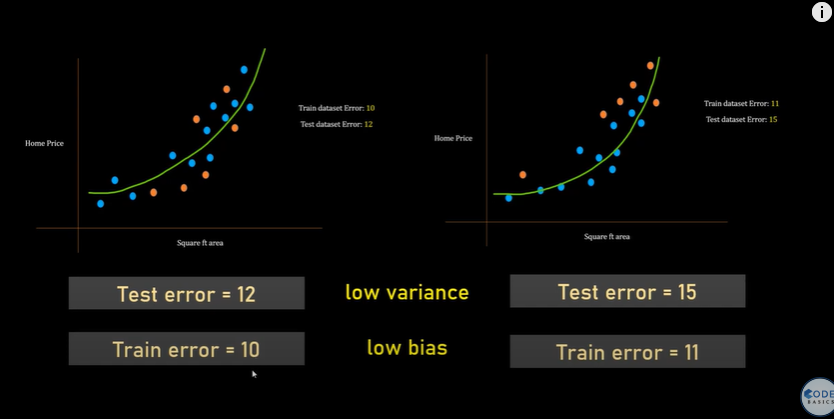

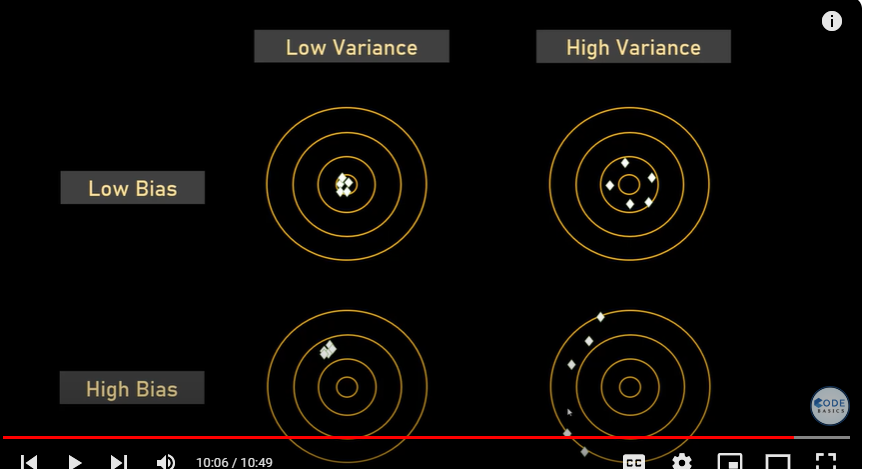


**ways to get a balanced fit model**

- Cross Validation
- Regularization
- Dimensionality Reduction
- Ensemble Technqiues - Bagging & Boosting

## **Stats Refresher**

### **Hypothesis Test, Type 1 Error, Type 2 Error**

Hypothesis testing evaluates 2 mutual exclusive statements; The following are the steps:
- Make the initial assumption; Ho(Null Hypothesis)
- Collect the data
- Gather evidence and analyse whether to reject the null hypothesis or not reject(accept)
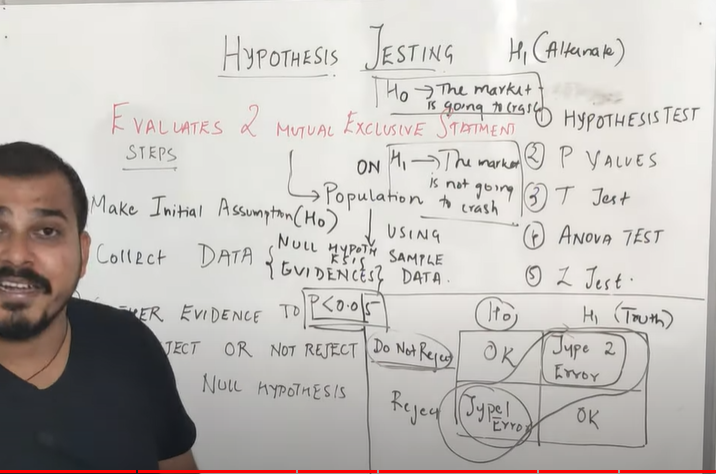

**What Is P Value In Statistics**

- P value is the probability for the null hypothesis to be true.
- Based on the domain, if the p value is < 0.05 the null hyppothesis is rejected. 
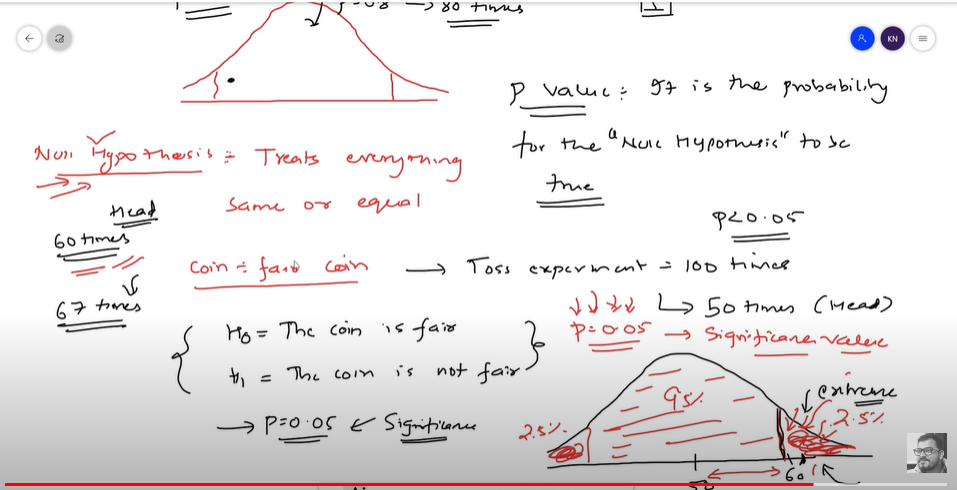

### **All About P Value,T test,Chi Square Test, Anova Test and When to Use What?**

- One categorical feature: **One sample propotion test**; when using one feature : One categorical e.g. is there are difference in propotion of the sample based on gender?
- Two categorical; is there a difference between gender propotions based on age group? Use **Chi Square test**. : using 2 categorical features. 
- One continuous variable: **T test**: e.g comparing a population and a sample
- 2 continous/numerical variables: **Correlation Test**; H1 : There's a relationship Ho: There's no relationship. 
- Categorical variables where there's more than two categories; **ANOVA**

**T Test**

**T Test**

A t-test is a type of inferential statistic which is used to determine if there is a significant difference between the means of two groups which may be related in certain features

T-test has 2 types : 
- 1. one sampled t-test Tells us whether the mean of the sample and the population are different. 
- 2. two-sampled t-test.

**One Sample T-Test**

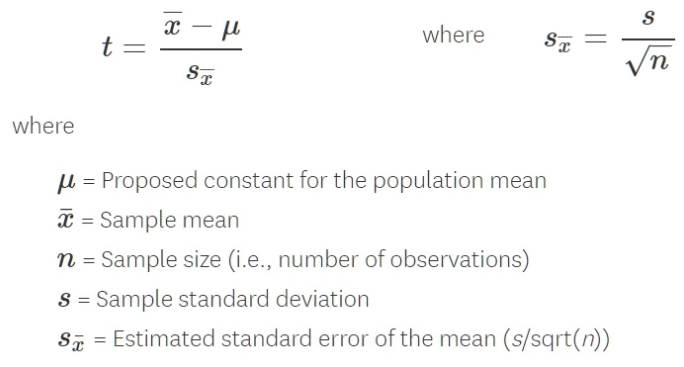

In [38]:
#data
ages=[10,20,35,50,28,40,55,18,16,55,30,25,43,18,30,28,14,24,16,17,32,35,26,27,65,18,43,23,21,20,19,70]

In [39]:
len(ages)

32

In [40]:
import numpy as np
ages_mean=np.mean(ages) # getting the mean of the class/population
print(ages_mean)

30.34375


In [41]:
## Lets take sample with size=10 randomly selected from the list using the np.random.choice() method
sample_size=10
age_sample=np.random.choice(ages,sample_size)

In [42]:
age_sample

array([35, 30, 17, 16, 27, 20, 16, 43, 28, 27])

In [43]:
age_sample.mean()

np.float64(25.9)

In [44]:
#using the scipy.stats module
from scipy.stats import ttest_1samp
#using t test to compare the sample and pop mean
ttest,p_value=ttest_1samp(age_sample,30)

In [45]:
print(p_value)

0.17806330377080842


In [46]:
if p_value < 0.05:    # alpha value is 0.05 or 5%
    print(" we are rejecting null hypothesis")
else:
    print("we are accepting null hypothesis")

we are accepting null hypothesis


**Some More Examples**

Considering the age of students in a collenge and age of students in class A

- H0 - The mean of ages of students of class A is similar to the entire college. 
- H1: The mean of ages of students of class A is NOT similar to the entire college.

In [47]:
import numpy as np
import pandas as pd
import scipy.stats as stats
import math
np.random.seed(6)
#generates the distribution with mean of 35 & 30 with loc being the lowest or the left most value
school_ages=stats.poisson.rvs(loc=18,mu=35,size=1500)
classA_ages=stats.poisson.rvs(loc=18,mu=30,size=60)


In [48]:
classA_ages.mean()

np.float64(46.9)

In [49]:
_,p_value=stats.ttest_1samp(a=classA_ages,popmean=school_ages.mean())

In [50]:
p_value

np.float64(1.139027071016194e-13)

In [51]:
school_ages.mean()

np.float64(53.303333333333335)

In [52]:
if p_value < 0.05:    # alpha value is 0.05 or 5%
    print(" we are rejecting null hypothesis")
else:
    print("we are accepting null hypothesis")

 we are rejecting null hypothesis


**Two Sample T Test**

The independent sample t test or the two sample t test compares the means of two independent groups in order to determine whether there is a statistical evidence that the associated population means are different. The independent sample T test is a parametric test. This is also known as independent t test. 

In [53]:
#creating an array for the second independent group
np.random.seed(2)
classB_ages = stats.poisson.rvs(loc = 18,mu=33,size=60)
classB_ages.mean()

np.float64(50.8)

In [54]:
#performing 2 sample t test/ independent t test
_,p_value = stats.ttest_ind(a = classA_ages, b = classB_ages, equal_var = False)

In [8]:
if p_value <0.05:
    print("we are rejecting the null hypothesis")
else:
    print("we are accepting the null hypothesis")

we are rejecting the null hypothesis


**Paired T Test with Python**

This is used when you want to check how different samples from the same group are.

In [55]:
#creating two groups/samples
weight1 = [25,30,28,35,28,34,26,29,30,26,28,32,31,30,45]

#creating the secind group adding
weight2 = weight1+ stats.norm.rvs(scale =5,loc = 1.25,size = 15)

print(weight1)
print(weight2)

[25, 30, 28, 35, 28, 34, 26, 29, 30, 26, 28, 32, 31, 30, 45]
[22.75705025 26.60554038 42.00219118 28.88413376 24.14292635 37.4119785
 25.63209965 32.36912354 35.24589998 33.56306832 33.00982425 28.28119508
 37.79571641 22.42541136 45.67789351]


In [56]:
#creating a dataframe
weight_df = pd.DataFrame({"weightA":np.array(weight1),
                        "weightB":np.array(weight2),
                         "weight_change":np.array(weight1) - np.array(weight2)  }
                        
                        )
weight_df

,weightA,weightB,weight_change
0,25,22.757050,2.242950
1,30,26.605540,3.394460
2,28,42.002191,-14.002191
3,35,28.884134,6.115866
4,28,24.142926,3.857074
5,34,37.411979,-3.411979
6,26,25.632100,0.367900
7,29,32.369124,-3.369124
8,30,35.245900,-5.245900
9,26,33.563068,-7.563068


In [13]:
#calculating T test
#This is a test for the null hypothesis that two related or repeated samples have identical average (expected) values.
_,p_value = stats.ttest_rel(a=weight1, b = weight2)

In [14]:
if p_value <0.05:
    print("we are rejecting the null hypothesis")
else:
    print("we are accepting the null hypothesis")

we are accepting the null hypothesis


**Correlation**

In [57]:
import seaborn as sns
df = sns.load_dataset('iris')
df.head()

,sepal_length,sepal_width,petal_length,petal_width,species
0,5.1,3.5,1.4,0.2,setosa
1,4.9,3.0,1.4,0.2,setosa
2,4.7,3.2,1.3,0.2,setosa
3,4.6,3.1,1.5,0.2,setosa
4,5.0,3.6,1.4,0.2,setosa


In [22]:
df.columns

Index(['sepal_length', 'sepal_width', 'petal_length', 'petal_width',
       'species'],
      dtype='object')

In [58]:
#correlation
df[['sepal_length', 'sepal_width', 'petal_length', 'petal_width']].corr()

,sepal_length,sepal_width,petal_length,petal_width
sepal_length,1.000000,-0.117570,0.871754,0.817941
sepal_width,-0.117570,1.000000,-0.428440,-0.366126
petal_length,0.871754,-0.428440,1.000000,0.962865
petal_width,0.817941,-0.366126,0.962865,1.000000


**Chi Square Test**

The test is used when you have two categorical variables from a single population. It is used to determine whether there is a significant association between the two variables. 

Helps to do feature selection. 

This is a non parametric test that is performed on categorical(nominal or ordinal data)

Stats Lectures: https://www.youtube.com/watch?v=LE3AIyY_cn8

In [59]:
#Importing neccessary libraries
import scipy.stats as stats
import pandas as pd
import numpy as np
import seaborn as sns
dataset = sns.load_dataset('tips')

In [60]:
dataset.head()

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2
4,24.59,3.61,Female,No,Sun,Dinner,4


**Exploring whether there is an relationship or association between the Sex and Smoker variables**

In [61]:
#applying crosstab to get a matrix of the two features
dataset_table =  pd.crosstab(dataset['sex'],dataset['smoker'])
print(dataset_table)

smoker  Yes  No
sex            
Male     60  97
Female   33  54


In [62]:
dataset_table

smoker,Yes,No
sex,,
Male,60,97
Female,33,54


In [63]:
dataset_table.values

array([[60, 97],
       [33, 54]])

In [64]:
Observed_Values = dataset_table.values
Observed_Values

array([[60, 97],
       [33, 54]])

In [65]:
#calculating the expected values
val  = stats.chi2_contingency(dataset_table)
val

Chi2ContingencyResult(statistic=np.float64(0.0), pvalue=np.float64(1.0), dof=1, expected_freq=array([[59.84016393, 97.15983607],
       [33.15983607, 53.84016393]]))

In [66]:
Expected_Values = val[3]
Expected_Values


array([[59.84016393, 97.15983607],
       [33.15983607, 53.84016393]])

In [67]:
#calculating the degress of Freedon
no_of_rows=len(dataset_table.iloc[0:2,0])
no_of_columns=len(dataset_table.iloc[0,0:2])
ddof=(no_of_rows-1)*(no_of_columns-1)
print("Degree of Freedom:",ddof)
alpha = 0.05

Degree of Freedom: 1


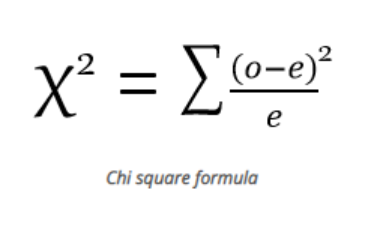

In [68]:
from scipy.stats import chi2
chi_square=sum([(o-e)**2./e for o,e in zip(Observed_Values,Expected_Values)])
chi_square_statistic=chi_square[0]+chi_square[1]

In [69]:
print("chi-square statistic:-",chi_square_statistic)

chi-square statistic:- 0.001934818536627623


In [70]:
critical_value=chi2.ppf(q=1-alpha,df=ddof)
print('critical_value:',critical_value)

critical_value: 3.841458820694124


In [71]:
#p-value
p_value=1-chi2.cdf(x=chi_square_statistic,df=ddof)
print('p-value:',p_value)
print('Significance level: ',alpha)
print('Degree of Freedom: ',ddof)
print('p-value:',p_value)
     

p-value: 0.964915107315732
Significance level:  0.05
Degree of Freedom:  1
p-value: 0.964915107315732


In [42]:
if chi_square_statistic>=critical_value:
    print("Reject H0,There is a relationship between 2 categorical variables")
else:
    print("Retain H0,There is no relationship between 2 categorical variables")
    
if p_value<=alpha:
    print("Reject H0,There is a relationship between 2 categorical variables")
else:
    print("Retain H0,There is no relationship between 2 categorical variables")

Retain H0,There is no relationship between 2 categorical variables
Retain H0,There is no relationship between 2 categorical variables


## **Categorical Variables & One Hot Encoding**

Machine learning models work very well for dataset having only numbers. But how do we handle text information in dataset? Simple approach is to use interger or label encoding but when categorical variables are nominal, using simple label encoding can be problematic. One hot encoding is the technique that can help in this situation. In this tutorial, we will use pandas get_dummies method to create dummy variables that allows us to perform one hot encoding on given dataset. Alternatively we can use sklearn.preprocessing OneHotEncoder as well to create dummy variables. 
- Nominal - Categories do not have a numerical order: e.g. gender, colors
- Ordinal - Categoroes have some order - e.g High, Medium, Low, CSAT Scores

In [74]:
import pandas as pd
df = pd.read_csv("homeprices_1.csv")
df

,town,area,price
0,monroe township,2600,550000
1,monroe township,3000,565000
2,monroe township,3200,610000
3,monroe township,3600,680000
4,monroe township,4000,725000
5,west windsor,2600,585000
6,west windsor,2800,615000
7,west windsor,3300,650000
8,west windsor,3600,710000
9,robinsville,2600,575000


In [75]:
dummies = pd.get_dummies(df.town)
dummies

,monroe township,robinsville,west windsor
0,True,False,False
1,True,False,False
2,True,False,False
3,True,False,False
4,True,False,False
5,False,False,True
6,False,False,True
7,False,False,True
8,False,False,True
9,False,True,False


In [76]:
merged = pd.concat([df,dummies],axis='columns')
merged

,town,area,price,monroe township,robinsville,west windsor
0,monroe township,2600,550000,True,False,False
1,monroe township,3000,565000,True,False,False
2,monroe township,3200,610000,True,False,False
3,monroe township,3600,680000,True,False,False
4,monroe township,4000,725000,True,False,False
5,west windsor,2600,585000,False,False,True
6,west windsor,2800,615000,False,False,True
7,west windsor,3300,650000,False,False,True
8,west windsor,3600,710000,False,False,True
9,robinsville,2600,575000,False,True,False


In [77]:
final = merged.drop(['town'], axis='columns')
final

,area,price,monroe township,robinsville,west windsor
0,2600,550000,True,False,False
1,3000,565000,True,False,False
2,3200,610000,True,False,False
3,3600,680000,True,False,False
4,4000,725000,True,False,False
5,2600,585000,False,False,True
6,2800,615000,False,False,True
7,3300,650000,False,False,True
8,3600,710000,False,False,True
9,2600,575000,False,True,False


**Dummy Variable Trap**
When you can derive one variable from other variables, they are known to be multi-colinear. Here if you know values of california and georgia then you can easily infer value of new jersey state, i.e. california=0 and georgia=0. There for these state variables are called to be multi-colinear. In this situation linear regression won't work as expected. Hence you need to drop one column.

NOTE: sklearn library takes care of dummy variable trap hence even if you don't drop one of the state columns it is going to work, however we should make a habit of taking care of dummy variable trap ourselves just in case library that you are using is not handling this for you

In [78]:
final = final.drop(['west windsor'], axis='columns')
final

,area,price,monroe township,robinsville
0,2600,550000,True,False
1,3000,565000,True,False
2,3200,610000,True,False
3,3600,680000,True,False
4,4000,725000,True,False
5,2600,585000,False,False
6,2800,615000,False,False
7,3300,650000,False,False
8,3600,710000,False,False
9,2600,575000,False,True


In [79]:
X = final.drop('price', axis='columns')
X

,area,monroe township,robinsville
0,2600,True,False
1,3000,True,False
2,3200,True,False
3,3600,True,False
4,4000,True,False
5,2600,False,False
6,2800,False,False
7,3300,False,False
8,3600,False,False
9,2600,False,True


In [80]:
y = final.price

In [81]:
from sklearn.linear_model import LinearRegression
model = LinearRegression()

In [82]:
model.fit(X,y)

LinearRegression()

In [83]:
model.predict(X) # 2600 sqr ft home in new jersey

array([539709.7398409 , 590468.71640508, 615848.20468716, 666607.18125134,
       717366.15781551, 579723.71533005, 605103.20361213, 668551.92431735,
       706621.15674048, 565396.15136531, 603465.38378844, 628844.87207052,
       692293.59277574])

In [84]:
model.score(X,y)

0.9573929037221872

In [85]:
model.predict([[3400,0,0]]) # 3400 sqr ft home in west windsor

c:\Users\ADMIN\Documents\Data Analytics\Machine Learning\Machine Learning Concepts\venv\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(


array([681241.66845839])

### **Using sklearn OneHotEncoder**
First step is to use label encoder to convert town names into numbers

In [86]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()

In [87]:
dfle = df
dfle.town = le.fit_transform(dfle.town)
dfle

,town,area,price
0,0,2600,550000
1,0,3000,565000
2,0,3200,610000
3,0,3600,680000
4,0,4000,725000
5,2,2600,585000
6,2,2800,615000
7,2,3300,650000
8,2,3600,710000
9,1,2600,575000


In [88]:
X = dfle[['town','area']].values
X

array([[   0, 2600],
       [   0, 3000],
       [   0, 3200],
       [   0, 3600],
       [   0, 4000],
       [   2, 2600],
       [   2, 2800],
       [   2, 3300],
       [   2, 3600],
       [   1, 2600],
       [   1, 2900],
       [   1, 3100],
       [   1, 3600]])

In [89]:
y = dfle.price.values
y

array([550000, 565000, 610000, 680000, 725000, 585000, 615000, 650000,
       710000, 575000, 600000, 620000, 695000])

In [90]:
#Now use one hot encoder to create dummy variables for each of the town
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
ct = ColumnTransformer([('town', OneHotEncoder(), [0])], remainder = 'passthrough')

In [91]:
X = ct.fit_transform(X)
X

array([[1.0e+00, 0.0e+00, 0.0e+00, 2.6e+03],
       [1.0e+00, 0.0e+00, 0.0e+00, 3.0e+03],
       [1.0e+00, 0.0e+00, 0.0e+00, 3.2e+03],
       [1.0e+00, 0.0e+00, 0.0e+00, 3.6e+03],
       [1.0e+00, 0.0e+00, 0.0e+00, 4.0e+03],
       [0.0e+00, 0.0e+00, 1.0e+00, 2.6e+03],
       [0.0e+00, 0.0e+00, 1.0e+00, 2.8e+03],
       [0.0e+00, 0.0e+00, 1.0e+00, 3.3e+03],
       [0.0e+00, 0.0e+00, 1.0e+00, 3.6e+03],
       [0.0e+00, 1.0e+00, 0.0e+00, 2.6e+03],
       [0.0e+00, 1.0e+00, 0.0e+00, 2.9e+03],
       [0.0e+00, 1.0e+00, 0.0e+00, 3.1e+03],
       [0.0e+00, 1.0e+00, 0.0e+00, 3.6e+03]])

In [92]:
#Dropping the first column
X = X[:,1:]
X

array([[0.0e+00, 0.0e+00, 2.6e+03],
       [0.0e+00, 0.0e+00, 3.0e+03],
       [0.0e+00, 0.0e+00, 3.2e+03],
       [0.0e+00, 0.0e+00, 3.6e+03],
       [0.0e+00, 0.0e+00, 4.0e+03],
       [0.0e+00, 1.0e+00, 2.6e+03],
       [0.0e+00, 1.0e+00, 2.8e+03],
       [0.0e+00, 1.0e+00, 3.3e+03],
       [0.0e+00, 1.0e+00, 3.6e+03],
       [1.0e+00, 0.0e+00, 2.6e+03],
       [1.0e+00, 0.0e+00, 2.9e+03],
       [1.0e+00, 0.0e+00, 3.1e+03],
       [1.0e+00, 0.0e+00, 3.6e+03]])

In [93]:
model.fit(X,y)

LinearRegression()

In [94]:
model.predict([[0,1,3400]]) # 3400 sqr ft home in west windsor

array([681241.6684584])

## **Logistic Regression(Binary Classification)**

Regression the predicted value is continous while for classifcation the predicted value is categorical. 

There are two types of classification problems:
- Binary classification
- Multi-class classification

Reasons why Linear Regression isn't used:
- Outliers cause the line of best fit to deviate
- For such outliers, the output would either be greater than 1 or less than 0

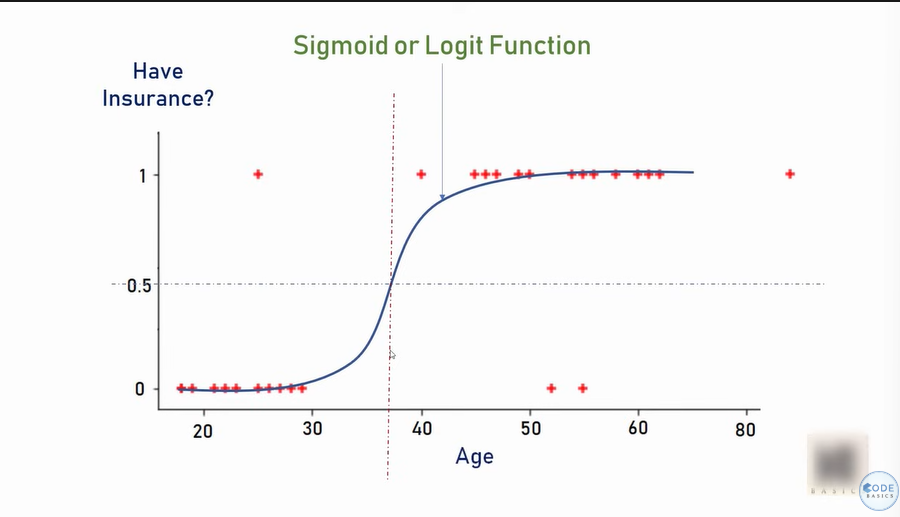

- Sigmoid function removes the effect of the outliers
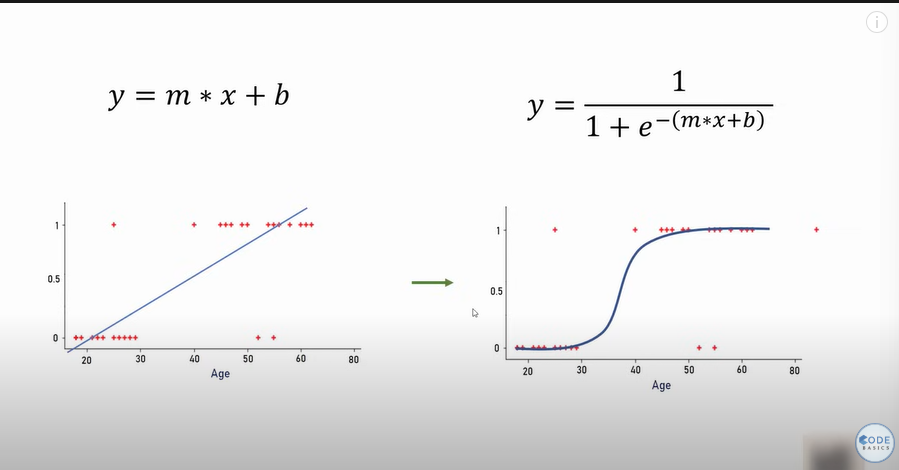



**Practical Implementation**
- Predicting if a person would buy life insurnace based on his age using logistic regression
- Above is a binary logistic regression problem as there are only two possible outcomes (i.e. if person buys insurance or he/she doesn't).

In [95]:
import pandas as pd
from matplotlib import pyplot as plt
%matplotlib inline

In [96]:
df = pd.read_csv("insurance_data.csv")
df.head()

,age,bought_insurance
0,22,0
1,25,0
2,47,1
3,52,0
4,46,1


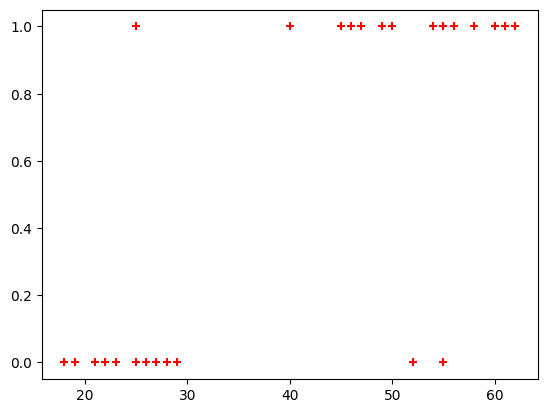

In [97]:
plt.scatter(df.age,df.bought_insurance,marker='+',color='red')

In [98]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(df[['age']],df.bought_insurance,train_size=0.8)

In [99]:
X_test

,age
18,19
13,29
0,22
16,25
19,18
26,23


In [102]:
X_train.shape, X_test.shape

((21, 1), (6, 1))

In [100]:
from sklearn.linear_model import LogisticRegression
model = LogisticRegression()

In [101]:
model.fit(X_train, y_train)

LogisticRegression()

In [107]:
y_predicted = model.predict(X_test)
y_predicted

array([0, 0, 0, 0, 0, 0])

In [105]:
#preoicting probabality
model.predict_proba(X_test)

array([[0.96478532, 0.03521468],
       [0.85355921, 0.14644079],
       [0.94511922, 0.05488078],
       [0.91543302, 0.08456698],
       [0.96968144, 0.03031856],
       [0.93651626, 0.06348374]])

In [106]:
model.score(X_test,y_test)

0.8333333333333334

## **Logistic Regression(Multiclass Classification**)

In [108]:
from sklearn.datasets import load_digits
%matplotlib inline
import matplotlib.pyplot as plt
digits = load_digits()

In [109]:
dir(digits)

['DESCR', 'data', 'feature_names', 'frame', 'images', 'target', 'target_names']

In [110]:
digits.data[0]

array([ 0.,  0.,  5., 13.,  9.,  1.,  0.,  0.,  0.,  0., 13., 15., 10.,
       15.,  5.,  0.,  0.,  3., 15.,  2.,  0., 11.,  8.,  0.,  0.,  4.,
       12.,  0.,  0.,  8.,  8.,  0.,  0.,  5.,  8.,  0.,  0.,  9.,  8.,
        0.,  0.,  4., 11.,  0.,  1., 12.,  7.,  0.,  0.,  2., 14.,  5.,
       10., 12.,  0.,  0.,  0.,  0.,  6., 13., 10.,  0.,  0.,  0.])

<Figure size 640x480 with 0 Axes>

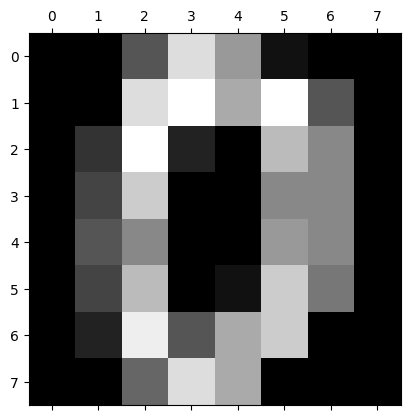

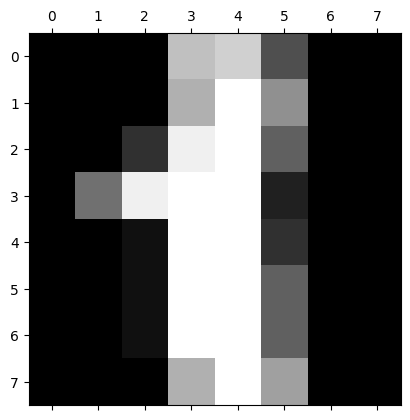

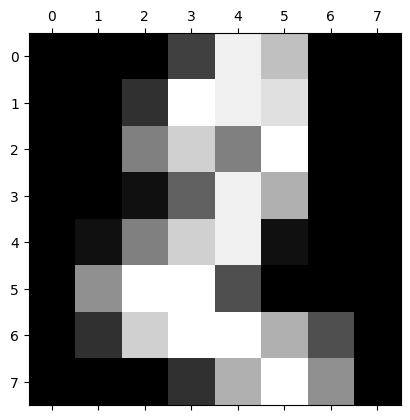

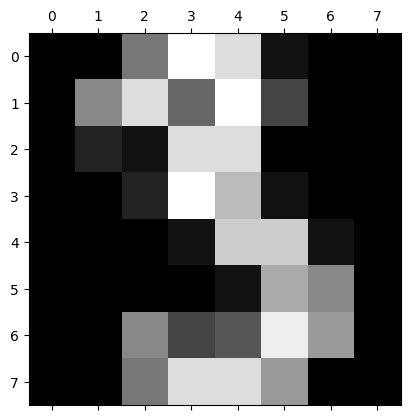

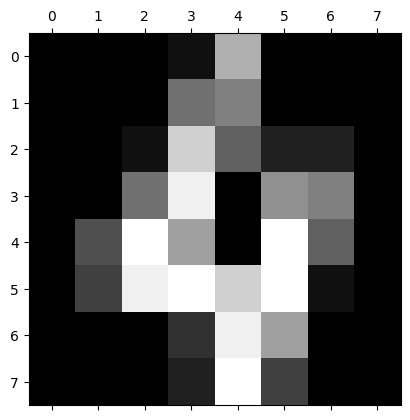

In [111]:
plt.gray() 
for i in range(5):
    plt.matshow(digits.images[i]) 

In [112]:
digits.target[0:5]

array([0, 1, 2, 3, 4])

In [113]:
from sklearn.linear_model import LogisticRegression
model = LogisticRegression()

In [114]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(digits.data,digits.target, test_size=0.2)

In [115]:
model.fit(X_train, y_train)

c:\Users\ADMIN\Documents\Data Analytics\Machine Learning\Machine Learning Concepts\venv\lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression()

In [116]:
model.score(X_test, y_test)

0.9694444444444444

In [119]:
model.predict(digits.data[0:5]),digits.target[0:5]

(array([0, 1, 2, 3, 4]), array([0, 1, 2, 3, 4]))

In [120]:
y_predicted = model.predict(X_test)

In [121]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test, y_predicted)
cm

array([[28,  0,  0,  0,  0,  0,  0,  0,  0,  0],
       [ 0, 35,  0,  0,  1,  0,  0,  0,  1,  1],
       [ 0,  0, 43,  0,  0,  0,  0,  0,  0,  0],
       [ 0,  0,  0, 43,  0,  0,  0,  0,  2,  0],
       [ 0,  0,  0,  0, 36,  0,  0,  0,  0,  0],
       [ 0,  1,  0,  0,  0, 31,  0,  0,  0,  0],
       [ 0,  0,  0,  0,  0,  0, 40,  0,  1,  0],
       [ 0,  0,  0,  0,  0,  0,  0, 32,  0,  0],
       [ 0,  1,  1,  0,  0,  0,  0,  0, 33,  0],
       [ 0,  0,  0,  0,  0,  1,  0,  0,  1, 28]])

Text(95.72222222222221, 0.5, 'Truth')

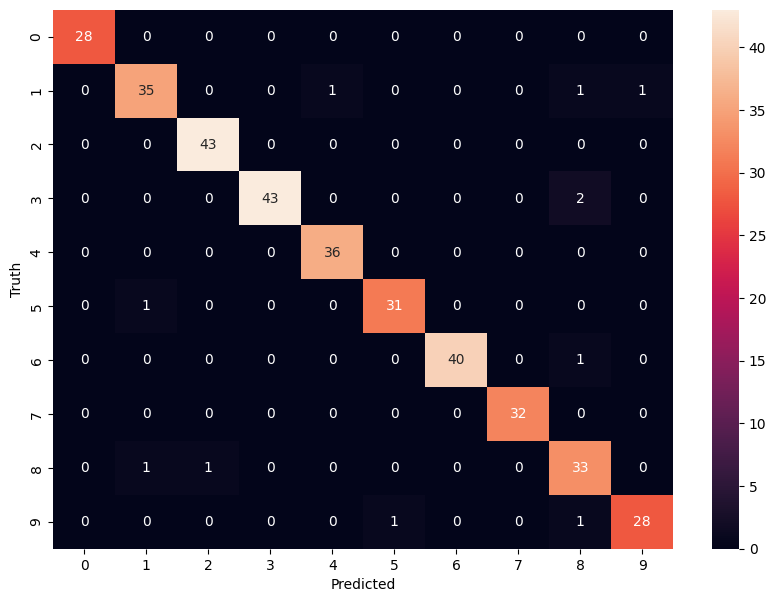

In [122]:
import seaborn as sn
plt.figure(figsize = (10,7))
sn.heatmap(cm, annot=True)
plt.xlabel('Predicted')
plt.ylabel('Truth')

## **Performance Metrics For Classification**

- For a balanced dataset we consider using Accuracy, but for an imbalanced dataset we use Recall, Precision and F1 Score

Confusion Matrix: 2*2 matrix
- False Postive(FP) called Type 1 Error
- False Negative(FN) - called Type 2 Error
- The goal of the classification model is to reduce Type 1 & Type 2 Error
- Accuracy = (TP + TN)/(TP + FP + TN + FN)
- False Postive Rate(FPR) = FP/(FP + TN)

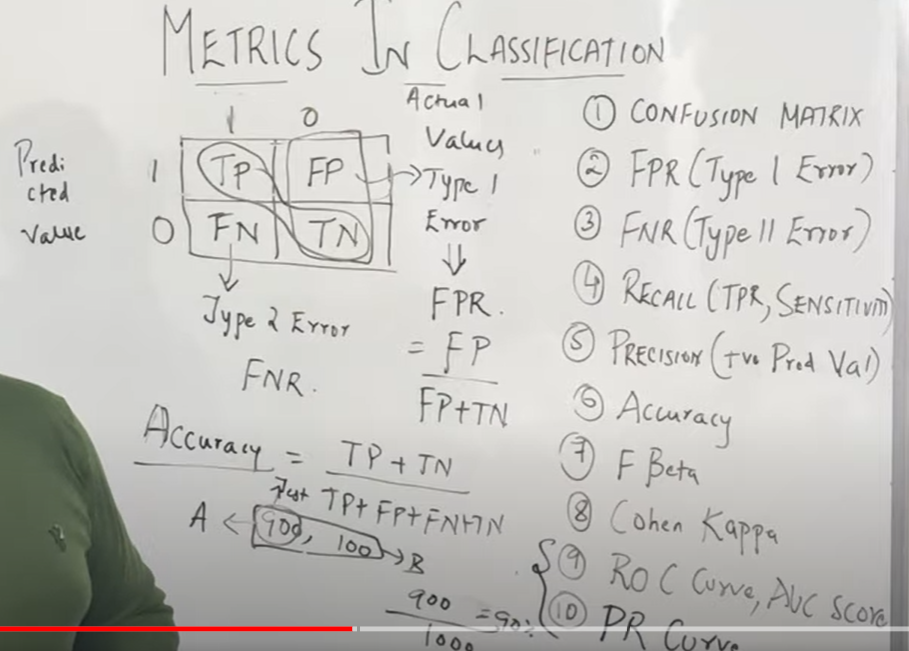
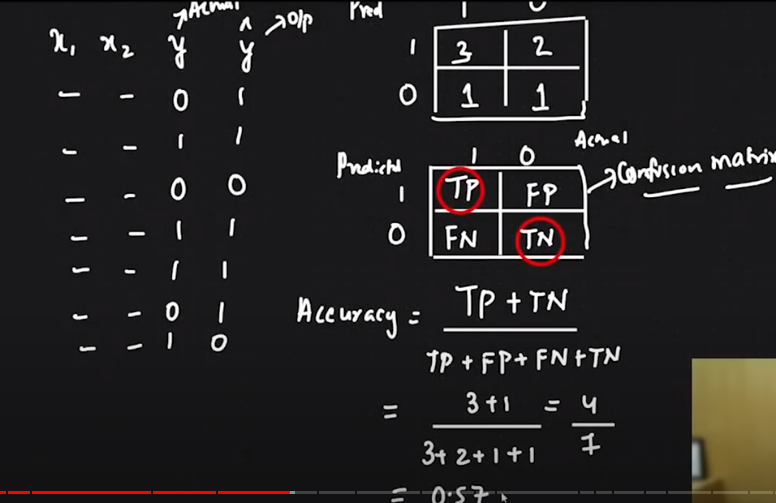
Recall
- Recall is also called True Postive Rate or Sensitivity
- Recall - How many records were correctly classiffied as TRUE. TP/(TP+FN) or the number of correctly classifed records as TRUE over the total number of actual TRUE records. 
- Precision: Out of the predicted Postive Results, how many were actually positive. TP/(TP+FP) also called +ve Prediction Value. The number of correctly classified records as TRUE over the total number of predicted TRUE records

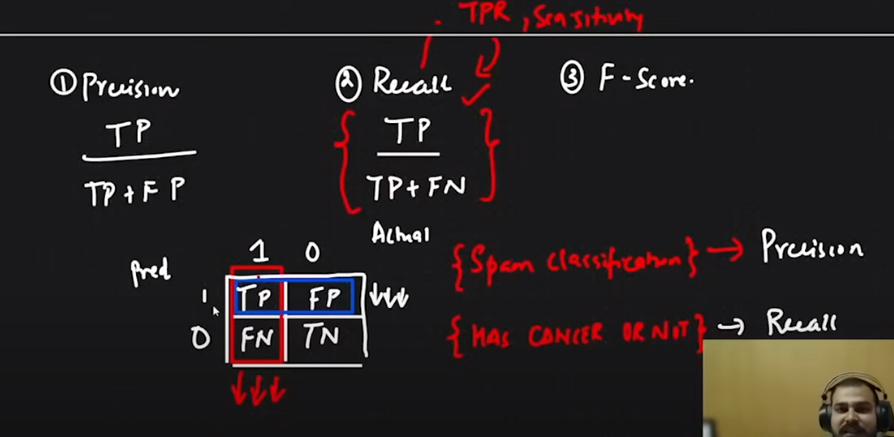
Examples:
- For Spam Detection Problem; we should try to reduce the likelihood of the user missing an email that has been wrongly classfied as Spam: Hence reducing False Positive or Type I Error; Hence the metric to focus on should be  Precision. 
- For Cancer prediciton, we should try to minimise the likelihood of a cancer patient missing a diagnosis; e.g. one who has cancer being classified as not having cancer, hence we should reduce False Negative or Type 2 Error. Hence focus on Recall.
- If it is important to reduce FP focus on precision and if it is important to reduce FN focus on Recall. 
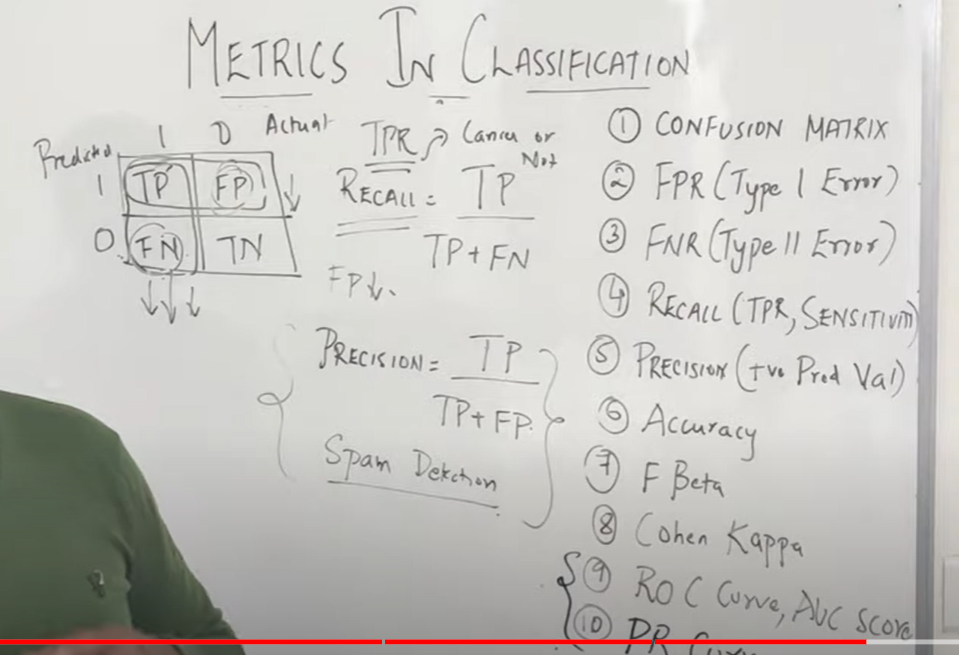

F Beta Score: used when both Recall and Precision scores are important
- When Beta = 1, this becomes F1 Score
- F1 Score = 2(Precision * Recall)/(Precision + Recall)  : The concept is called Harmonic Mean
- Beta = 1, is selected when both False Postive & False Negative are equally important
- Beta = 0.5, is selected when False Positive is more important or has more impact, the beta value is reduced to 0.5
- Beta = 2, is selected when False Negative has more impact

**Performance Metrics(ROC,AUC Curve) For Classification Problem**

- ROC - Graph plotted TPR on the Y axis vs FPR on the X axis
- Where True Positive Rate(TPR) = TP/(TP+FN) also called Recall
- Where False Positive Rate(FPR) - FP/(FP+TN)
- AUC - Area Under the Curve - The larger the area under the curve, the better the model. 
- The threshold selection depends the domain. 

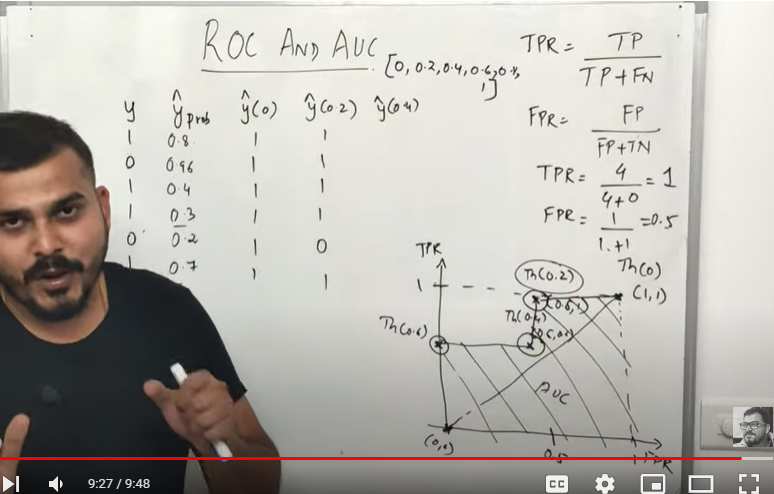

### **How To Find Optimal Threshold For Binary Classification**

**Selecting the right Threshold Values using ROC Curve**

In [123]:
#importing libs
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score

In [124]:
#creating train and test datasets

X,y = make_classification(n_samples=2000,n_classes=2,weights=[1,1],random_state=1)

In [125]:
X.shape

(2000, 20)

In [126]:
#train taest split
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.3,random_state=1)

**Random Forest Modelling**

In [127]:
#Applying random forest classifer
from sklearn.ensemble import RandomForestClassifier
rf_model = RandomForestClassifier()
rf_model.fit(X_train,y_train)
ytrain_pred  = rf_model.predict_proba(X_train)
print('RF train roc-auc: {}'.format(roc_auc_score(y_train, ytrain_pred[:,1])))
ytest_pred = rf_model.predict_proba(X_test)
print('RF test roc-auc: {}'.format(roc_auc_score(y_test, ytest_pred[:,1])))

RF train roc-auc: 1.0
RF test roc-auc: 0.9823055555555555


**Logistic Regression**

In [41]:
from sklearn.linear_model import LogisticRegression
log_classifier = LogisticRegression()
log_classifier.fit(X_train,y_train)
ytrain_pred = log_classifier.predict_proba(X_train)
print('Logistic train roc-auc: {}'.format(roc_auc_score(y_train, ytrain_pred[:,1])))
ytest_pred = log_classifier.predict_proba(X_test)
print('Logistic test roc-auc: {}'.format(roc_auc_score(y_test, ytest_pred[:,1])))

Logistic train roc-auc: 0.9863568922694498
Logistic test roc-auc: 0.9885777777777777


**AdaBoost Classifier**

In [42]:
from sklearn.ensemble import AdaBoostClassifier
ada_classifier = AdaBoostClassifier()
ada_classifier.fit(X_train,y_train)
ytrain_pred = ada_classifier.predict_proba(X_train)
print('Adaboost train roc-auc: {}'.format(roc_auc_score(y_train, ytrain_pred[:,1])))
ytest_pred = ada_classifier.predict_proba(X_test)
print('Adaboost test roc-auc: {}'.format(roc_auc_score(y_test, ytest_pred[:,1])))

Adaboost train roc-auc: 0.9975081174960356
Adaboost test roc-auc: 0.9826111111111111


**KNN Classifiier**

In [43]:
from sklearn.neighbors import KNeighborsClassifier
knn_classifier = KNeighborsClassifier()
knn_classifier.fit(X_train, y_train)
ytrain_pred = knn_classifier.predict_proba(X_train)
print('Adaboost train roc-auc: {}'.format(roc_auc_score(y_train, ytrain_pred[:,1])))
ytest_pred = knn_classifier.predict_proba(X_test)
print('Adaboost test roc-auc: {}'.format(roc_auc_score(y_test, ytest_pred[:,1])))

Adaboost train roc-auc: 0.981670071491109
Adaboost test roc-auc: 0.9426111111111111


**Selecting the best threshold for maximum accuracy**

In [44]:
pred = []
for model in [rf_model,log_classifier,ada_classifier,knn_classifier]:
    pred.append(pd.Series(model.predict_proba(X_test)[:,1]))
final_prediction = pd.concat(pred,axis=1).mean(axis=1)
print('Ensemble test roc-auc: {}'.format(roc_auc_score(y_test,final_prediction)))

Ensemble test roc-auc: 0.9853666666666666


In [45]:
pd.concat(pred,axis=1)

,0,1,2,3
0,0.99,0.991861,0.559186,1.0
1,0.01,0.000008,0.463282,0.0
2,0.98,0.966929,0.538202,0.8
3,0.92,0.761539,0.509875,0.8
4,0.61,0.779443,0.490344,0.4
...,...,...,...,...
595,0.00,0.024239,0.461121,0.0
596,0.04,0.000003,0.441377,0.0
597,1.00,0.984385,0.532403,1.0
598,0.03,0.001147,0.441720,0.2


In [46]:
final_prediction

0      0.885262
1      0.118323
2      0.821283
3      0.747853
4      0.569947
         ...   
595    0.121340
596    0.120345
597    0.879197
598    0.168217
599    0.837357
Length: 600, dtype: float64

In [47]:
#Calculating the ROC Curve
fpr,tpr,thresholds = roc_curve(y_test,final_prediction)
thresholds

array([       inf, 0.9134413 , 0.90924686, 0.90827475, 0.80287052,
       0.80162833, 0.79452418, 0.7930558 , 0.77659273, 0.77321156,
       0.76303202, 0.76037124, 0.71921544, 0.71887362, 0.71475181,
       0.71143711, 0.67442282, 0.67243537, 0.62738185, 0.62175354,
       0.59649047, 0.59614346, 0.58558969, 0.57986186, 0.55088469,
       0.54219563, 0.53865858, 0.47866892, 0.45919266, 0.42591982,
       0.4196034 , 0.41286956, 0.40379719, 0.36807343, 0.36086612,
       0.24654122, 0.24640421, 0.2296341 , 0.22896893, 0.21233682,
       0.20848417, 0.12303857, 0.1228351 , 0.10632697])

In [50]:
from sklearn.metrics import accuracy_score
accuracy_ls=[]
for thres in thresholds:
    y_pred = np.where(final_prediction>thres,1,0)
    accuracy_ls.append(accuracy_score(y_test,y_pred,normalize=True))

accuracy_ls = pd.concat([pd.Series(thresholds),pd.Series(accuracy_ls)],axis=1)

accuracy_ls.columns=['thresholds','accuracy']
accuracy_ls.sort_values(by='accuracy',ascending=False,inplace=True)
accuracy_ls.head()

,thresholds,accuracy
28,0.459193,0.960000
25,0.542196,0.960000
24,0.550885,0.960000
27,0.478669,0.958333
26,0.538659,0.958333


In [51]:
#plotting the roc curve
def plot_roc_curve(fpr,tpr):
    plt.plot(fpr, tpr, color='orange', label='ROC')
    plt.plot([0, 1], [0, 1], color='darkblue', linestyle='--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend()
    plt.show()
    

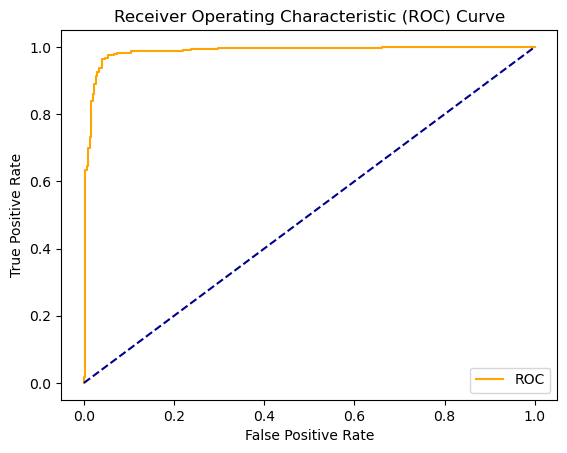

In [52]:
plot_roc_curve(fpr,tpr)

**Performance Metrics On MultiClass Classification Problems**

Multiclass problems do not have a confusion matrix similar to a binary classification model. 

In [1]:
from sklearn import metrics
C = "Cat"
D = "Dog"
F = "Fox"

- The precision for Cat class is the number of correctly predicted Cat out of all predicted Cat
- The recall for Cat is the number of correctly predicted Cat photos of of the total number of actual Cat

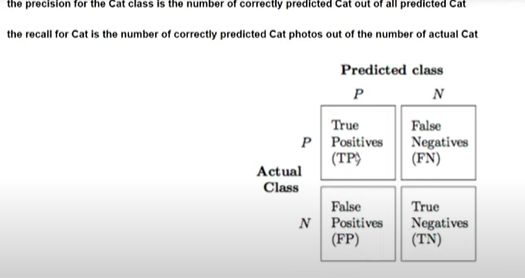

In [2]:
#True Values
y_true = [C,C,C,C,C,C,F,F,F,F,F,F,F,F,F,F,D,D,D,D,D,D,D,D,D]

#predicted values
y_pred = [C,C,C,C,D,F,C,C,C,C,C,C,D,D,F,F,C,C,C,D,D,D,D,D,D]

#printing the confusion matrix
print(metrics.confusion_matrix(y_true,y_pred))

#Print the precision and recall
print(metrics.classification_report(y_true,y_pred,digits= 3))

[[4 1 1]
 [3 6 0]
 [6 2 2]]
              precision    recall  f1-score   support

         Cat      0.308     0.667     0.421         6
         Dog      0.667     0.667     0.667         9
         Fox      0.667     0.200     0.308        10

    accuracy                          0.480        25
   macro avg      0.547     0.511     0.465        25
weighted avg      0.581     0.480     0.464        25



## **Decision Tree**

- Entropy is the measure of randomness - measures the impurity of the node. 
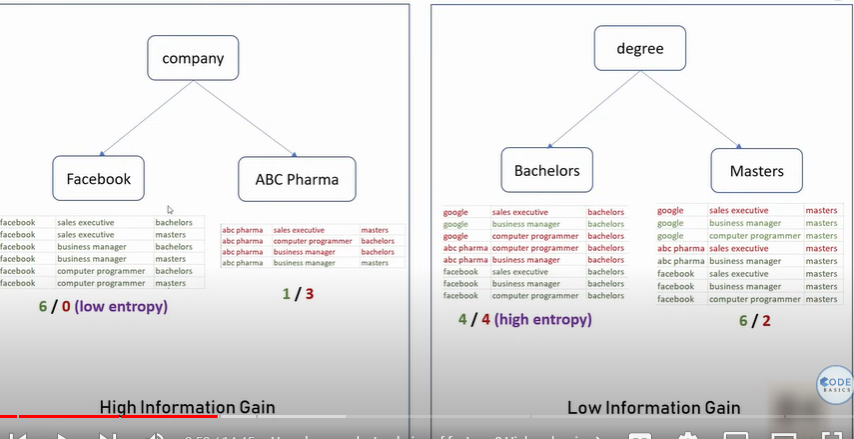


Entropy gives measure of impurity in a node. In a decision tree building process, two important decisions are to be made — what is the best split(s) and which is the best variable to split a node.

Entropy helps to measure the purity of the split. Ranges from 0 to 1. 1 being the most impure split, 0 is at the leaf node a pure subsplit at the end. 

Information Gain - comparing different splits: Low entropy leads to high information gain. 

Gini Impurity; Calculating the impurity of decision split. This is computationaly faster compared to Entropy. 
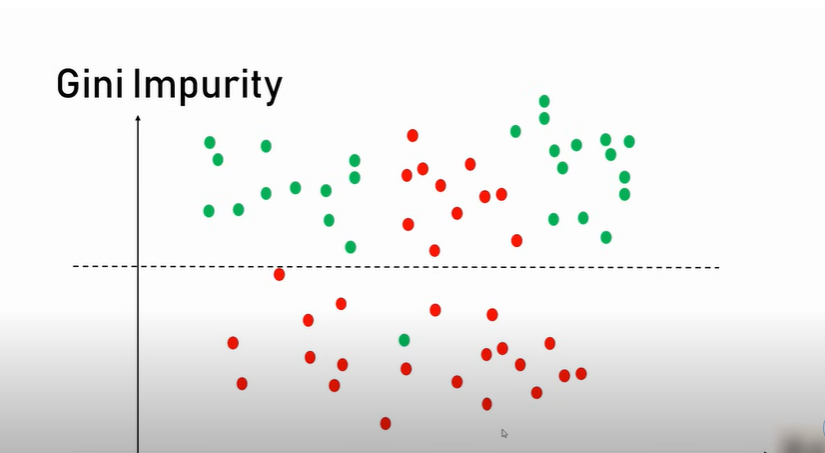


If the feature is a numerical variable, the decision tree algo will sort all the values first in an ascending order > Then consider some threshold value. Takes a lot of time training on numerical data, as time complexity increases.

In [3]:
import pandas as pd
df = pd.read_csv("salaries.csv")
df.head()

,company,job,degree,salary_more_then_100k
0,google,sales executive,bachelors,0
1,google,sales executive,masters,0
2,google,business manager,bachelors,1
3,google,business manager,masters,1
4,google,computer programmer,bachelors,0


In [4]:
inputs = df.drop('salary_more_then_100k',axis='columns')
target = df['salary_more_then_100k']

In [5]:
inputs.head()

,company,job,degree
0,google,sales executive,bachelors
1,google,sales executive,masters
2,google,business manager,bachelors
3,google,business manager,masters
4,google,computer programmer,bachelors


In [6]:
from sklearn.preprocessing import LabelEncoder
le_company = LabelEncoder()
le_job = LabelEncoder()
le_degree = LabelEncoder()

In [7]:
inputs['company_n'] = le_company.fit_transform(inputs['company'])
inputs['job_n'] = le_job.fit_transform(inputs['job'])
inputs['degree_n'] = le_degree.fit_transform(inputs['degree'])

In [8]:
inputs.head()

,company,job,degree,company_n,job_n,degree_n
0,google,sales executive,bachelors,2,2,0
1,google,sales executive,masters,2,2,1
2,google,business manager,bachelors,2,0,0
3,google,business manager,masters,2,0,1
4,google,computer programmer,bachelors,2,1,0


In [9]:
inputs_n = inputs.drop(['company','job','degree'],axis='columns')

In [10]:
inputs_n.head()

,company_n,job_n,degree_n
0,2,2,0
1,2,2,1
2,2,0,0
3,2,0,1
4,2,1,0


In [11]:
from sklearn import tree
model = tree.DecisionTreeClassifier()

In [12]:
model.fit(inputs_n, target)

DecisionTreeClassifier()

In [13]:
model.score(inputs_n,target)

1.0

In [14]:
#Is salary of Google, Computer Engineer, Bachelors degree > 100 k ?
model.predict([[2,1,0]])

c:\Users\ADMIN\Documents\Data Analytics\Machine Learning\Machine Learning Concepts\venv\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


array([0])

In [15]:
#Is salary of Google, Computer Engineer, Masters degree > 100 k ?
model.predict([[2,1,1]])

c:\Users\ADMIN\Documents\Data Analytics\Machine Learning\Machine Learning Concepts\venv\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


array([1])

## **Support Vector Machine(SVM)**

Support vector machine (SVM) is a popular classification algorithm. This tutorial covers some theory first and then goes over python coding to solve iris flower classification problem using svm and sklearn library. We also cover different parameters such as gamma, regularization and how to fine tune svm classifier using these parameters. 

Basically the way support vector machine works is it draws a hyper plane in n dimension space such that it maximizes  the margin between classification groups.

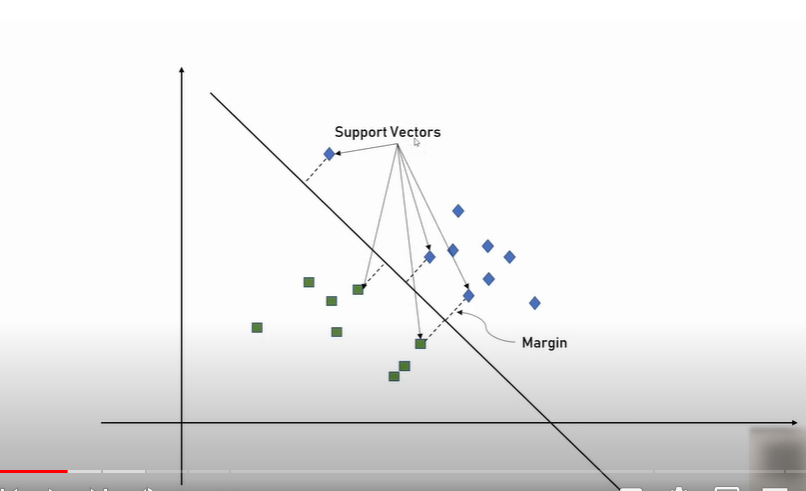
- The nearby data points are called suport vectors

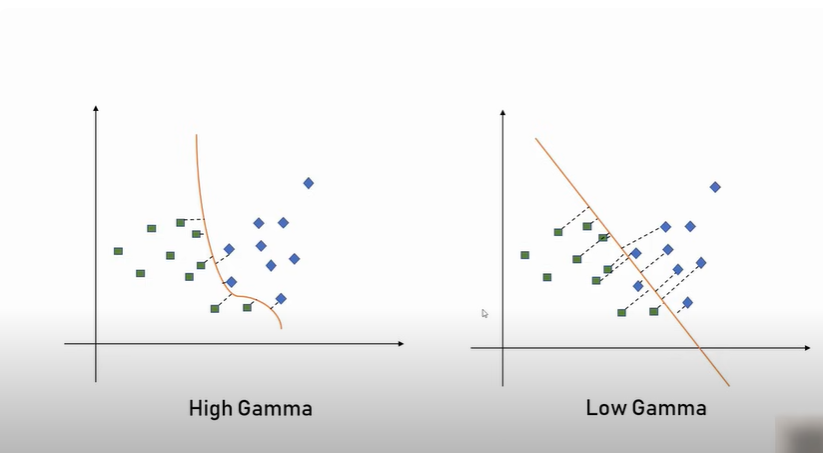

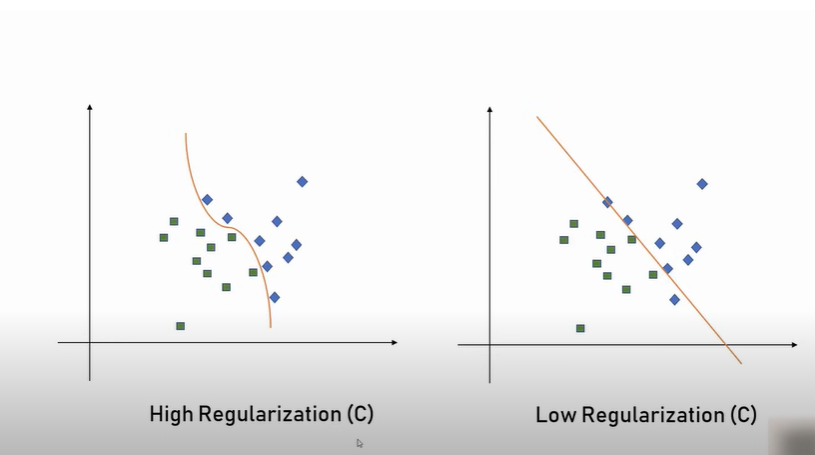




In [17]:
import pandas as pd
from sklearn.datasets import load_iris
iris = load_iris()

In [20]:
iris.target_names

array(['setosa', 'versicolor', 'virginica'], dtype='<U10')

In [21]:
iris.feature_names

['sepal length (cm)',
 'sepal width (cm)',
 'petal length (cm)',
 'petal width (cm)']

In [18]:
df = pd.DataFrame(iris.data,columns=iris.feature_names)
df.head()

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm)
0,5.1,3.5,1.4,0.2
1,4.9,3.0,1.4,0.2
2,4.7,3.2,1.3,0.2
3,4.6,3.1,1.5,0.2
4,5.0,3.6,1.4,0.2


In [19]:
df['target'] = iris.target
df.head()

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm),target
0,5.1,3.5,1.4,0.2,0
1,4.9,3.0,1.4,0.2,0
2,4.7,3.2,1.3,0.2,0
3,4.6,3.1,1.5,0.2,0
4,5.0,3.6,1.4,0.2,0


In [22]:
df.target.value_counts()

target
0    50
1    50
2    50
Name: count, dtype: int64

In [23]:
df['flower_name'] =df.target.apply(lambda x: iris.target_names[x])
df.head()

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm),target,flower_name
0,5.1,3.5,1.4,0.2,0,setosa
1,4.9,3.0,1.4,0.2,0,setosa
2,4.7,3.2,1.3,0.2,0,setosa
3,4.6,3.1,1.5,0.2,0,setosa
4,5.0,3.6,1.4,0.2,0,setosa


In [24]:
df0 = df[:50]
df1 = df[50:100]
df2 = df[100:]

In [25]:
import matplotlib.pyplot as plt
%matplotlib inline

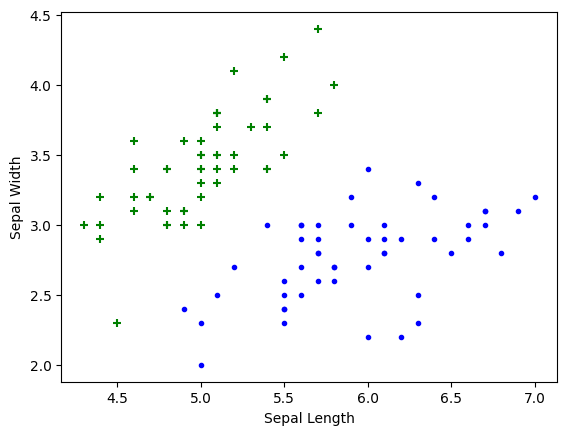

In [26]:
plt.xlabel('Sepal Length')
plt.ylabel('Sepal Width')
plt.scatter(df0['sepal length (cm)'], df0['sepal width (cm)'],color="green",marker='+')
plt.scatter(df1['sepal length (cm)'], df1['sepal width (cm)'],color="blue",marker='.')

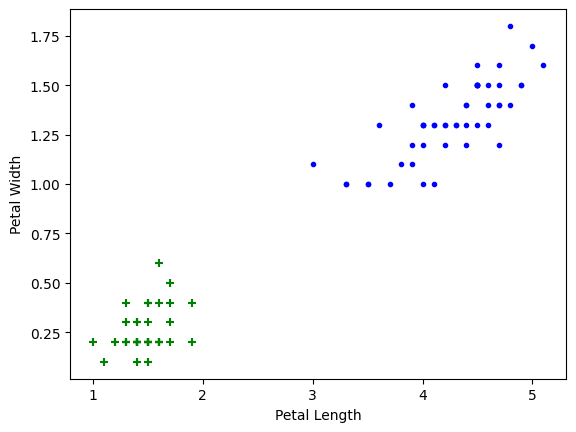

In [27]:
plt.xlabel('Petal Length')
plt.ylabel('Petal Width')
plt.scatter(df0['petal length (cm)'], df0['petal width (cm)'],color="green",marker='+')
plt.scatter(df1['petal length (cm)'], df1['petal width (cm)'],color="blue",marker='.')

**Using SVM**

In [28]:
from sklearn.model_selection import train_test_split

In [29]:
X = df.drop(['target','flower_name'], axis='columns')
y = df.target

In [30]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2,random_state=0)

In [31]:
X_train.shape, X_test.shape

((120, 4), (30, 4))

In [32]:
from sklearn.svm import SVC
model = SVC()

In [33]:
model.fit(X_train, y_train)

SVC()

In [34]:
model.score(X_test, y_test)

1.0

In [35]:
model.predict([[4.8,3.0,1.5,0.3]])

c:\Users\ADMIN\Documents\Data Analytics\Machine Learning\Machine Learning Concepts\venv\lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but SVC was fitted with feature names
  warnings.warn(


array([0])

**Tuning Parameters: Regularization**

In [36]:
model_C = SVC(C=1)
model_C.fit(X_train, y_train)
model_C.score(X_test, y_test)

1.0

In [37]:
model_C = SVC(C=10)
model_C.fit(X_train, y_train)
model_C.score(X_test, y_test)

1.0

**Gamma**

In [38]:
model_g = SVC(gamma=10)
model_g.fit(X_train, y_train)
model_g.score(X_test, y_test)

0.9666666666666667

**Kernel**

In [39]:
model_linear_kernal = SVC(kernel='linear')
model_linear_kernal.fit(X_train, y_train)

SVC(kernel='linear')

In [40]:
model_linear_kernal.score(X_test, y_test)

1.0

## **K Nearest Neighbor classification**

- In pattern recognition, the k-nearest neighbors algorithm (k-NN) is a non-parametric method used for classification and regression. k-NN is a type of instance-based learning, or lazy learning, where the function is only approximated locally and all computation is deferred until classification.
- In k-NN classification, the output is a class membership. An object is classified by a plurality vote of its neighbors, with the object being assigned to the class most common among its k nearest neighbors (k is a positive integer, typically small). If k = 1, then the object is simply assigned to the class of that single nearest neighbor.
- In k-NN regression, the output is the property value for the object. This value is the average of the values of k nearest neighbors.
k-NN is a type of instance-based learning, or lazy learning, where the function is only approximated locally and all computation is deferred until classification. The k-NN algorithm is among the simplest of all machine learning algorithms.

- Both for classification and regression, a useful technique can be used to assign weight to the contributions of the neighbors, so that the nearer neighbors contribute more to the average than the more distant ones. For example, a common weighting scheme consists in giving each neighbor a weight of 1/d, where d is the distance to the neighbor.

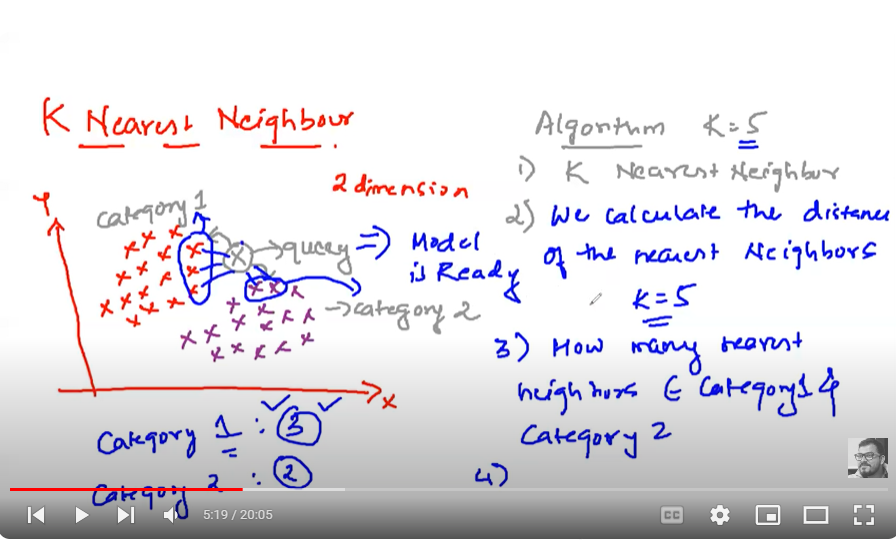

There are mainly two types of distance used to calculate the nearest neighbour
- Euclidean Distance
- Manhattan Distance

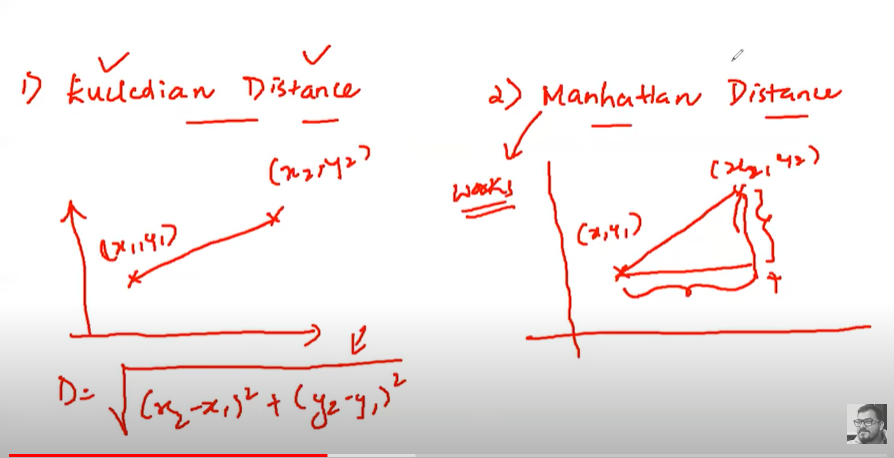

K-NN can be impacted by an imbalanced dataset which can make the model biased. 

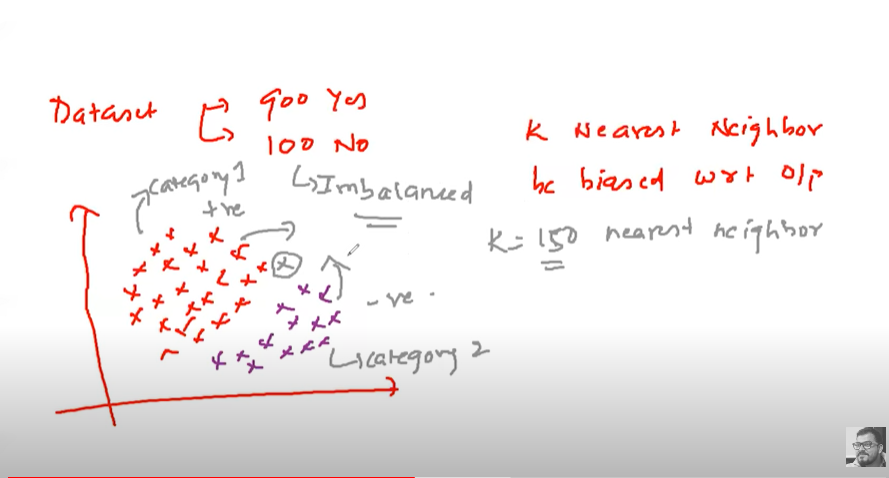

K-NN can also be impacted by outliers. 

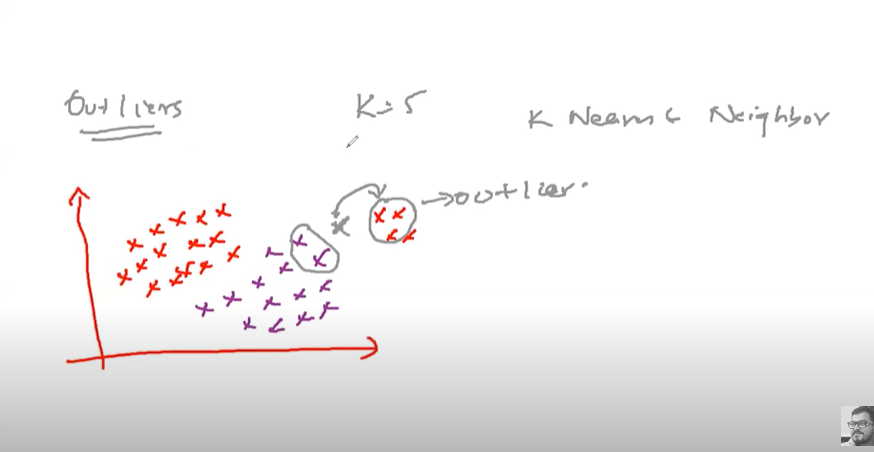






**K-NN Practical Implementation**

We'll try to use KNN to create a model that directly predicts a class of new data point based off the features. 

In [3]:
#importingh the libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

**Loading the Data**

In [6]:
#set index_col = 0 to use the first column as the index
df = pd.read_csv("Classfied Data.csv",index_col = 0)
df.head()

,WTT,PTI,EQW,SBI,LQE,QWG,FDJ,PJF,HQE,NXJ,TARGET CLASS
0,0.913917,1.162073,0.567946,0.755464,0.780862,0.352608,0.759697,0.643798,0.879422,1.231409,1
1,0.635632,1.003722,0.535342,0.825645,0.924109,0.648450,0.675334,1.013546,0.621552,1.492702,0
2,0.721360,1.201493,0.921990,0.855595,1.526629,0.720781,1.626351,1.154483,0.957877,1.285597,0
3,1.234204,1.386726,0.653046,0.825624,1.142504,0.875128,1.409708,1.380003,1.522692,1.153093,1
4,1.279491,0.949750,0.627280,0.668976,1.232537,0.703727,1.115596,0.646691,1.463812,1.419167,1


**Standardize the Variables**

Because the KNN classifier predicts the class of a given test observation by identifying the observations that are nearest to it, the scale of the variables matters. Any variables that are on a large scale will have a much larger effect on the distance between the observations, and hence on the KNN classifier, than variables that are on a small scale.

In [7]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

In [8]:
#fitting
scaler.fit(df.drop('TARGET CLASS',axis=1))

StandardScaler()

In [9]:
#transforming
scaled_features = scaler.transform(df.drop('TARGET CLASS',axis=1))

In [10]:
#getting the independent features
df_feat = pd.DataFrame(scaled_features,columns = df.columns[:-1])
df_feat.head()

,WTT,PTI,EQW,SBI,LQE,QWG,FDJ,PJF,HQE,NXJ
0,-0.123542,0.185907,-0.913431,0.319629,-1.033637,-2.308375,-0.798951,-1.482368,-0.949719,-0.643314
1,-1.084836,-0.430348,-1.025313,0.625388,-0.444847,-1.152706,-1.129797,-0.202240,-1.828051,0.636759
2,-0.788702,0.339318,0.301511,0.755873,2.031693,-0.870156,2.599818,0.285707,-0.682494,-0.377850
3,0.982841,1.060193,-0.621399,0.625299,0.452820,-0.267220,1.750208,1.066491,1.241325,-1.026987
4,1.139275,-0.640392,-0.709819,-0.057175,0.822886,-0.936773,0.596782,-1.472352,1.040772,0.276510


**Train Test Split**

In [11]:
from sklearn.model_selection import train_test_split

X_train,X_test,y_train,y_test = train_test_split(scaled_features,df['TARGET CLASS'],
                                                test_size=0.30)

In [12]:
X_train.shape,X_test.shape

((700, 10), (300, 10))

In [13]:
y_train.unique()

array([0, 1], dtype=int64)

**Using KNN**

The model should be able to predict the target class. We'll start with k=1

In [15]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors = 1)

In [16]:
#fitting
knn.fit(X_train,y_train)

KNeighborsClassifier(n_neighbors=1)

In [17]:
#getting the predictions
pred = knn.predict(X_test)

**Predictions & Evaluations**

In [18]:
from sklearn.metrics import classification_report,confusion_matrix
print(confusion_matrix(y_test,pred))

[[134  15]
 [  9 142]]


In [19]:
print(classification_report(y_test,pred))

              precision    recall  f1-score   support

           0       0.94      0.90      0.92       149
           1       0.90      0.94      0.92       151

    accuracy                           0.92       300
   macro avg       0.92      0.92      0.92       300
weighted avg       0.92      0.92      0.92       300



**Choosing the right K Value**

In [21]:
error_rate = []

#iterating through various k values
for i in range(1,40):
    knn = KNeighborsClassifier(n_neighbors = i)
    knn.fit(X_train,y_train)
    pred_i = knn.predict(X_test)
    error_rate.append(np.mean(pred_i != y_test))

Text(0, 0.5, 'Error Rate')

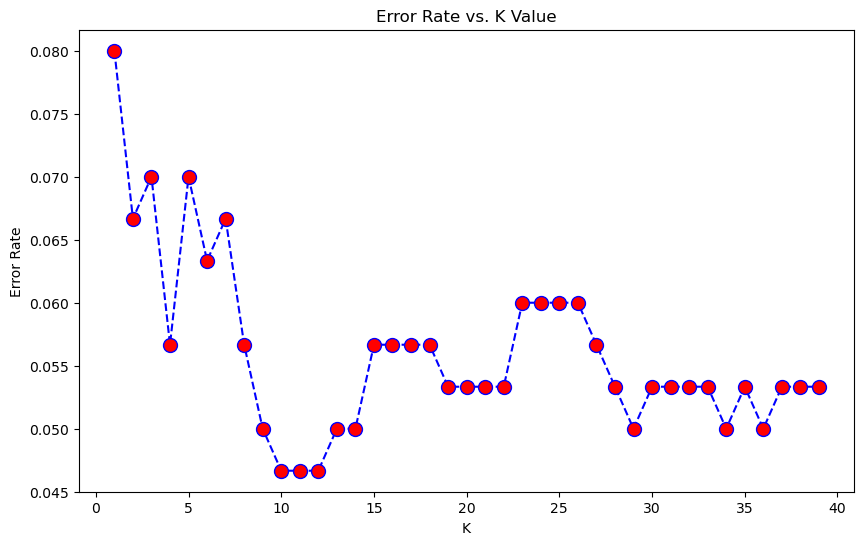

In [22]:
#plotting the graph to visualise the error rate
plt.figure(figsize=(10,6))
plt.plot(range(1,40),error_rate,color='blue', linestyle='dashed', marker='o',
         markerfacecolor='red', markersize=10)
plt.title('Error Rate vs. K Value')
plt.xlabel('K')
plt.ylabel('Error Rate')

Here we can see after K>28, the error rate hovers between 0.05 to 0.055, the model is then retrained with K=28

In [23]:
# FIRST A QUICK COMPARISON TO OUR ORIGINAL K=1
knn = KNeighborsClassifier(n_neighbors=1)

knn.fit(X_train,y_train)
pred = knn.predict(X_test)

print('WITH K=1')
print('\n')
print(confusion_matrix(y_test,pred))
print('\n')
print(classification_report(y_test,pred))

WITH K=1


[[134  15]
 [  9 142]]


              precision    recall  f1-score   support

           0       0.94      0.90      0.92       149
           1       0.90      0.94      0.92       151

    accuracy                           0.92       300
   macro avg       0.92      0.92      0.92       300
weighted avg       0.92      0.92      0.92       300



In [24]:
# NOW WITH K=28
knn = KNeighborsClassifier(n_neighbors=28)

knn.fit(X_train,y_train)
pred = knn.predict(X_test)

print('WITH K=23')
print('\n')
print(confusion_matrix(y_test,pred))
print('\n')
print(classification_report(y_test,pred))

WITH K=23


[[138  11]
 [  5 146]]


              precision    recall  f1-score   support

           0       0.97      0.93      0.95       149
           1       0.93      0.97      0.95       151

    accuracy                           0.95       300
   macro avg       0.95      0.95      0.95       300
weighted avg       0.95      0.95      0.95       300



From above we can see with K=28, the model provides a better score

**Practical Implementation 2:**

In [143]:
import pandas as pd
from sklearn.datasets import load_iris

import matplotlib.pyplot as plt
%matplotlib inline
iris = load_iris()

In [140]:
df = pd.DataFrame(iris.data,columns=iris.feature_names)
df.head()

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm)
0,5.1,3.5,1.4,0.2
1,4.9,3.0,1.4,0.2
2,4.7,3.2,1.3,0.2
3,4.6,3.1,1.5,0.2
4,5.0,3.6,1.4,0.2


In [141]:
df['target'] = iris.target
df.head()

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm),target
0,5.1,3.5,1.4,0.2,0
1,4.9,3.0,1.4,0.2,0
2,4.7,3.2,1.3,0.2,0
3,4.6,3.1,1.5,0.2,0
4,5.0,3.6,1.4,0.2,0


In [142]:
df['flower_name'] =df.target.apply(lambda x: iris.target_names[x])
df.head()

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm),target,flower_name
0,5.1,3.5,1.4,0.2,0,setosa
1,4.9,3.0,1.4,0.2,0,setosa
2,4.7,3.2,1.3,0.2,0,setosa
3,4.6,3.1,1.5,0.2,0,setosa
4,5.0,3.6,1.4,0.2,0,setosa


In [145]:
df0 = df[:50]
df1 = df[50:100]
df2 = df[100:]

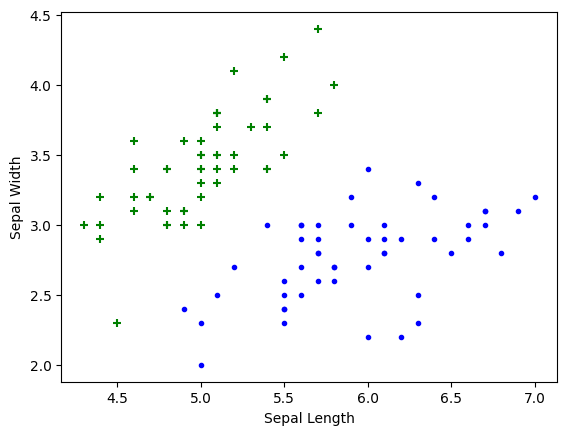

In [146]:
plt.xlabel('Sepal Length')
plt.ylabel('Sepal Width')
plt.scatter(df0['sepal length (cm)'], df0['sepal width (cm)'],color="green",marker='+')
plt.scatter(df1['sepal length (cm)'], df1['sepal width (cm)'],color="blue",marker='.')

In [147]:
from sklearn.model_selection import train_test_split
X = df.drop(['target','flower_name'], axis='columns')
y = df.target

In [148]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)

In [149]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors=10)

In [150]:
knn.fit(X_train, y_train)

KNeighborsClassifier(n_neighbors=10)

In [151]:
knn.score(X_test, y_test)

0.9666666666666667

In [152]:
knn.predict([[4.8,3.0,1.5,0.3]])

array([0])

In [153]:
from sklearn.metrics import confusion_matrix
y_pred = knn.predict(X_test)
cm = confusion_matrix(y_test, y_pred)
cm

array([[11,  0,  0],
       [ 0, 12,  1],
       [ 0,  0,  6]])

Text(58.222222222222214, 0.5, 'Truth')

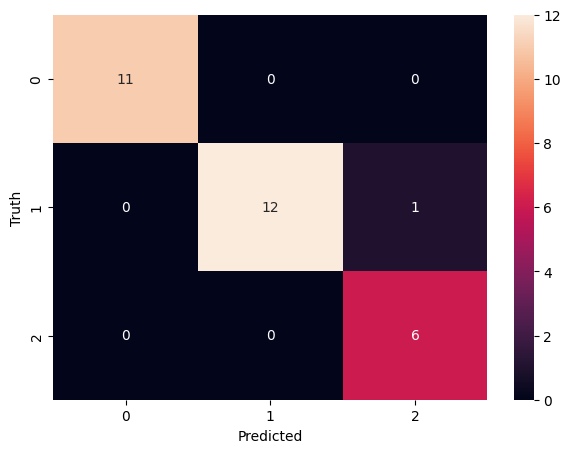

In [154]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sn
plt.figure(figsize=(7,5))
sn.heatmap(cm, annot=True)
plt.xlabel('Predicted')
plt.ylabel('Truth')

In [155]:
from sklearn.metrics import classification_report

print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00        11
           1       1.00      0.92      0.96        13
           2       0.86      1.00      0.92         6

    accuracy                           0.97        30
   macro avg       0.95      0.97      0.96        30
weighted avg       0.97      0.97      0.97        30



## **Ensemble Learning**

### What is Bagging (Bootstrap Aggregation)?**



- Ensemble simple means combining multiple models.
- We mainly have 2 ensemble techniques:
    - Bagging - also called Bootstrap aggregation. e.g. Random Forest
    - Boosting - e.g. AdaBoost, Gradient Boosting, XgBoost
-  Bootstrap aggregating, also called bagging, is a machine learning ensemble meta-algorithm designed to improve the stability and accuracy of machine learning algorithms used in statistical classification and regression. 
- In Bagging, a sample of the dataset is provided to each of the models. uses a row sampling with replacement technique

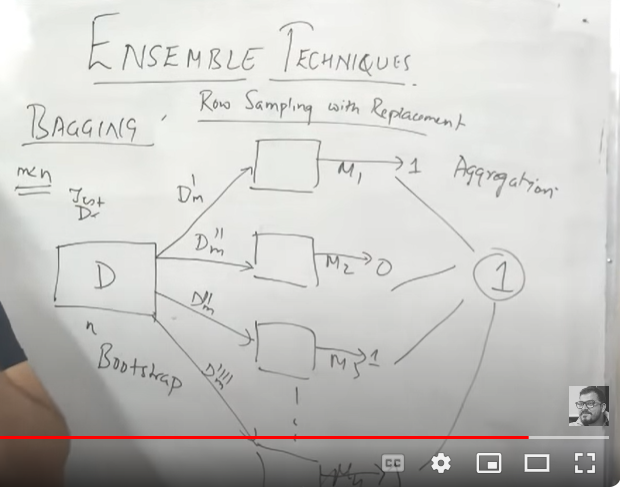


 - Weak Learners: Are trained on a subset of the dataset.

## **Random Forest Classifier and Regressor**
- Random Forest uses both row and feature sampling.
- The base learner is a decision tree
- If the Decsion Tree is created to it's depth it'll have low bias(low training error) and high variance. This causes overfitting. 
- uses the majority vote to combine the results of each decsison tree which then reduces the high variance. 
- For the regressor, it can either get the average of the output or the median depending on the distribution of the output.
- The hyperparameter tuned is usually the number of decsion trees.

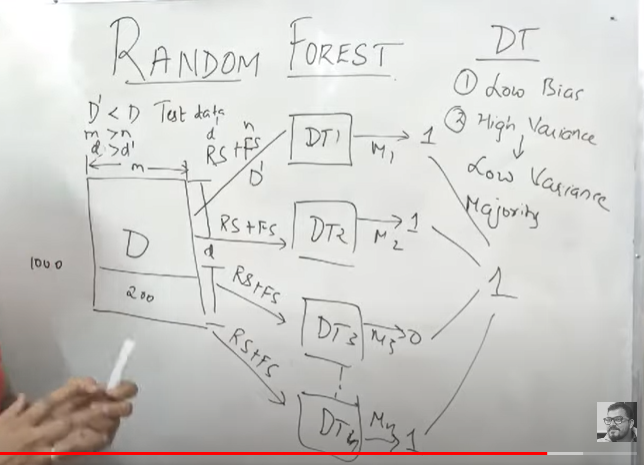
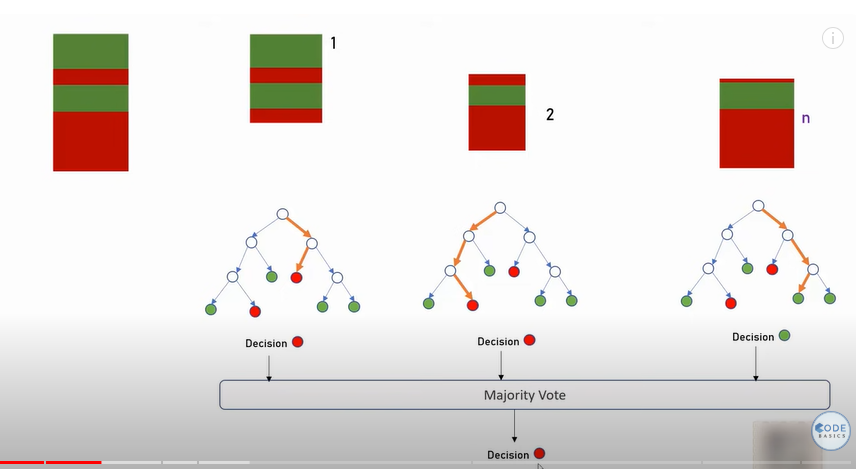


**Practical Implementation**

We will use pima indian diabetes dataset to predict if a person has a diabetes or not based on certain features such as blood pressure, skin thickness, age etc. We will train a standalone model first and then use bagging ensemble technique to check how it can improve the performance of the model

In [176]:
import pandas as pd

df = pd.read_csv("diabetes.csv")
df.head()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1


In [177]:
df.isnull().sum()

Pregnancies                 0
Glucose                     0
BloodPressure               0
SkinThickness               0
Insulin                     0
BMI                         0
DiabetesPedigreeFunction    0
Age                         0
Outcome                     0
dtype: int64

In [178]:
df.describe()

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
count,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000,768.000000
mean,3.845052,120.894531,69.105469,20.536458,79.799479,31.992578,0.471876,33.240885,0.348958
std,3.369578,31.972618,19.355807,15.952218,115.244002,7.884160,0.331329,11.760232,0.476951
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.078000,21.000000,0.000000
25%,1.000000,99.000000,62.000000,0.000000,0.000000,27.300000,0.243750,24.000000,0.000000
50%,3.000000,117.000000,72.000000,23.000000,30.500000,32.000000,0.372500,29.000000,0.000000
75%,6.000000,140.250000,80.000000,32.000000,127.250000,36.600000,0.626250,41.000000,1.000000
max,17.000000,199.000000,122.000000,99.000000,846.000000,67.100000,2.420000,81.000000,1.000000


In [179]:
df.Outcome.value_counts()

Outcome
0    500
1    268
Name: count, dtype: int64

There is slight imbalance in our dataset but since it is not major we will not worry about it!

Train test split

In [180]:
X = df.drop("Outcome",axis="columns")
y = df.Outcome

In [181]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_scaled[:3]

array([[ 0.63994726,  0.84832379,  0.14964075,  0.90726993, -0.69289057,
         0.20401277,  0.46849198,  1.4259954 ],
       [-0.84488505, -1.12339636, -0.16054575,  0.53090156, -0.69289057,
        -0.68442195, -0.36506078, -0.19067191],
       [ 1.23388019,  1.94372388, -0.26394125, -1.28821221, -0.69289057,
        -1.10325546,  0.60439732, -0.10558415]])

In [182]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, stratify=y, random_state=10)

In [183]:
X_train.shape

(576, 8)

In [184]:
X_test.shape

(192, 8)

In [185]:
y_train.value_counts()

Outcome
0    375
1    201
Name: count, dtype: int64

**Training Using Decsion Tree**

In [186]:
from sklearn.model_selection import cross_val_score
from sklearn.tree import DecisionTreeClassifier

scores = cross_val_score(DecisionTreeClassifier(), X, y, cv=5)
scores

array([0.67532468, 0.66233766, 0.7012987 , 0.79084967, 0.73202614])

In [187]:
scores.mean()

np.float64(0.7123673711909005)

**Training Using Bagging**

In [189]:
from sklearn.ensemble import BaggingClassifier
from sklearn.tree import DecisionTreeClassifier

bag_model = BaggingClassifier(
    estimator=DecisionTreeClassifier(), 
    n_estimators=100, 
    max_samples=0.8, 
    oob_score=True,
    random_state=0
)
bag_model.fit(X_train, y_train)
bag_model.oob_score_

0.7534722222222222

In [190]:
bag_model.score(X_test, y_test)

0.7760416666666666

In [191]:
bag_model = BaggingClassifier(
    estimator=DecisionTreeClassifier(), 
    n_estimators=100, 
    max_samples=0.8, 
    oob_score=True,
    random_state=0
)
scores = cross_val_score(bag_model, X, y, cv=5)
scores

array([0.75324675, 0.72727273, 0.74675325, 0.82352941, 0.73856209])

In [192]:
scores.mean()

np.float64(0.7578728461081402)

We can see some improvement in test score with bagging classifier as compared to a standalone classifier

**Train using Random Forest**

In [193]:
from sklearn.ensemble import RandomForestClassifier

scores = cross_val_score(RandomForestClassifier(n_estimators=50), X, y, cv=5)
scores.mean()

np.float64(0.7670316611493082)

**Hyperparameter Optimization for Xgboost**

In machine learning, hyperparameter optimization or tuning is the problem of choosing a set of optimal hyperparameters for a learning algorithm. A hyperparameter is a parameter whose value is used to control the learning process. By contrast, the values of other parameters (typically node weights) are learned.


**Hyperparameter Optimization For Xgboost using RandomizedSearchCV**

In [1]:
import pandas as pd
df = pd.read_csv("Churn_Modelling.csv")
df.head()

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
0,1,15634602,Hargrave,619,France,Female,42,2,0.00,1,1,1,101348.88,1
1,2,15647311,Hill,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0
2,3,15619304,Onio,502,France,Female,42,8,159660.80,3,1,0,113931.57,1
3,4,15701354,Boni,699,France,Female,39,1,0.00,2,0,0,93826.63,0
4,5,15737888,Mitchell,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0


In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 14 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   RowNumber        10000 non-null  int64  
 1   CustomerId       10000 non-null  int64  
 2   Surname          10000 non-null  object 
 3   CreditScore      10000 non-null  int64  
 4   Geography        10000 non-null  object 
 5   Gender           10000 non-null  object 
 6   Age              10000 non-null  int64  
 7   Tenure           10000 non-null  int64  
 8   Balance          10000 non-null  float64
 9   NumOfProducts    10000 non-null  int64  
 10  HasCrCard        10000 non-null  int64  
 11  IsActiveMember   10000 non-null  int64  
 12  EstimatedSalary  10000 non-null  float64
 13  Exited           10000 non-null  int64  
dtypes: float64(2), int64(9), object(3)
memory usage: 1.1+ MB


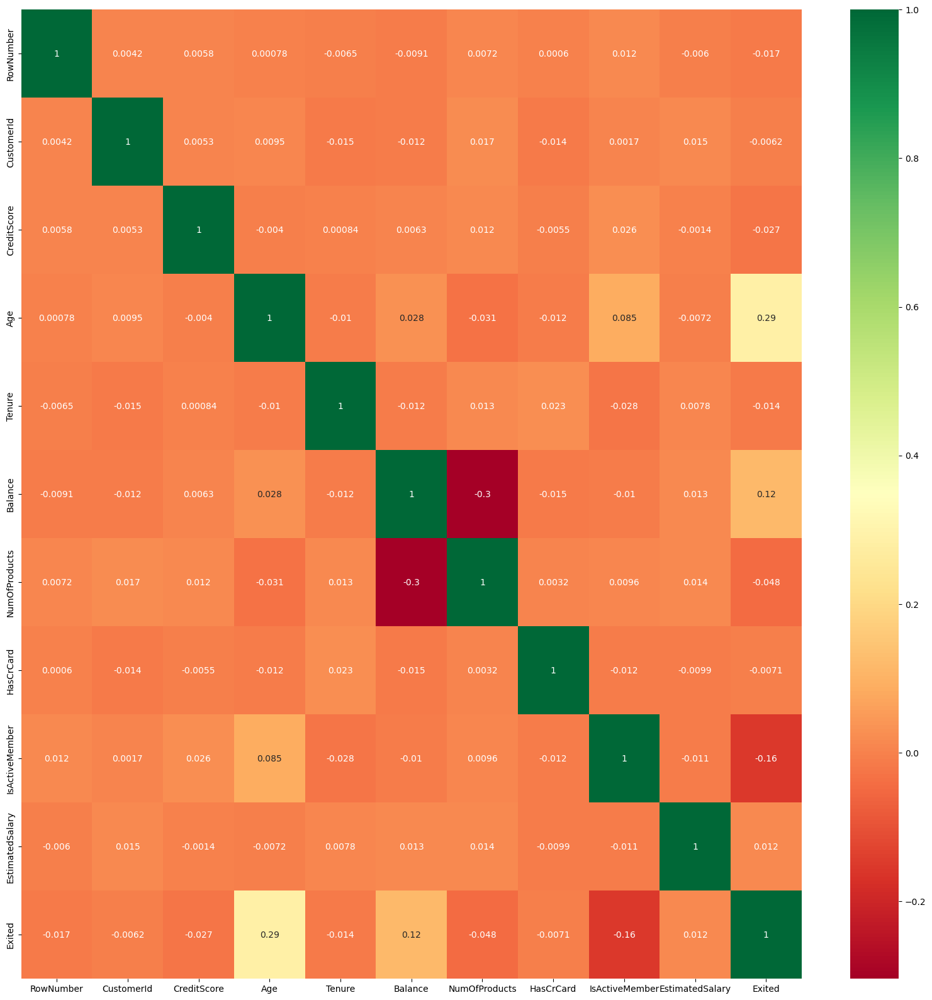

In [13]:
#Checking correlation
import seaborn as sns
import matplotlib.pyplot as plt

#getting correlation features in the dataset
corrmat = df.corr(numeric_only = True)
top_corr_features = corrmat.index
plt.figure(figsize=(20,20))
#plotting heatmap
g = sns.heatmap(df.corr(numeric_only = True),annot = True,cmap="RdYlGn")

From above we can obserserve there's a correlation between age and customer's exiting

In [14]:
#Getting the dependent and independent features
X = df.iloc[:,3:13]
Y = df.iloc[:,13]

In [16]:
#one hot encoding the categorical variables
geography = pd.get_dummies(X['Geography'],drop_first=True,dtype = int)
geography.head()

,Germany,Spain
0,0,0
1,0,1
2,0,0
3,0,0
4,0,1


In [17]:
#one hot encoding the categorical variables
gender = pd.get_dummies(X['Gender'],drop_first=True,dtype = int)
gender.head()

,Male
0,0
1,0
2,0
3,0
4,0


In [18]:
#Drop the categorical features
X = X.drop(['Geography','Gender'],axis=1)

In [19]:
X.head()

,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary
0,619,42,2,0.00,1,1,1,101348.88
1,608,41,1,83807.86,1,0,1,112542.58
2,502,42,8,159660.80,3,1,0,113931.57
3,699,39,1,0.00,2,0,0,93826.63
4,850,43,2,125510.82,1,1,1,79084.10


In [20]:
#concatenating with the dummy variables
X = pd.concat([X,geography,gender],axis=1)

In [21]:
X.head()

,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Germany,Spain,Male
0,619,42,2,0.00,1,1,1,101348.88,0,0,0
1,608,41,1,83807.86,1,0,1,112542.58,0,1,0
2,502,42,8,159660.80,3,1,0,113931.57,0,0,0
3,699,39,1,0.00,2,0,0,93826.63,0,0,0
4,850,43,2,125510.82,1,1,1,79084.10,0,1,0


**Modelling & Hyperparameter Tuning**

In [23]:
#Randomised searcCV is faster than GridSearchCV
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
import xgboost

In [24]:
#Hyper Parameter optimization
params={
 "learning_rate"    : [0.05, 0.10, 0.15, 0.20, 0.25, 0.30 ] ,
 "max_depth"        : [ 3, 4, 5, 6, 8, 10, 12, 15],
 "min_child_weight" : [ 1, 3, 5, 7 ],
 "gamma"            : [ 0.0, 0.1, 0.2 , 0.3, 0.4 ],
 "colsample_bytree" : [ 0.3, 0.4, 0.5 , 0.7 ]
    
}

In [25]:
#Timer function to check the performance of the model
def timer(start_time=None):
    if not start_time:
        start_time = datetime.now()
        return start_time
    elif start_time:
        thour, temp_sec = divmod((datetime.now() - start_time).total_seconds(), 3600)
        tmin, tsec = divmod(temp_sec, 60)
        print('\n Time taken: %i hours %i minutes and %s seconds.' % (thour, tmin, round(tsec, 2)))

In [26]:
#classifer object
classifier = xgboost.XGBClassifier()

In [28]:
#randomsearech
random_search = RandomizedSearchCV(classifier,param_distributions = params,
                                   n_iter=5,scoring='roc_auc',n_jobs=-1,cv=5,verbose=3)

In [29]:
from datetime import datetime
# Here we go
start_time = timer(None) # timing starts from this point for "start_time" variable
random_search.fit(X,Y)
timer(start_time) # timing ends here for "start_time" variable

Fitting 5 folds for each of 5 candidates, totalling 25 fits

 Time taken: 0 hours 0 minutes and 4.58 seconds.


In [30]:
#Getting the best estimator
random_search.best_estimator_

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.7, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=0.2, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.3, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=3, max_leaves=None,
              min_child_weight=5, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, random_state=None, ...)

In [31]:
random_search.best_params_

{'min_child_weight': 5,
 'max_depth': 3,
 'learning_rate': 0.3,
 'gamma': 0.2,
 'colsample_bytree': 0.7}

In [34]:
#applying the parameters to Xgboost
classifier = xgboost.XGBClassifier(min_child_weight= 5,
 max_depth = 3,
 learning_rate= 0.3,
 gamma= 0.2,
 colsample_bytree= 0.7)

In [35]:
#applying crosss val score
from sklearn.model_selection import cross_val_score
score=cross_val_score(classifier,X,Y,cv=10)

In [36]:
score

array([0.877, 0.864, 0.871, 0.867, 0.861, 0.852, 0.86 , 0.874, 0.856,
       0.853])

In [37]:
score.mean()

0.8634999999999999

**What is AdaBoost (BOOSTING TECHNIQUES)**

Boosting - The records are passed to the base model(BL1), then the incoreecly classifed records are passed to the next model that is created sequentially (BL2)
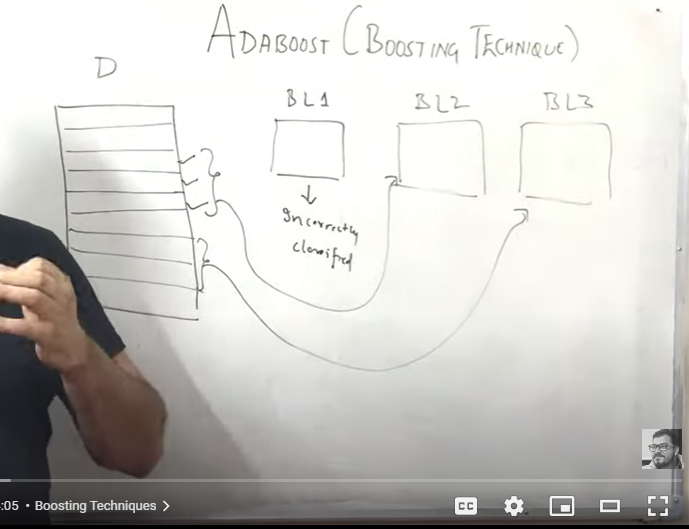

AdaBoost - weights are assigned unlike bagging

**Euclidean Distance and Manhattan Distance**

- Euclidean distance simimilar to calculating the hypotenuse
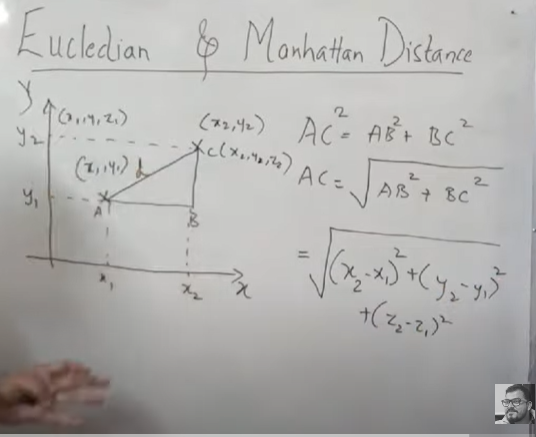

Manhattan Distance
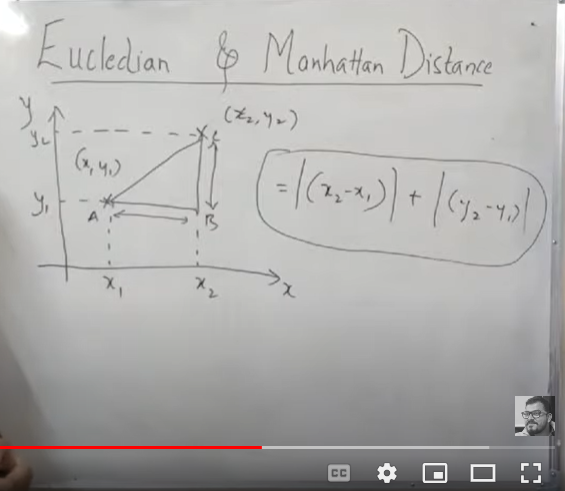



## **K Means Clustering**

The following are the steps in using Kmeans Clustering:(Unsupervised Machine Learning Algorithm)
- Select the K Value : selectying the number of centroids
- The centroids are initialised randomly. 
- Select the groups based on Euclidean Distance & find the mean and move the centroid to the mean
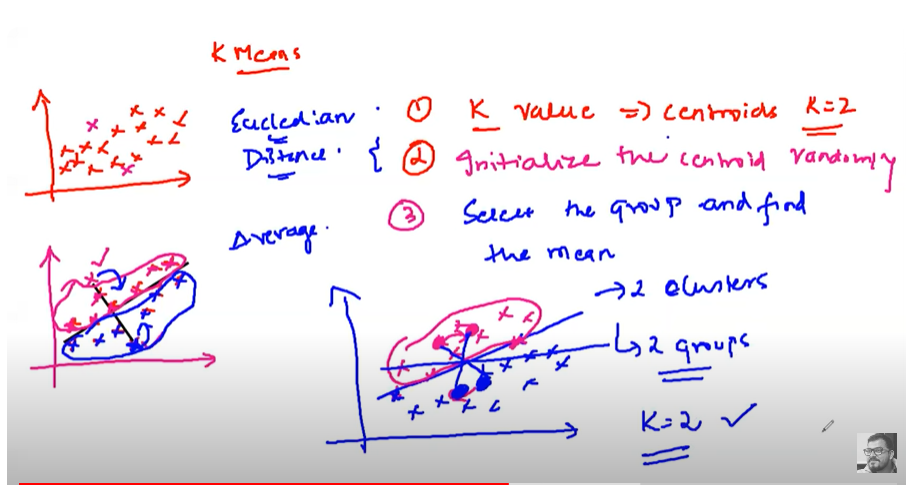
- Elbow method is used to estiated the K Value
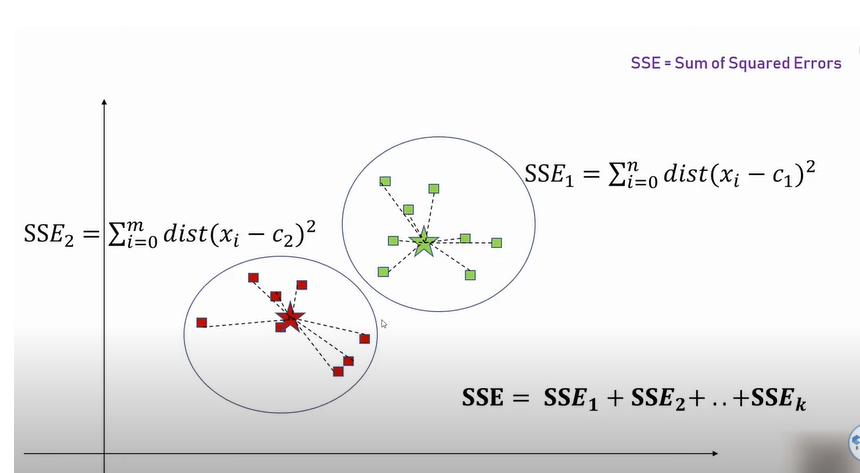
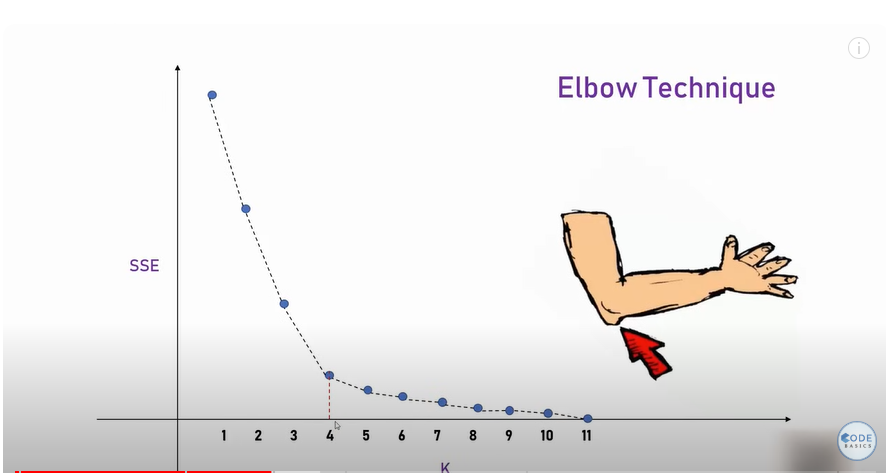

**Clustering Practical Implementation**

In [57]:
from sklearn.cluster import KMeans
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from matplotlib import pyplot as plt
%matplotlib inline

In [58]:
df = pd.read_csv("income.csv")
df.head()

,Name,Age,Income($)
0,Rob,27,70000
1,Michael,29,90000
2,Mohan,29,61000
3,Ismail,28,60000
4,Kory,42,150000


Text(0, 0.5, 'Income($)')

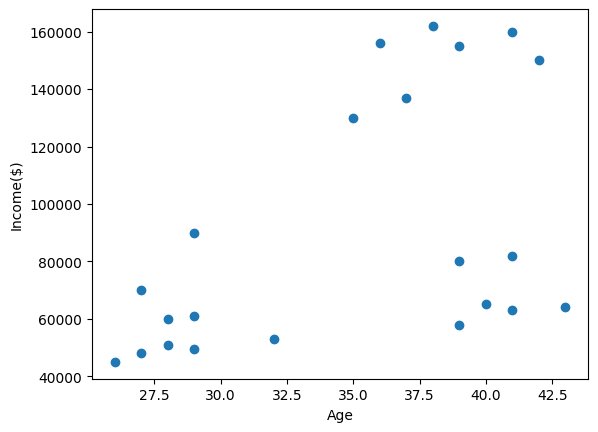

In [59]:
plt.scatter(df.Age,df['Income($)'])
plt.xlabel('Age')
plt.ylabel('Income($)')

In [60]:
km = KMeans(n_clusters=3)
y_predicted = km.fit_predict(df[['Age','Income($)']])
y_predicted

array([2, 0, 2, 2, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 2],
      dtype=int32)

In [61]:
df['cluster']=y_predicted
df.head()

,Name,Age,Income($),cluster
0,Rob,27,70000,2
1,Michael,29,90000,0
2,Mohan,29,61000,2
3,Ismail,28,60000,2
4,Kory,42,150000,1


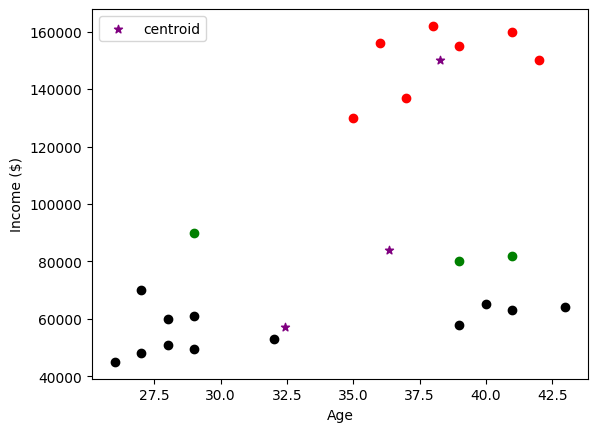

In [62]:
df1 = df[df.cluster==0]
df2 = df[df.cluster==1]
df3 = df[df.cluster==2]
plt.scatter(df1.Age,df1['Income($)'],color='green')
plt.scatter(df2.Age,df2['Income($)'],color='red')
plt.scatter(df3.Age,df3['Income($)'],color='black')
plt.scatter(km.cluster_centers_[:,0],km.cluster_centers_[:,1],color='purple',marker='*',label='centroid')
plt.xlabel('Age')
plt.ylabel('Income ($)')
plt.legend()

From above we can see cluster 2 is not categorized accurately doing do the scaling issue.

In [63]:
scaler = MinMaxScaler()

scaler.fit(df[['Income($)']])
df['Income($)'] = scaler.transform(df[['Income($)']])

scaler.fit(df[['Age']])
df['Age'] = scaler.transform(df[['Age']])

In [64]:
df.head()

,Name,Age,Income($),cluster
0,Rob,0.058824,0.213675,2
1,Michael,0.176471,0.384615,0
2,Mohan,0.176471,0.136752,2
3,Ismail,0.117647,0.128205,2
4,Kory,0.941176,0.897436,1


Text(0, 0.5, 'Income($)')

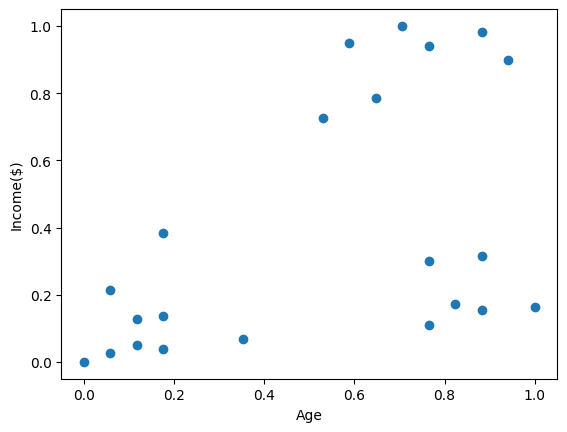

In [65]:
plt.scatter(df.Age,df['Income($)'])
plt.xlabel('Age')
plt.ylabel('Income($)')

In [66]:
km = KMeans(n_clusters=3)
y_predicted = km.fit_predict(df[['Age','Income($)']])
y_predicted

array([1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2],
      dtype=int32)

In [67]:
df['cluster']=y_predicted
df.head()

,Name,Age,Income($),cluster
0,Rob,0.058824,0.213675,1
1,Michael,0.176471,0.384615,1
2,Mohan,0.176471,0.136752,1
3,Ismail,0.117647,0.128205,1
4,Kory,0.941176,0.897436,0


In [68]:
km.cluster_centers_

array([[0.72268908, 0.8974359 ],
       [0.1372549 , 0.11633428],
       [0.85294118, 0.2022792 ]])

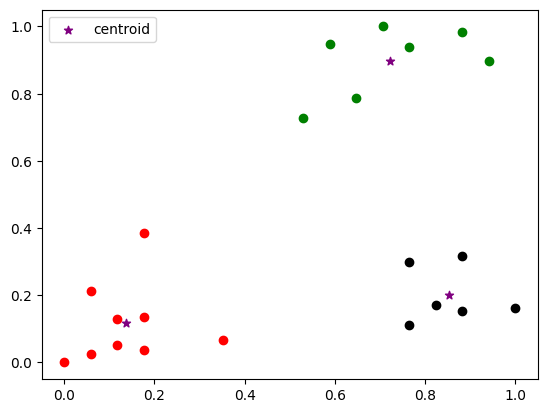

In [69]:
df1 = df[df.cluster==0]
df2 = df[df.cluster==1]
df3 = df[df.cluster==2]
plt.scatter(df1.Age,df1['Income($)'],color='green')
plt.scatter(df2.Age,df2['Income($)'],color='red')
plt.scatter(df3.Age,df3['Income($)'],color='black')
plt.scatter(km.cluster_centers_[:,0],km.cluster_centers_[:,1],color='purple',marker='*',label='centroid')
plt.legend()

**Elbow Plot**

In [70]:
sse = []
k_rng = range(1,10)
for k in k_rng:
    km = KMeans(n_clusters=k)
    km.fit(df[['Age','Income($)']])
    sse.append(km.inertia_)

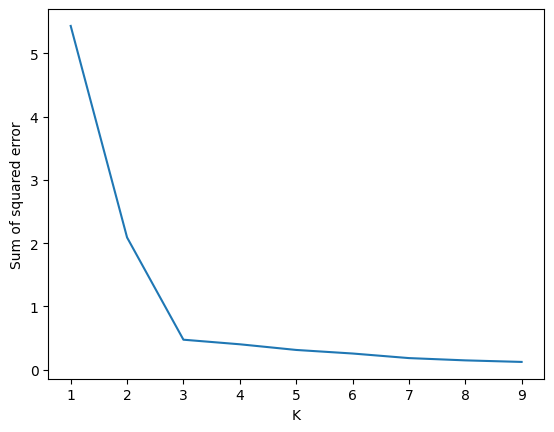

In [71]:
plt.xlabel('K')
plt.ylabel('Sum of squared error')
plt.plot(k_rng,sse)

## **Hierarchical Clustering intuition**

- This is an unsupervised Machine learning technique
- Using Dendograms
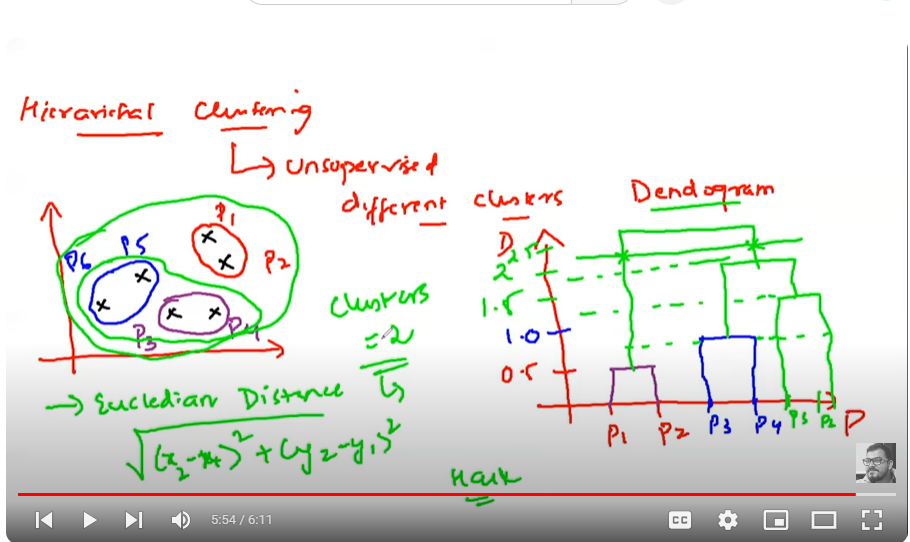

## **Density-Based Spatial Clustering of Applications with Noise(DBSCAN)**

Density-based spatial clustering of applications with noise (DBSCAN) is a well-known data clustering algorithm that is commonly used in data mining and machine learning.

Based on a set of points (let’s think in a bidimensional space as exemplified in the figure), DBSCAN groups together points that are close to each other based on a distance measurement (usually Euclidean distance) and a minimum number of points. It also marks as outliers the points that are in low-density regions.

The main components:
- Epsilon
- Minimum points
- Core Points - Has atleast 4 points - the number of minimum points falling within the circle plotted using the Epsilon.
- Border Points
- Noise Points - An outlier
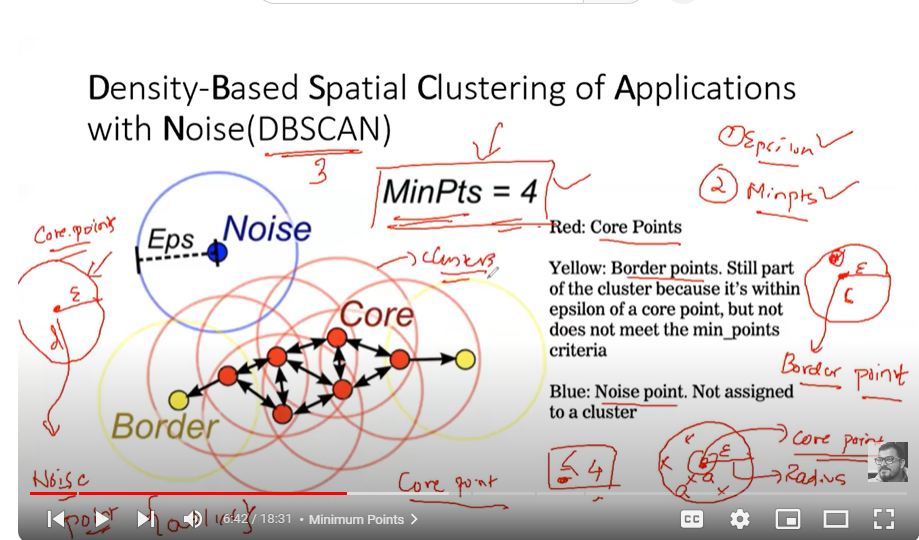


This algo works well with data that has a lot of noisy points
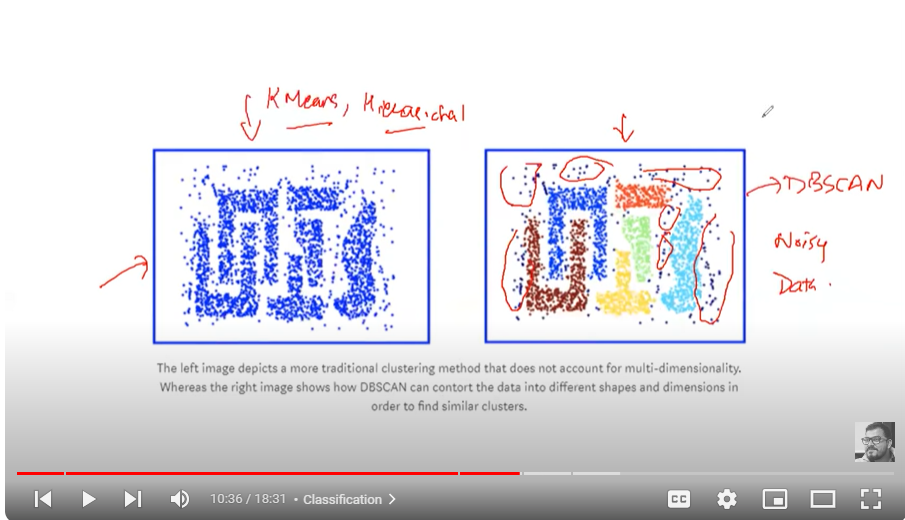

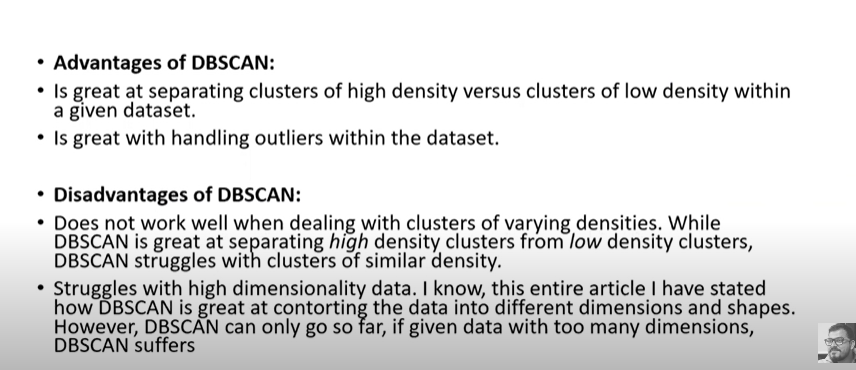

**Validating Clustering Models- Unsupervised Machine Learning:Silhouette (clustering)**

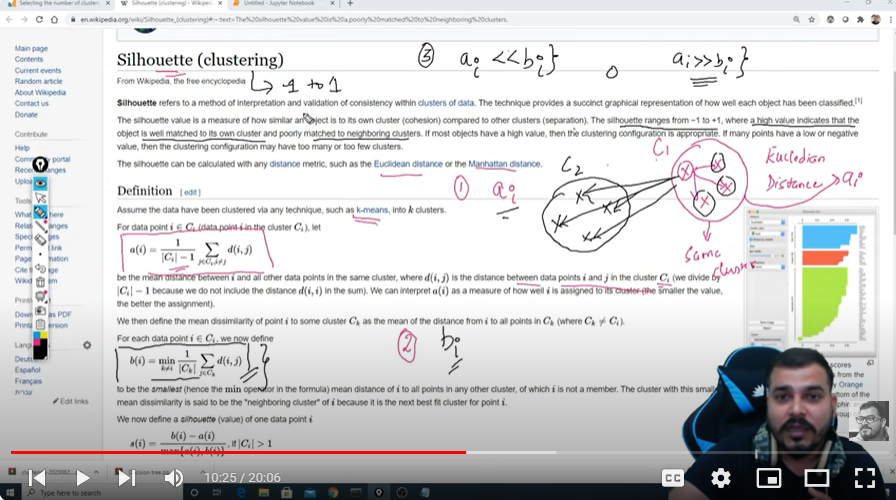



**Performance Metrics Clustering-Silhouetter Coefficient**

In [2]:
#IMPORTING LIBS
from sklearn.datasets import make_blobs
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np

In [3]:
# Generating the sample data from make_blobs
# This particular setting has one distinct cluster and 3 clusters placed close
# together.
X, y = make_blobs(n_samples=500,
                  n_features=2,
                  centers=4,
                  cluster_std=1,
                  center_box=(-10.0, 10.0),
                  shuffle=True,
                  random_state=1)  # For reproducibility

range_n_clusters = [2, 3, 4, 5, 6]

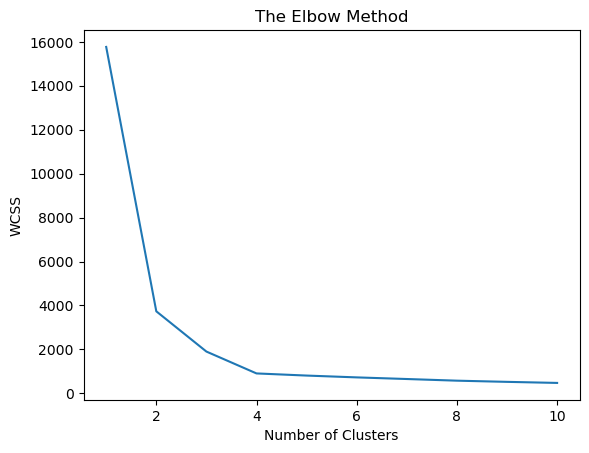

In [8]:
#Performing cluster modelling
from sklearn.cluster import KMeans

wcss = []
for i in range(1,11):
    kmeans = KMeans(n_clusters=i,init='k-means++',n_init=10,random_state=0)
    kmeans.fit(X)
    wcss.append(kmeans.inertia_)

plt.plot(range(1,11),wcss)
plt.title('The Elbow Method')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.show()

Based on the above elbow curve, k=4, is the optimum number of clusters.

In [9]:
clusterer = KMeans(n_clusters=4, random_state=10)
cluster_labels = clusterer.fit_predict(X)
print(cluster_labels)

C:\Users\ADMIN\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


[3 3 0 1 2 1 2 2 2 2 3 3 2 1 2 3 2 3 1 2 0 0 2 1 2 2 1 1 0 2 3 1 2 3 2 3 0
 0 3 0 2 0 1 2 2 3 0 2 1 1 1 0 0 2 3 0 0 0 0 2 1 1 0 2 1 2 3 2 0 0 3 0 2 3
 2 2 3 2 2 0 1 1 0 1 1 0 0 1 0 0 1 3 0 2 1 3 3 2 3 1 1 3 1 0 1 2 2 1 1 0 2
 3 1 0 1 0 1 2 1 2 0 3 3 0 2 0 1 3 3 2 1 0 0 0 0 3 1 2 1 1 2 3 2 1 1 1 2 2
 3 3 0 0 1 3 1 0 0 0 0 0 0 0 0 0 1 3 3 3 2 1 3 0 2 3 1 0 0 0 0 3 2 0 1 3 3
 0 2 3 3 2 1 1 3 3 2 1 2 3 3 1 3 0 1 2 2 3 2 0 3 2 0 2 0 3 2 2 2 1 0 1 2 3
 0 2 0 0 0 1 0 1 3 0 3 0 1 1 0 3 1 3 2 0 3 3 3 3 2 0 3 0 2 1 1 2 2 1 0 2 0
 1 2 1 0 0 1 2 3 3 0 0 0 2 1 1 2 1 0 3 1 3 1 3 3 1 3 1 1 2 0 0 0 2 2 0 3 1
 3 3 3 2 0 2 3 0 3 3 0 3 3 0 1 3 2 2 1 1 0 3 1 1 2 3 1 1 2 0 1 0 2 3 3 1 0
 3 2 1 1 2 2 2 3 2 1 1 0 1 1 1 1 3 3 2 1 0 2 3 1 0 1 2 1 0 2 0 1 2 2 3 1 3
 3 3 3 3 3 0 3 1 3 1 1 0 1 2 0 0 3 1 0 1 2 3 0 0 3 0 0 1 1 3 0 2 1 2 2 3 3
 2 3 0 0 3 0 3 0 1 3 1 0 2 1 0 2 1 3 2 1 1 0 2 0 2 3 1 3 2 1 3 3 3 0 1 2 3
 2 2 0 0 3 2 2 2 2 2 2 3 2 0 3 2 1 2 1 2 0 0 1 1 1 0 2 0 3 0 1 2 3 1 3 1 3
 2 1 1 3 0 2 3 0 0 0 3 2 

For n_clusters = 2 The average silhouette_score is : 0.7049787496083262
For n_clusters = 3 The average silhouette_score is : 0.5882004012129721
For n_clusters = 4 The average silhouette_score is : 0.6505186632729437
For n_clusters = 5 The average silhouette_score is : 0.5804620679044765
For n_clusters = 6 The average silhouette_score is : 0.4966479110816958


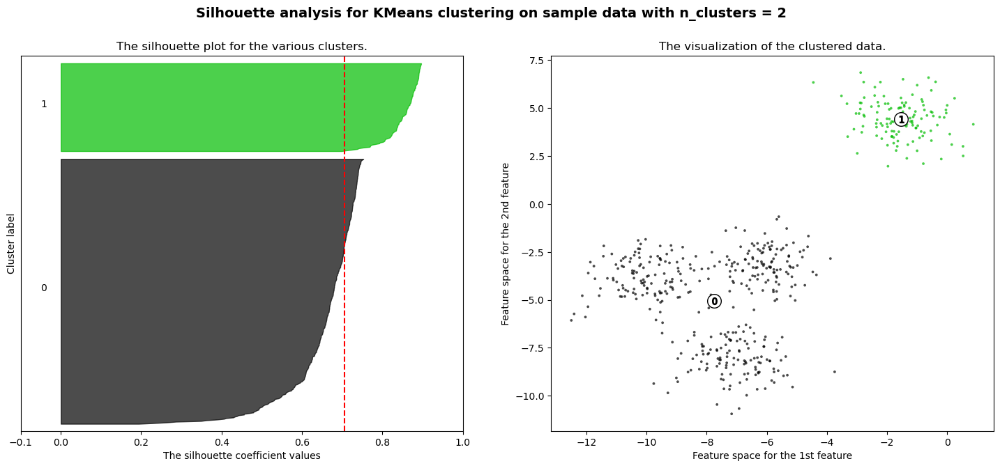

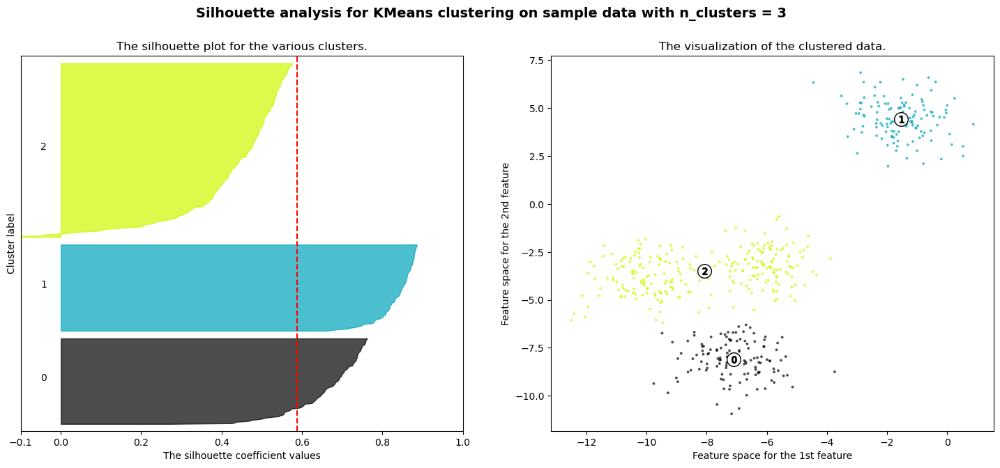

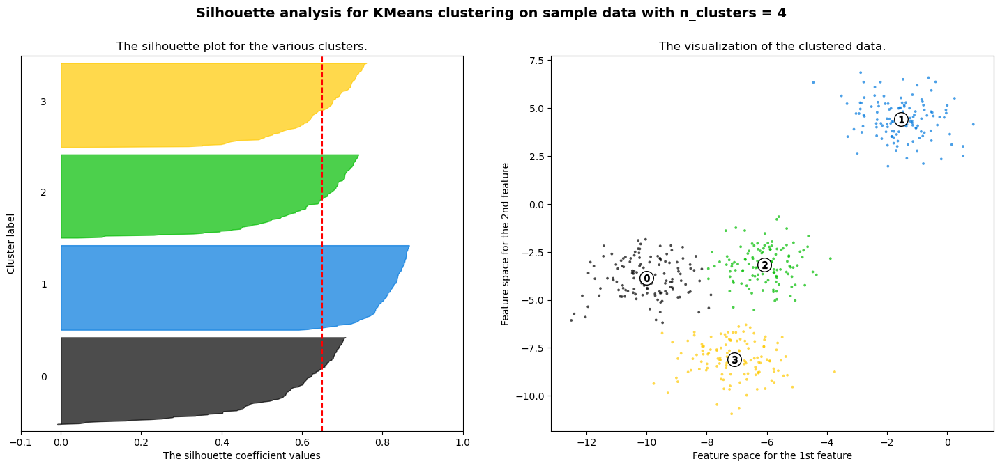

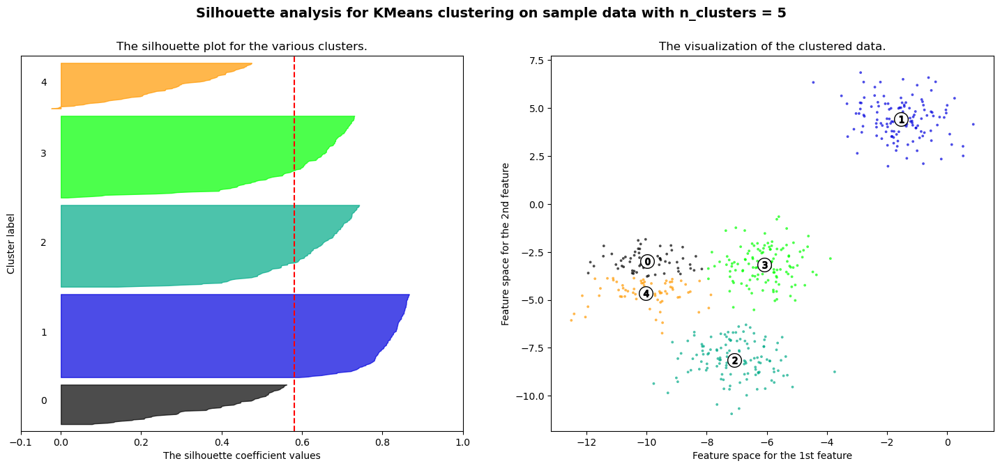

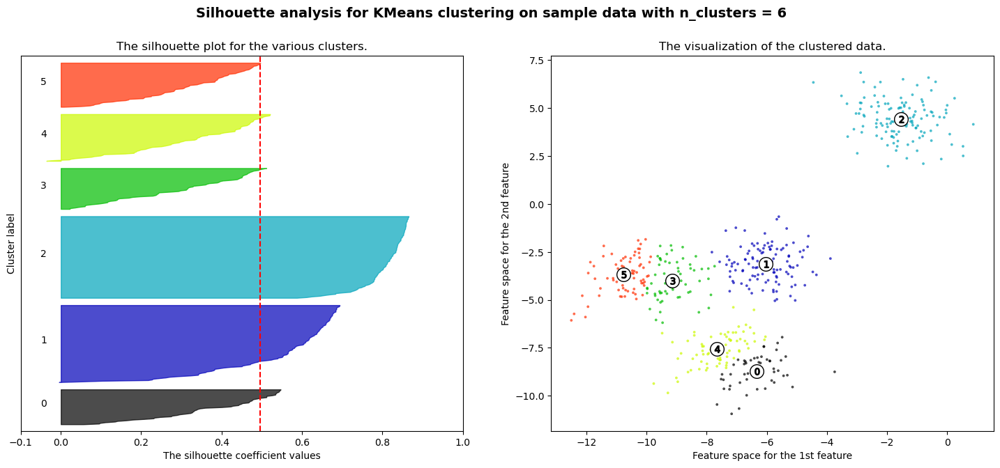

In [10]:
for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters,n_init=10, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

### **Curse of Dimensionality Easily explained**
- Dimensions are also called features or attributes

The curse of dimensionality refers to various phenomena that arise when analyzing and organizing data in high-dimensional spaces that do not occur in low-dimensional settings such as the three-dimensional physical space of everyday experience.

- When you increase the number of features beyonmd the threshold value, the accuracy of the model decreases.  - Especially if the number of features increases exponentially. 
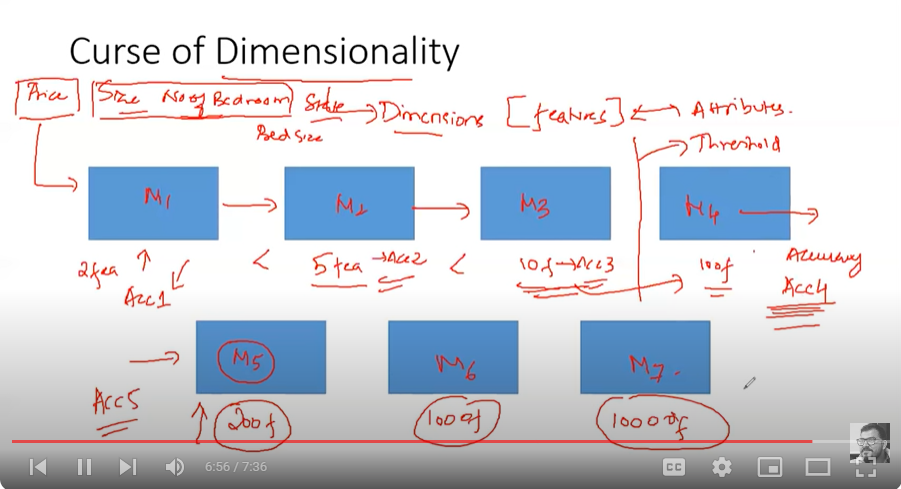


## **Dimensional Reduction| Principal Component Analysis**

- This isn't exacly a machine learning technique but an unsupervised learning algo used to reduce the number of dimensions in Featuree Selection. 
- PCA is called dimensionality reduction technique as it can help reduce dimensions. 

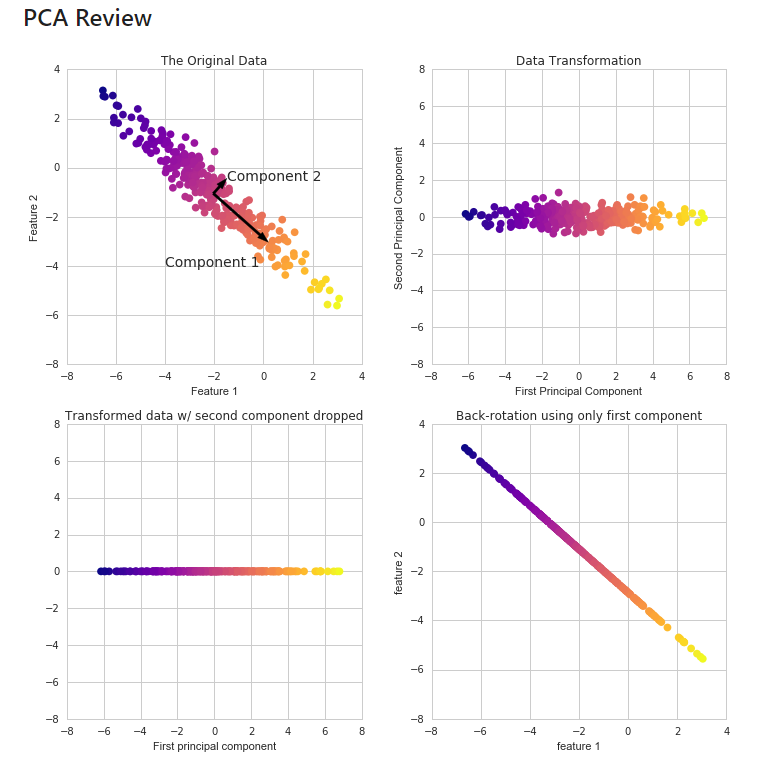

 - You need to scale features before applying PCA
 - The accuracy might drop

In [20]:
#3importing libs
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

pd.set_option("display.max_columns",100)

In [12]:
#loading the cancer dataset
from sklearn.datasets import load_breast_cancer
cancer = load_breast_cancer()

In [13]:
cancer.keys()

dict_keys(['data', 'target', 'frame', 'target_names', 'DESCR', 'feature_names', 'filename', 'data_module'])

In [14]:
print(cancer['DESCR'])

.. _breast_cancer_dataset:

Breast cancer wisconsin (diagnostic) dataset
--------------------------------------------

**Data Set Characteristics:**

    :Number of Instances: 569

    :Number of Attributes: 30 numeric, predictive attributes and the class

    :Attribute Information:
        - radius (mean of distances from center to points on the perimeter)
        - texture (standard deviation of gray-scale values)
        - perimeter
        - area
        - smoothness (local variation in radius lengths)
        - compactness (perimeter^2 / area - 1.0)
        - concavity (severity of concave portions of the contour)
        - concave points (number of concave portions of the contour)
        - symmetry
        - fractal dimension ("coastline approximation" - 1)

        The mean, standard error, and "worst" or largest (mean of the three
        worst/largest values) of these features were computed for each image,
        resulting in 30 features.  For instance, field 0 is Mean Radi

In [21]:
#creating the dataframe
df = pd.DataFrame(cancer['data'],columns = cancer['feature_names'])
df.head()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,radius error,texture error,perimeter error,area error,smoothness error,compactness error,concavity error,concave points error,symmetry error,fractal dimension error,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,1.0950,0.9053,8.589,153.40,0.006399,0.04904,0.05373,0.01587,0.03003,0.006193,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,0.5435,0.7339,3.398,74.08,0.005225,0.01308,0.01860,0.01340,0.01389,0.003532,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,0.7456,0.7869,4.585,94.03,0.006150,0.04006,0.03832,0.02058,0.02250,0.004571,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,0.4956,1.1560,3.445,27.23,0.009110,0.07458,0.05661,0.01867,0.05963,0.009208,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,0.7572,0.7813,5.438,94.44,0.011490,0.02461,0.05688,0.01885,0.01756,0.005115,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


**PCA Visualization**

As we've noticed before it is difficult to visualize high dimensional data, we can use PCA to find the first two principal components, and visualize the data in this new, two-dimensional space, with a single scatter-plot. Before we do this though, we'll need to scale our data so that each feature has a single unit variance.


In [22]:
#Scaling the data using Standard Scaler
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(df)

StandardScaler()

In [23]:
#transforming
scaled_data = scaler.transform(df)

PCA with Scikit Learn uses a very similar process to other preprocessing functions that come with SciKit Learn. We instantiate a PCA object, find the principal components using the fit method, then apply the rotation and dimensionality reduction by calling transform().

We can also specify how many components we want to keep when creating the PCA object.

In [24]:
#Applying PCS
from sklearn.decomposition import PCA
pca = PCA(n_components =2)
pca.fit(scaled_data)

PCA(n_components=2)

In [25]:
#Transforing the data to its first 2 principal components
x_pca = pca.transform(scaled_data)

In [26]:
print(scaled_data.shape),print(x_pca.shape)

(569, 30)
(569, 2)


(None, None)

From above we can observe that we have reduced 30 dimensions to just 2!

Text(0, 0.5, 'Second Principal Component')

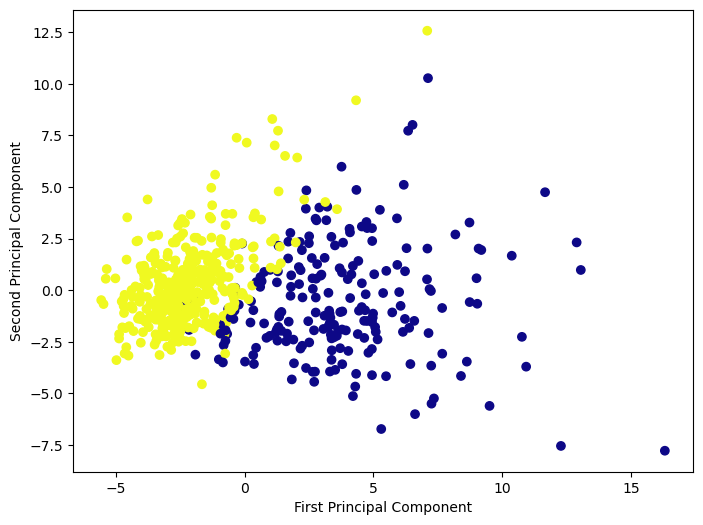

In [27]:
#plotting the 2 dimensions
plt.figure(figsize=(8,6))
plt.scatter(x_pca[:,0],x_pca[:,1],c=cancer['target'],cmap='plasma')
plt.xlabel('First Principal Component')
plt.ylabel('Second Principal Component')

From the above diagram, we can clearly see that the components have been separated into 2 classes/ 

**Interpreting the Components**

Unfortunately, with this great power of dimensionality reduction, comes the cost of being able to easily understand what these components represent.

The components correspond to combinations of the original features, the components themselves are stored as an attribute of the fitted PCA object:


In [28]:
pca.components_

array([[ 0.21890244,  0.10372458,  0.22753729,  0.22099499,  0.14258969,
         0.23928535,  0.25840048,  0.26085376,  0.13816696,  0.06436335,
         0.20597878,  0.01742803,  0.21132592,  0.20286964,  0.01453145,
         0.17039345,  0.15358979,  0.1834174 ,  0.04249842,  0.10256832,
         0.22799663,  0.10446933,  0.23663968,  0.22487053,  0.12795256,
         0.21009588,  0.22876753,  0.25088597,  0.12290456,  0.13178394],
       [-0.23385713, -0.05970609, -0.21518136, -0.23107671,  0.18611302,
         0.15189161,  0.06016536, -0.0347675 ,  0.19034877,  0.36657547,
        -0.10555215,  0.08997968, -0.08945723, -0.15229263,  0.20443045,
         0.2327159 ,  0.19720728,  0.13032156,  0.183848  ,  0.28009203,
        -0.21986638, -0.0454673 , -0.19987843, -0.21935186,  0.17230435,
         0.14359317,  0.09796411, -0.00825724,  0.14188335,  0.27533947]])

In this numpy matrix array, each row represents a principal component, and each column relates back to the original features. we can visualize this relationship with a heatmap:

In [29]:
df_comp = pd.DataFrame(pca.components_,columns=cancer['feature_names'])

In [30]:
df_comp.head()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,radius error,texture error,perimeter error,area error,smoothness error,compactness error,concavity error,concave points error,symmetry error,fractal dimension error,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
0,0.218902,0.103725,0.227537,0.220995,0.142590,0.239285,0.258400,0.260854,0.138167,0.064363,0.205979,0.017428,0.211326,0.202870,0.014531,0.170393,0.153590,0.183417,0.042498,0.102568,0.227997,0.104469,0.236640,0.224871,0.127953,0.210096,0.228768,0.250886,0.122905,0.131784
1,-0.233857,-0.059706,-0.215181,-0.231077,0.186113,0.151892,0.060165,-0.034768,0.190349,0.366575,-0.105552,0.089980,-0.089457,-0.152293,0.204430,0.232716,0.197207,0.130322,0.183848,0.280092,-0.219866,-0.045467,-0.199878,-0.219352,0.172304,0.143593,0.097964,-0.008257,0.141883,0.275339


<Axes: >

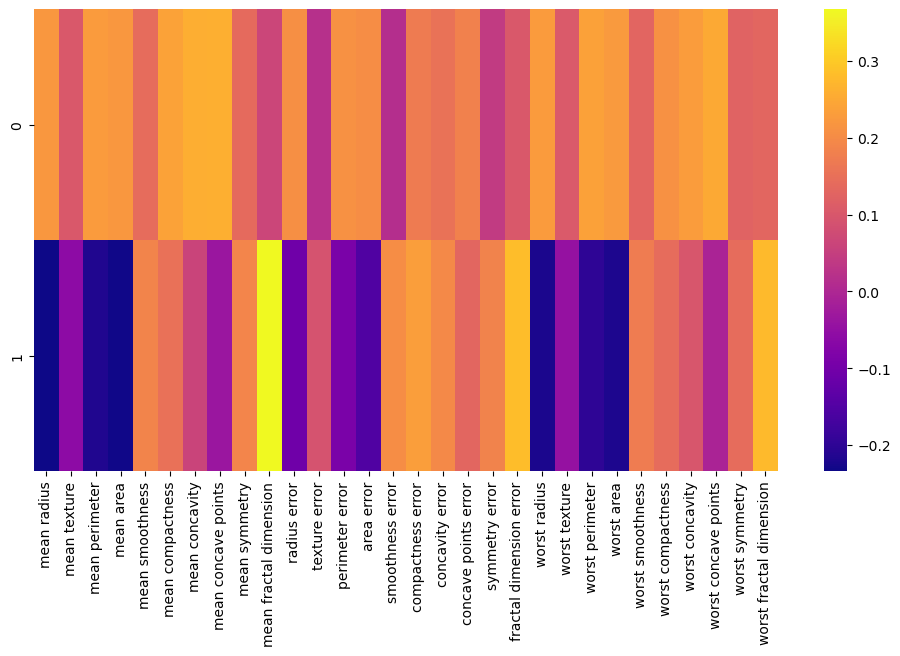

In [31]:
plt.figure(figsize=(12,6))
sns.heatmap(df_comp,cmap='plasma',)

This heatmap and the color bar basically represent the correlation between the various feature and the principal component itself.

**Practical Implementation 2:**

In [156]:
from sklearn.datasets import load_digits
import pandas as pd

dataset = load_digits()
dataset.keys()

dict_keys(['data', 'target', 'frame', 'feature_names', 'target_names', 'images', 'DESCR'])

In [157]:
dataset.data.shape

(1797, 64)

In [158]:
dataset.data[0]

array([ 0.,  0.,  5., 13.,  9.,  1.,  0.,  0.,  0.,  0., 13., 15., 10.,
       15.,  5.,  0.,  0.,  3., 15.,  2.,  0., 11.,  8.,  0.,  0.,  4.,
       12.,  0.,  0.,  8.,  8.,  0.,  0.,  5.,  8.,  0.,  0.,  9.,  8.,
        0.,  0.,  4., 11.,  0.,  1., 12.,  7.,  0.,  0.,  2., 14.,  5.,
       10., 12.,  0.,  0.,  0.,  0.,  6., 13., 10.,  0.,  0.,  0.])

In [159]:
dataset.data[0].reshape(8,8)

array([[ 0.,  0.,  5., 13.,  9.,  1.,  0.,  0.],
       [ 0.,  0., 13., 15., 10., 15.,  5.,  0.],
       [ 0.,  3., 15.,  2.,  0., 11.,  8.,  0.],
       [ 0.,  4., 12.,  0.,  0.,  8.,  8.,  0.],
       [ 0.,  5.,  8.,  0.,  0.,  9.,  8.,  0.],
       [ 0.,  4., 11.,  0.,  1., 12.,  7.,  0.],
       [ 0.,  2., 14.,  5., 10., 12.,  0.,  0.],
       [ 0.,  0.,  6., 13., 10.,  0.,  0.,  0.]])

<Figure size 640x480 with 0 Axes>

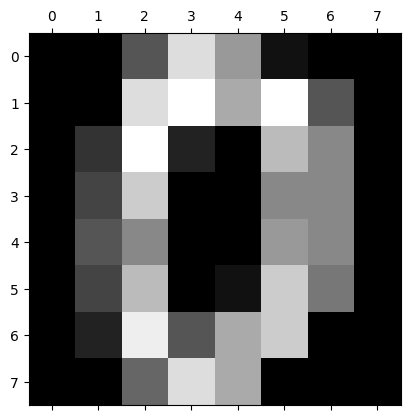

In [160]:
from matplotlib import pyplot as plt
%matplotlib inline
plt.gray()
plt.matshow(dataset.data[0].reshape(8,8))

In [161]:
df = pd.DataFrame(dataset.data, columns=dataset.feature_names)
df.head()

,pixel_0_0,pixel_0_1,pixel_0_2,pixel_0_3,pixel_0_4,pixel_0_5,pixel_0_6,pixel_0_7,pixel_1_0,pixel_1_1,...,pixel_6_6,pixel_6_7,pixel_7_0,pixel_7_1,pixel_7_2,pixel_7_3,pixel_7_4,pixel_7_5,pixel_7_6,pixel_7_7
0,0.0,0.0,5.0,13.0,9.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,6.0,13.0,10.0,0.0,0.0,0.0
1,0.0,0.0,0.0,12.0,13.0,5.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,11.0,16.0,10.0,0.0,0.0
2,0.0,0.0,0.0,4.0,15.0,12.0,0.0,0.0,0.0,0.0,...,5.0,0.0,0.0,0.0,0.0,3.0,11.0,16.0,9.0,0.0
3,0.0,0.0,7.0,15.0,13.0,1.0,0.0,0.0,0.0,8.0,...,9.0,0.0,0.0,0.0,7.0,13.0,13.0,9.0,0.0,0.0
4,0.0,0.0,0.0,1.0,11.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,2.0,16.0,4.0,0.0,0.0


In [162]:
df.describe()

,pixel_0_0,pixel_0_1,pixel_0_2,pixel_0_3,pixel_0_4,pixel_0_5,pixel_0_6,pixel_0_7,pixel_1_0,pixel_1_1,...,pixel_6_6,pixel_6_7,pixel_7_0,pixel_7_1,pixel_7_2,pixel_7_3,pixel_7_4,pixel_7_5,pixel_7_6,pixel_7_7
count,1797.0,1797.000000,1797.000000,1797.000000,1797.000000,1797.000000,1797.000000,1797.000000,1797.000000,1797.000000,...,1797.000000,1797.000000,1797.000000,1797.000000,1797.000000,1797.000000,1797.000000,1797.000000,1797.000000,1797.000000
mean,0.0,0.303840,5.204786,11.835838,11.848080,5.781859,1.362270,0.129661,0.005565,1.993879,...,3.725097,0.206455,0.000556,0.279354,5.557596,12.089037,11.809126,6.764051,2.067891,0.364496
std,0.0,0.907192,4.754826,4.248842,4.287388,5.666418,3.325775,1.037383,0.094222,3.196160,...,4.919406,0.984401,0.023590,0.934302,5.103019,4.374694,4.933947,5.900623,4.090548,1.860122
min,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.0,0.000000,1.000000,10.000000,10.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,1.000000,11.000000,10.000000,0.000000,0.000000,0.000000
50%,0.0,0.000000,4.000000,13.000000,13.000000,4.000000,0.000000,0.000000,0.000000,0.000000,...,1.000000,0.000000,0.000000,0.000000,4.000000,13.000000,14.000000,6.000000,0.000000,0.000000
75%,0.0,0.000000,9.000000,15.000000,15.000000,11.000000,0.000000,0.000000,0.000000,3.000000,...,7.000000,0.000000,0.000000,0.000000,10.000000,16.000000,16.000000,12.000000,2.000000,0.000000
max,0.0,8.000000,16.000000,16.000000,16.000000,16.000000,16.000000,15.000000,2.000000,16.000000,...,16.000000,13.000000,1.000000,9.000000,16.000000,16.000000,16.000000,16.000000,16.000000,16.000000


In [163]:
X = df
y = dataset.target

In [164]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_scaled

array([[ 0.        , -0.33501649, -0.04308102, ..., -1.14664746,
        -0.5056698 , -0.19600752],
       [ 0.        , -0.33501649, -1.09493684, ...,  0.54856067,
        -0.5056698 , -0.19600752],
       [ 0.        , -0.33501649, -1.09493684, ...,  1.56568555,
         1.6951369 , -0.19600752],
       ...,
       [ 0.        , -0.33501649, -0.88456568, ..., -0.12952258,
        -0.5056698 , -0.19600752],
       [ 0.        , -0.33501649, -0.67419451, ...,  0.8876023 ,
        -0.5056698 , -0.19600752],
       [ 0.        , -0.33501649,  1.00877481, ...,  0.8876023 ,
        -0.26113572, -0.19600752]])

In [165]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=30)

In [166]:
from sklearn.linear_model import LogisticRegression

model = LogisticRegression()
model.fit(X_train, y_train)
model.score(X_test, y_test)

0.9722222222222222

**Using PCA to reduce dimensions**

In [167]:
X.head()

,pixel_0_0,pixel_0_1,pixel_0_2,pixel_0_3,pixel_0_4,pixel_0_5,pixel_0_6,pixel_0_7,pixel_1_0,pixel_1_1,...,pixel_6_6,pixel_6_7,pixel_7_0,pixel_7_1,pixel_7_2,pixel_7_3,pixel_7_4,pixel_7_5,pixel_7_6,pixel_7_7
0,0.0,0.0,5.0,13.0,9.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,6.0,13.0,10.0,0.0,0.0,0.0
1,0.0,0.0,0.0,12.0,13.0,5.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,11.0,16.0,10.0,0.0,0.0
2,0.0,0.0,0.0,4.0,15.0,12.0,0.0,0.0,0.0,0.0,...,5.0,0.0,0.0,0.0,0.0,3.0,11.0,16.0,9.0,0.0
3,0.0,0.0,7.0,15.0,13.0,1.0,0.0,0.0,0.0,8.0,...,9.0,0.0,0.0,0.0,7.0,13.0,13.0,9.0,0.0,0.0
4,0.0,0.0,0.0,1.0,11.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,2.0,16.0,4.0,0.0,0.0


Use components such that 95% of variance is retained

In [168]:
from sklearn.decomposition import PCA

pca = PCA(0.95)
X_pca = pca.fit_transform(X)
X_pca.shape

(1797, 29)

In [169]:
pca.explained_variance_ratio_

array([0.14890594, 0.13618771, 0.11794594, 0.08409979, 0.05782415,
       0.0491691 , 0.04315987, 0.03661373, 0.03353248, 0.03078806,
       0.02372341, 0.02272697, 0.01821863, 0.01773855, 0.01467101,
       0.01409716, 0.01318589, 0.01248138, 0.01017718, 0.00905617,
       0.00889538, 0.00797123, 0.00767493, 0.00722904, 0.00695889,
       0.00596081, 0.00575615, 0.00515158, 0.0048954 ])

In [170]:
pca.n_components_

np.int64(29)

In [171]:
X_train_pca, X_test_pca, y_train, y_test = train_test_split(X_pca, y, test_size=0.2, random_state=30)

In [172]:
from sklearn.linear_model import LogisticRegression

model = LogisticRegression(max_iter=1000)
model.fit(X_train_pca, y_train)
model.score(X_test_pca, y_test)

0.9694444444444444

**Selecting only 2 components**

In [173]:
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)
X_pca.shape

(1797, 2)

In [174]:
pca.explained_variance_ratio_

array([0.14890594, 0.13618771])

You can see that both combined retains 0.14+0.13=0.27 or 27% of important feature information

In [175]:
X_train_pca, X_test_pca, y_train, y_test = train_test_split(X_pca, y, test_size=0.2, random_state=30)

model = LogisticRegression(max_iter=1000)
model.fit(X_train_pca, y_train)
model.score(X_test_pca, y_test)

0.6083333333333333

We get less accuancy (~60%) as using only 2 components did not retain much of the feature information. However in real life you will find many cases where using 2 or few PCA components can still give you a pretty good accuracy

## **Cross Validation**

The various types of cross validation:
- Leave one out cross validation - where one record is left out of the training dataset. This is a computationally expensive method & leads to low bias.
- K Fold Cross Validation: based on the k value: You can be able to get the average, max and min accuracy of the model.  - Can sometimes lead to an imblanced dataset. 
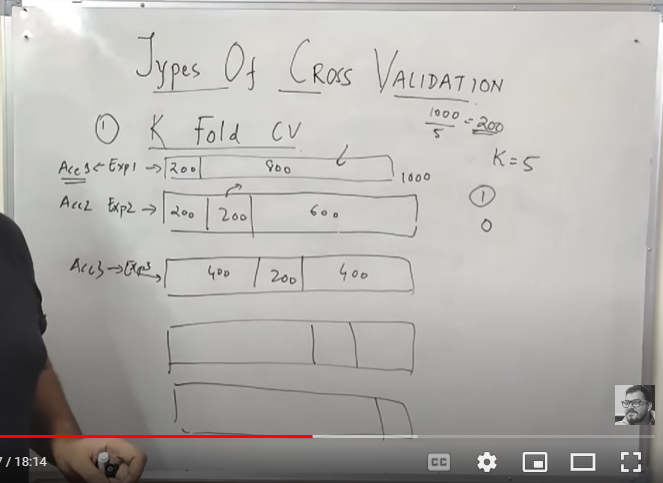
- Stratified K Fold Cross Validation: Ensures for each expirement in the train and test, the no of instances of each class are maintained.
- Time Series Cross Validation:
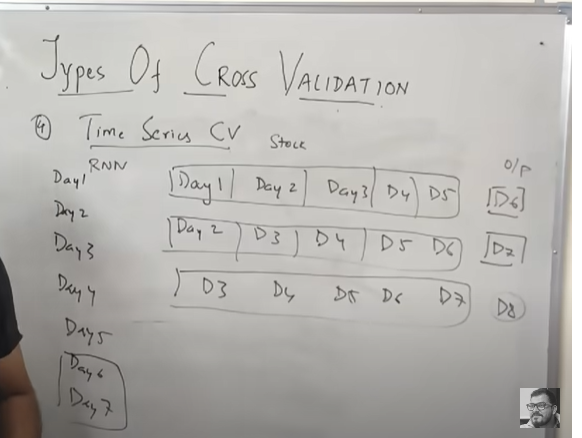

Many times we get in a dilemma of which machine learning model should we use for a given problem. KFold cross validation allows us to evaluate performance of a model by creating K folds of given dataset. This is better then traditional train_test_split.
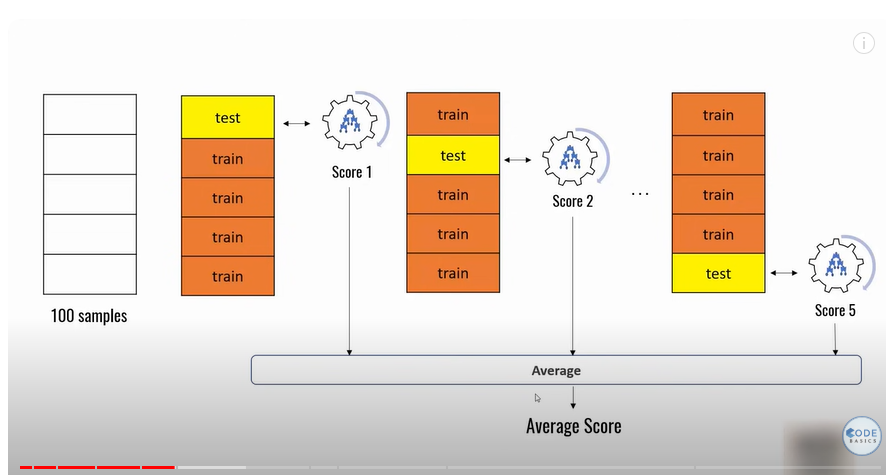

**Practical Implementation**

In [41]:
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
import numpy as np
from sklearn.datasets import load_digits
import matplotlib.pyplot as plt
digits = load_digits()

In [42]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(digits.data,digits.target,test_size=0.3)

**Logistic Regression**

In [43]:
lr = LogisticRegression(solver='liblinear',multi_class='ovr')
lr.fit(X_train, y_train)
lr.score(X_test, y_test)

c:\Users\ADMIN\Documents\Data Analytics\Machine Learning\Machine Learning Concepts\venv\lib\site-packages\sklearn\linear_model\_logistic.py:1256: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. Use OneVsRestClassifier(LogisticRegression(..)) instead. Leave it to its default value to avoid this warning.
  warnings.warn(


0.9611111111111111

**SVM**

In [44]:
svm = SVC(gamma='auto')
svm.fit(X_train, y_train)
svm.score(X_test, y_test)

0.3851851851851852

**Random Forest**

In [45]:
rf = RandomForestClassifier(n_estimators=40)
rf.fit(X_train, y_train)
rf.score(X_test, y_test)

0.9703703703703703

**KFold Cross Validation**

In [46]:
from sklearn.model_selection import KFold
kf = KFold(n_splits=3)
kf

KFold(n_splits=3, random_state=None, shuffle=False)

In [47]:
for train_index, test_index in kf.split([1,2,3,4,5,6,7,8,9]):
    print(train_index, test_index)

[3 4 5 6 7 8] [0 1 2]
[0 1 2 6 7 8] [3 4 5]
[0 1 2 3 4 5] [6 7 8]


In [48]:
def get_score(model, X_train, X_test, y_train, y_test):
    model.fit(X_train, y_train)
    return model.score(X_test, y_test)

In [49]:
from sklearn.model_selection import StratifiedKFold
folds = StratifiedKFold(n_splits=3)

scores_logistic = []
scores_svm = []
scores_rf = []

for train_index, test_index in folds.split(digits.data,digits.target):
    X_train, X_test, y_train, y_test = digits.data[train_index], digits.data[test_index], \
                                       digits.target[train_index], digits.target[test_index]
    scores_logistic.append(get_score(LogisticRegression(solver='liblinear',multi_class='ovr'), X_train, X_test, y_train, y_test))  
    scores_svm.append(get_score(SVC(gamma='auto'), X_train, X_test, y_train, y_test))
    scores_rf.append(get_score(RandomForestClassifier(n_estimators=40), X_train, X_test, y_train, y_test))

c:\Users\ADMIN\Documents\Data Analytics\Machine Learning\Machine Learning Concepts\venv\lib\site-packages\sklearn\linear_model\_logistic.py:1256: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. Use OneVsRestClassifier(LogisticRegression(..)) instead. Leave it to its default value to avoid this warning.
  warnings.warn(
c:\Users\ADMIN\Documents\Data Analytics\Machine Learning\Machine Learning Concepts\venv\lib\site-packages\sklearn\linear_model\_logistic.py:1256: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. Use OneVsRestClassifier(LogisticRegression(..)) instead. Leave it to its default value to avoid this warning.
  warnings.warn(
c:\Users\ADMIN\Documents\Data Analytics\Machine Learning\Machine Learning Concepts\venv\lib\site-packages\sklearn\linear_model\_logistic.py:1256: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. Use OneVsRestClassifier(LogisticRegression(..))

In [50]:
scores_logistic

[0.8948247078464107, 0.9532554257095158, 0.9098497495826378]

In [51]:
scores_svm

[0.3806343906510851, 0.41068447412353926, 0.5125208681135225]

In [52]:
scores_rf

[0.9248747913188647, 0.9499165275459098, 0.9298831385642737]

**Using Cross Val Score**

In [53]:
from sklearn.model_selection import cross_val_score

In [54]:
cross_val_score(LogisticRegression(solver='liblinear',multi_class='ovr'), digits.data, digits.target,cv=3)

c:\Users\ADMIN\Documents\Data Analytics\Machine Learning\Machine Learning Concepts\venv\lib\site-packages\sklearn\linear_model\_logistic.py:1256: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. Use OneVsRestClassifier(LogisticRegression(..)) instead. Leave it to its default value to avoid this warning.
  warnings.warn(
c:\Users\ADMIN\Documents\Data Analytics\Machine Learning\Machine Learning Concepts\venv\lib\site-packages\sklearn\linear_model\_logistic.py:1256: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. Use OneVsRestClassifier(LogisticRegression(..)) instead. Leave it to its default value to avoid this warning.
  warnings.warn(
c:\Users\ADMIN\Documents\Data Analytics\Machine Learning\Machine Learning Concepts\venv\lib\site-packages\sklearn\linear_model\_logistic.py:1256: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. Use OneVsRestClassifier(LogisticRegression(..))

array([0.89482471, 0.95325543, 0.90984975])

In [55]:
cross_val_score(RandomForestClassifier(n_estimators=40),digits.data, digits.target,cv=3)

array([0.94657763, 0.93823038, 0.92654424])

In [56]:
scores4 = cross_val_score(RandomForestClassifier(n_estimators=40),digits.data, digits.target, cv=10)
np.average(scores4)

np.float64(0.9465735567970205)

## **Hyper Parameter Tuning**

We will start by comparing traditional train_test_split approach with k fold cross validation. Then we will see how GridSearchCV helps run K Fold cross validation with its convenient api. GridSearchCV helps find best parameters that gives maximum performance. RandomizedSearchCV is another class in sklearn library that does same thing as GridSearchCV
but without running exhaustive search, this helps with computation time and resources. We will also see how to find best model among all the classification algorithm using GridSearchCV. In the end we have interesting exercise for you to solve.

**Finding the best model and hyper parameter using GridSearchCV**

In [99]:
from sklearn import svm, datasets
iris = datasets.load_iris()

In [100]:
import pandas as pd
df = pd.DataFrame(iris.data,columns=iris.feature_names)
df['flower'] = iris.target
df['flower'] = df['flower'].apply(lambda x: iris.target_names[x])
df[47:150]

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm),flower
47,4.6,3.2,1.4,0.2,setosa
48,5.3,3.7,1.5,0.2,setosa
49,5.0,3.3,1.4,0.2,setosa
50,7.0,3.2,4.7,1.4,versicolor
51,6.4,3.2,4.5,1.5,versicolor
...,...,...,...,...,...
145,6.7,3.0,5.2,2.3,virginica
146,6.3,2.5,5.0,1.9,virginica
147,6.5,3.0,5.2,2.0,virginica
148,6.2,3.4,5.4,2.3,virginica


**Approach 1: Use Train_Test_Split**

In [101]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(iris.data, iris.target, test_size=0.3)

In [102]:
model = svm.SVC(kernel='rbf',C=30,gamma='auto')
model.fit(X_train,y_train)
model.score(X_test, y_test)

0.9777777777777777

**Approach 2: Use K Fold Cross Validation**

Manually try suppling models with different parameters to cross_val_score function with 5 fold cross validation

In [104]:
np.average(cross_val_score(svm.SVC(kernel='linear',C=10,gamma='auto'),iris.data, iris.target, cv=5))

np.float64(0.9733333333333334)

In [106]:
np.average(cross_val_score(svm.SVC(kernel='rbf',C=10,gamma='auto'),iris.data, iris.target, cv=5))

np.float64(0.9800000000000001)

In [107]:
np.average(cross_val_score(svm.SVC(kernel='rbf',C=20,gamma='auto'),iris.data, iris.target, cv=5))

np.float64(0.9666666666666668)

Above approach is tiresome and very manual. We can use for loop as an alternative

In [108]:
kernels = ['rbf', 'linear']
C = [1,10,20]
avg_scores = {}
for kval in kernels:
    for cval in C:
        cv_scores = cross_val_score(svm.SVC(kernel=kval,C=cval,gamma='auto'),iris.data, iris.target, cv=5)
        avg_scores[kval + '_' + str(cval)] = np.average(cv_scores)

avg_scores

{'rbf_1': np.float64(0.9800000000000001),
 'rbf_10': np.float64(0.9800000000000001),
 'rbf_20': np.float64(0.9666666666666668),
 'linear_1': np.float64(0.9800000000000001),
 'linear_10': np.float64(0.9733333333333334),
 'linear_20': np.float64(0.9666666666666666)}

From above results we can say that rbf with C=1 or 10 or linear with C=1 will give best performance

**Approach 3: Use GridSearchCV**

GridSearchCV does exactly same thing as for loop above but in a single line of code

In [109]:
from sklearn.model_selection import GridSearchCV
clf = GridSearchCV(svm.SVC(gamma='auto'), {
    'C': [1,10,20],
    'kernel': ['rbf','linear']
}, cv=5, return_train_score=False)
clf.fit(iris.data, iris.target)
clf.cv_results_

{'mean_fit_time': array([0.00179996, 0.00160346, 0.00160122, 0.00180068, 0.00159941,
        0.00159869]),
 'std_fit_time': array([0.00074862, 0.00048656, 0.00048716, 0.00039978, 0.00048967,
        0.00049368]),
 'mean_score_time': array([0.00100031, 0.00159879, 0.00139899, 0.00219932, 0.00959964,
        0.00100188]),
 'std_score_time': array([8.99694551e-07, 8.00377234e-04, 4.92559222e-04, 1.16562367e-03,
        1.67041926e-02, 6.04737811e-06]),
 'param_C': masked_array(data=[1, 1, 10, 10, 20, 20],
              mask=[False, False, False, False, False, False],
        fill_value=999999),
 'param_kernel': masked_array(data=['rbf', 'linear', 'rbf', 'linear', 'rbf', 'linear'],
              mask=[False, False, False, False, False, False],
        fill_value=np.str_('?'),
             dtype=object),
 'params': [{'C': 1, 'kernel': 'rbf'},
  {'C': 1, 'kernel': 'linear'},
  {'C': 10, 'kernel': 'rbf'},
  {'C': 10, 'kernel': 'linear'},
  {'C': 20, 'kernel': 'rbf'},
  {'C': 20, 'kernel': 'li

In [110]:
df = pd.DataFrame(clf.cv_results_)
df

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_C,param_kernel,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
0,0.001800,0.000749,0.001000,8.996946e-07,1,rbf,"{'C': 1, 'kernel': 'rbf'}",0.966667,1.0,0.966667,0.966667,1.0,0.980000,0.016330,1
1,0.001603,0.000487,0.001599,8.003772e-04,1,linear,"{'C': 1, 'kernel': 'linear'}",0.966667,1.0,0.966667,0.966667,1.0,0.980000,0.016330,1
2,0.001601,0.000487,0.001399,4.925592e-04,10,rbf,"{'C': 10, 'kernel': 'rbf'}",0.966667,1.0,0.966667,0.966667,1.0,0.980000,0.016330,1
3,0.001801,0.000400,0.002199,1.165624e-03,10,linear,"{'C': 10, 'kernel': 'linear'}",1.000000,1.0,0.900000,0.966667,1.0,0.973333,0.038873,4
4,0.001599,0.000490,0.009600,1.670419e-02,20,rbf,"{'C': 20, 'kernel': 'rbf'}",0.966667,1.0,0.900000,0.966667,1.0,0.966667,0.036515,5
5,0.001599,0.000494,0.001002,6.047378e-06,20,linear,"{'C': 20, 'kernel': 'linear'}",1.000000,1.0,0.900000,0.933333,1.0,0.966667,0.042164,6


In [111]:
df[['param_C','param_kernel','mean_test_score']]

,param_C,param_kernel,mean_test_score
0,1,rbf,0.980000
1,1,linear,0.980000
2,10,rbf,0.980000
3,10,linear,0.973333
4,20,rbf,0.966667
5,20,linear,0.966667


In [112]:
clf.best_params_

{'C': 1, 'kernel': 'rbf'}

In [113]:
clf.best_score_

np.float64(0.9800000000000001)

GridSearch CV can be computationally expensive
Use RandomizedSearchCV to reduce number of iterations and with random combination of parameters. This is useful when you have too many parameters to try and your training time is longer. It helps reduce the cost of computation

In [114]:
from sklearn.model_selection import RandomizedSearchCV
rs = RandomizedSearchCV(svm.SVC(gamma='auto'), {
        'C': [1,10,20],
        'kernel': ['rbf','linear']
    }, 
    cv=5, 
    return_train_score=False, 
    n_iter=2  #Selects the number of iterations
)
rs.fit(iris.data, iris.target)
pd.DataFrame(rs.cv_results_)[['param_C','param_kernel','mean_test_score']]

,param_C,param_kernel,mean_test_score
0,10,linear,0.973333
1,20,rbf,0.966667


**Selecting the best model**

In [115]:
from sklearn import svm
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression

model_params = {
    'svm': {
        'model': svm.SVC(gamma='auto'),
        'params' : {
            'C': [1,10,20],
            'kernel': ['rbf','linear']
        }  
    },
    'random_forest': {
        'model': RandomForestClassifier(),
        'params' : {
            'n_estimators': [1,5,10]
        }
    },
    'logistic_regression' : {
        'model': LogisticRegression(solver='liblinear',multi_class='auto'),
        'params': {
            'C': [1,5,10]
        }
    }
}

In [116]:
scores = []

for model_name, mp in model_params.items():
    clf =  GridSearchCV(mp['model'], mp['params'], cv=5, return_train_score=False)
    clf.fit(iris.data, iris.target)
    scores.append({
        'model': model_name,
        'best_score': clf.best_score_,
        'best_params': clf.best_params_
    })
    
df = pd.DataFrame(scores,columns=['model','best_score','best_params'])
df

c:\Users\ADMIN\Documents\Data Analytics\Machine Learning\Machine Learning Concepts\venv\lib\site-packages\sklearn\linear_model\_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
c:\Users\ADMIN\Documents\Data Analytics\Machine Learning\Machine Learning Concepts\venv\lib\site-packages\sklearn\linear_model\_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(
c:\Users\ADMIN\Documents\Data Analytics\Machine Learning\Machine Learning Concepts\venv\lib\site-packages\sklearn\linear_model\_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its d

,model,best_score,best_params
0,svm,0.980000,"{'C': 1, 'kernel': 'rbf'}"
1,random_forest,0.953333,{'n_estimators': 1}
2,logistic_regression,0.966667,{'C': 5}


## **Naive Bayes' Theorem**

- In probability theory and statistics, Bayes' theorem describes the probability of an event, based on prior knowledge of conditions that might be related to the event.
- The reason it's called Naive is because we make a naive assumption that the the features are independent of each other. 
- This applies for dependent events
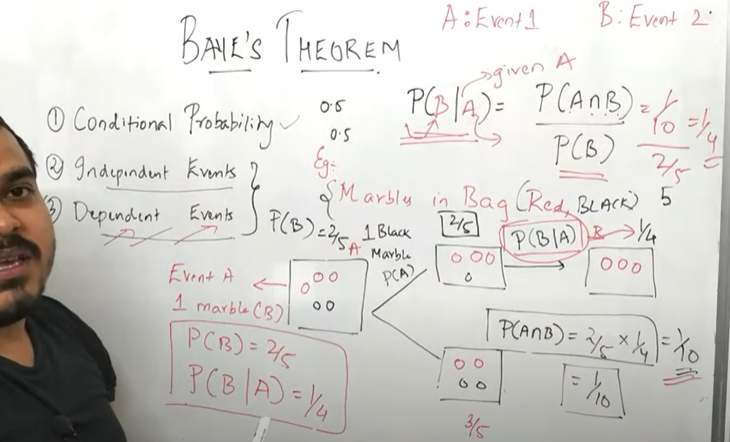

- Posteriot Probablity, Likelihood Probability, Marginal prob, and Prior Prob
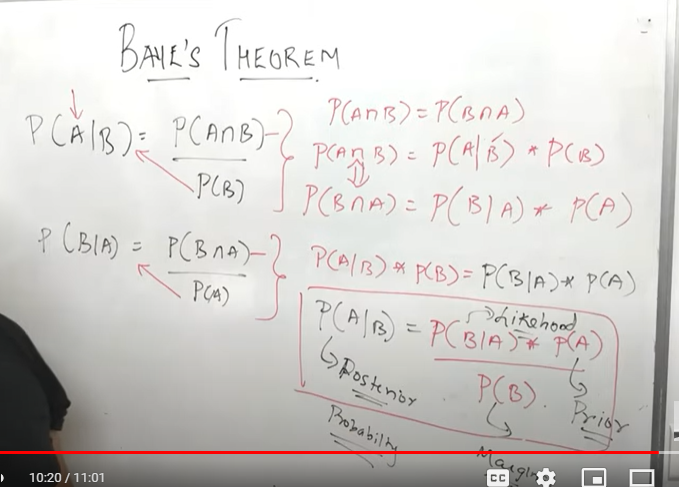

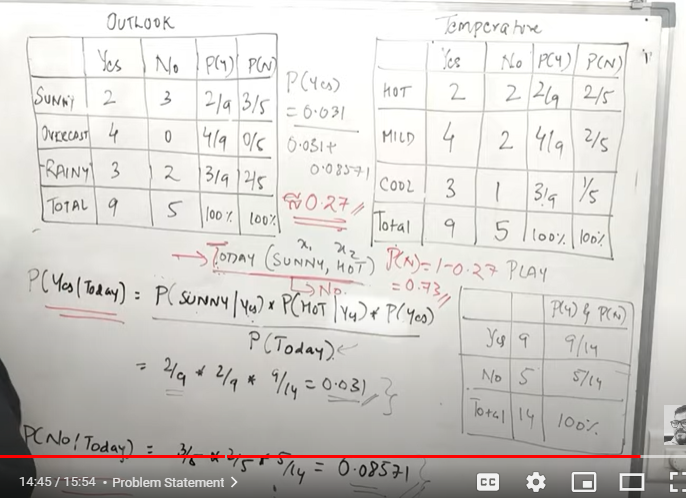

**How To Apply Naive Bayes' Classifier On Text Data (NLP)**
- The Naive Bayes classifier is a simple classifier that classifies based on probabilities of events. It is the applied commonly to text classification. Though it is a simple algorithm, it performs well in many text classification problems. Other Pros include less training time and less training data.

 - The prob of each word is checked as so is the output. 
  - Doesn't perform well for new words. 


Naive Bayes has 3 types of classifiers:
- Bernoulli - Assume all features are binary
- Multinomial - Have discrete data e.g movie ratings or text data - using count of words
- Gaussian - used in cases wghere the features are continous

### **Practical Implementation: Titanic Survival Rate**

In [72]:
import pandas as pd
df = pd.read_csv("titanic.csv")
df.head()

,PassengerId,Name,Pclass,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked,Survived
0,1,"Braund, Mr. Owen Harris",3,male,22.0,1,0,A/5 21171,7.2500,NaN,S,0
1,2,"Cumings, Mrs. John Bradley (Florence Briggs Th...",1,female,38.0,1,0,PC 17599,71.2833,C85,C,1
2,3,"Heikkinen, Miss. Laina",3,female,26.0,0,0,STON/O2. 3101282,7.9250,NaN,S,1
3,4,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",1,female,35.0,1,0,113803,53.1000,C123,S,1
4,5,"Allen, Mr. William Henry",3,male,35.0,0,0,373450,8.0500,NaN,S,0


In [73]:
df.drop(['PassengerId','Name','SibSp','Parch','Ticket','Cabin','Embarked'],axis='columns',inplace=True)
df.head()

,Pclass,Sex,Age,Fare,Survived
0,3,male,22.0,7.2500,0
1,1,female,38.0,71.2833,1
2,3,female,26.0,7.9250,1
3,1,female,35.0,53.1000,1
4,3,male,35.0,8.0500,0


In [74]:
inputs = df.drop('Survived',axis='columns')
target = df.Survived

In [75]:
dummies = pd.get_dummies(inputs.Sex)
dummies.head(3)

,female,male
0,False,True
1,True,False
2,True,False


In [76]:
inputs = pd.concat([inputs,dummies],axis='columns')
inputs.head(3)

,Pclass,Sex,Age,Fare,female,male
0,3,male,22.0,7.2500,False,True
1,1,female,38.0,71.2833,True,False
2,3,female,26.0,7.9250,True,False


In [77]:
inputs.drop(['Sex','male'],axis='columns',inplace=True)
inputs.head(3)

,Pclass,Age,Fare,female
0,3,22.0,7.2500,False
1,1,38.0,71.2833,True
2,3,26.0,7.9250,True


In [78]:
inputs.columns[inputs.isna().any()]

Index(['Age'], dtype='object')

In [79]:
inputs.Age = inputs.Age.fillna(inputs.Age.mean())
inputs.head()

,Pclass,Age,Fare,female
0,3,22.0,7.2500,False
1,1,38.0,71.2833,True
2,3,26.0,7.9250,True
3,1,35.0,53.1000,True
4,3,35.0,8.0500,False


In [80]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(inputs,target,test_size=0.3)

In [81]:
from sklearn.naive_bayes import GaussianNB  #used when you data has a normal distribution
model = GaussianNB()

In [82]:
model.fit(X_train,y_train)

GaussianNB()

In [83]:
model.score(X_test,y_test)

0.7686567164179104

In [84]:
X_test[0:10]

,Pclass,Age,Fare,female
445,1,4.000000,81.8583,False
238,2,19.000000,10.5000,False
521,3,22.000000,7.8958,False
596,2,29.699118,33.0000,True
46,3,29.699118,15.5000,False
723,2,50.000000,13.0000,False
870,3,26.000000,7.8958,False
505,1,18.000000,108.9000,False
865,2,42.000000,13.0000,True
190,2,32.000000,13.0000,True


In [85]:
y_test[0:10]

445    1
238    0
521    0
596    1
46     0
723    0
870    0
505    0
865    1
190    1
Name: Survived, dtype: int64

In [86]:
model.predict(X_test[0:10])

array([1, 0, 0, 1, 0, 0, 0, 1, 1, 1])

In [87]:
model.predict_proba(X_test[:10])

array([[0.09668179, 0.90331821],
       [0.90715893, 0.09284107],
       [0.96068991, 0.03931009],
       [0.27057486, 0.72942514],
       [0.96492101, 0.03507899],
       [0.86907953, 0.13092047],
       [0.96372058, 0.03627942],
       [0.03532294, 0.96467706],
       [0.26678841, 0.73321159],
       [0.30861515, 0.69138485]])

### **Practical: Email Spam Classification**

In [88]:
import pandas as pd
df = pd.read_csv("spam.csv")
df.head()

,Category,Message
0,ham,"Go until jurong point, crazy.. Available only ..."
1,ham,Ok lar... Joking wif u oni...
2,spam,Free entry in 2 a wkly comp to win FA Cup fina...
3,ham,U dun say so early hor... U c already then say...
4,ham,"Nah I don't think he goes to usf, he lives aro..."


In [89]:
df['spam']=df['Category'].apply(lambda x: 1 if x=='spam' else 0)
df.head()

,Category,Message,spam
0,ham,"Go until jurong point, crazy.. Available only ...",0
1,ham,Ok lar... Joking wif u oni...,0
2,spam,Free entry in 2 a wkly comp to win FA Cup fina...,1
3,ham,U dun say so early hor... U c already then say...,0
4,ham,"Nah I don't think he goes to usf, he lives aro...",0


In [90]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(df.Message,df.spam)

In [91]:
#Using count
from sklearn.feature_extraction.text import CountVectorizer
v = CountVectorizer()
X_train_count = v.fit_transform(X_train.values)
X_train_count.toarray()[:2]

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

In [92]:
from sklearn.naive_bayes import MultinomialNB
model = MultinomialNB()
model.fit(X_train_count,y_train)

MultinomialNB()

In [93]:
emails = [
    'Hey mohan, can we get together to watch footbal game tomorrow?',
    'Upto 20% discount on parking, exclusive offer just for you. Dont miss this reward!'
]
emails_count = v.transform(emails)
model.predict(emails_count)

array([0, 1])

In [94]:
X_test_count = v.transform(X_test)
model.score(X_test_count, y_test)

0.9877961234745154

**Using Sklearn Pipeline**

In [95]:
from sklearn.pipeline import Pipeline
clf = Pipeline([
    ('vectorizer', CountVectorizer()),
    ('nb', MultinomialNB())
])

In [96]:
clf.fit(X_train, y_train)

Pipeline(steps=[('vectorizer', CountVectorizer()), ('nb', MultinomialNB())])

In [97]:
clf.score(X_test,y_test)

0.9877961234745154

In [98]:
clf.predict(emails)

array([0, 1])

## **Support Vector Machines**

- In machine learning, support-vector machines are supervised learning models with associated learning algorithms that analyze data used for classification and regression analysis.

The SVM Components:
- Hyperplanes - creating the parallel hyperlanes
- Marginal Distance - the distance between the parallel hyperplanes. The goal is to select the model with the largest marginal plane.
- Linear Seprable
- Non Linear Separable

Support vectors are the points that are passing close to the marginal plane. 

Uses technique called SVM kernels - converting from a lower dimension to High Dimension
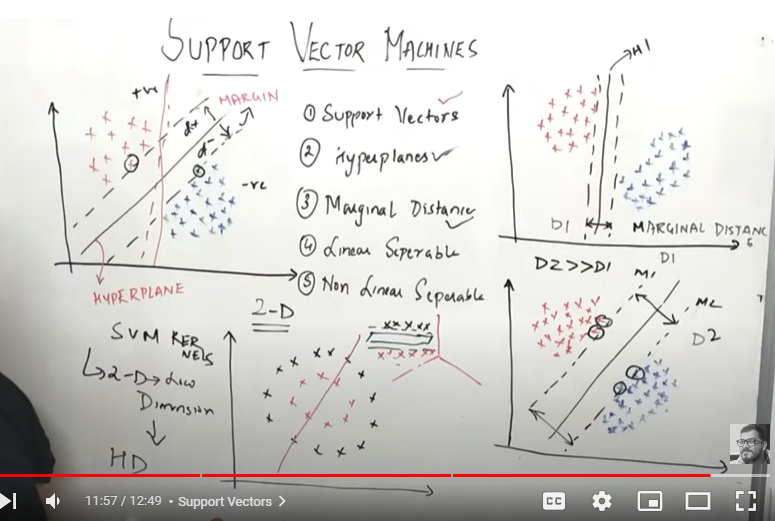

There are two types of margin:
- soft margin
- Hard Margin

**SVM Kernal- Polynomial And RBF Implementation Using Sklearn**

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

x = np.linspace(-5.0, 5.0, 100)
y = np.sqrt(10**2 - x**2)
y=np.hstack([y,-y])
x=np.hstack([x,-x])

In [4]:
x1 = np.linspace(-5.0, 5.0, 100)
y1 = np.sqrt(5**2 - x1**2)
y1=np.hstack([y1,-y1])
x1=np.hstack([x1,-x1])

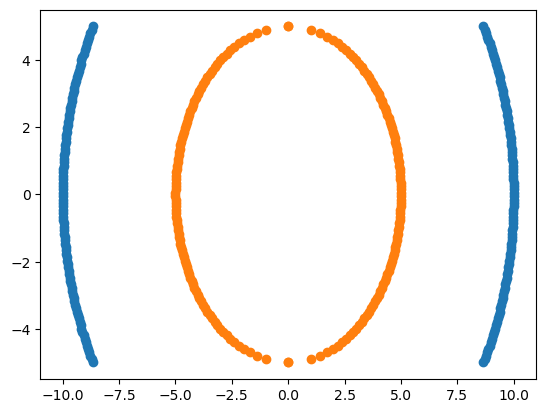

In [5]:
plt.scatter(y,x)
plt.scatter(y1,x1)

In [6]:
np.vstack([y,x]).T

array([[ 8.66025404, -5.        ],
       [ 8.71779204, -4.8989899 ],
       [ 8.77378994, -4.7979798 ],
       [ 8.82827705, -4.6969697 ],
       [ 8.88128118, -4.5959596 ],
       [ 8.93282873, -4.49494949],
       [ 8.98294476, -4.39393939],
       [ 9.03165312, -4.29292929],
       [ 9.07897646, -4.19191919],
       [ 9.12493632, -4.09090909],
       [ 9.16955321, -3.98989899],
       [ 9.21284664, -3.88888889],
       [ 9.25483518, -3.78787879],
       [ 9.29553652, -3.68686869],
       [ 9.3349675 , -3.58585859],
       [ 9.37314414, -3.48484848],
       [ 9.41008171, -3.38383838],
       [ 9.44579475, -3.28282828],
       [ 9.4802971 , -3.18181818],
       [ 9.51360192, -3.08080808],
       [ 9.54572176, -2.97979798],
       [ 9.57666854, -2.87878788],
       [ 9.60645359, -2.77777778],
       [ 9.63508769, -2.67676768],
       [ 9.66258107, -2.57575758],
       [ 9.68894344, -2.47474747],
       [ 9.714184  , -2.37373737],
       [ 9.73831149, -2.27272727],
       [ 9.76133416,

In [7]:
#creating a dataframe with the points
df1 = pd.DataFrame(np.vstack([y,x]).T,columns=['X1','X2'])
df1['Y'] = 0
df2 = pd.DataFrame(np.vstack([y1,x1]).T,columns = ['X1','X2'])
df2['Y'] = 1
df = pd.concat([df1,df2],axis=0)
df.head()

,X1,X2,Y
0,8.660254,-5.00000,0
1,8.717792,-4.89899,0
2,8.773790,-4.79798,0
3,8.828277,-4.69697,0
4,8.881281,-4.59596,0


In [8]:
#Creating independent and dependent features
X = df.iloc[:,:2]
y = df.Y

In [63]:
y

0      0
1      0
2      0
3      0
4      0
      ..
195    1
196    1
197    1
198    1
199    1
Name: Y, Length: 400, dtype: int64

In [9]:
#split the dataset into train & test
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.25,random_state=0)

In [10]:
y_train

50     1
63     0
112    1
159    0
83     1
      ..
123    1
192    0
117    0
47     0
172    0
Name: Y, Length: 300, dtype: int64

**Applying Linear SVM**

In [11]:
from sklearn.svm import SVC
classifier = SVC(kernel = 'linear')
classifier.fit(X_train,y_train)

SVC(kernel='linear')

In [12]:
#checking accuracy
from sklearn.metrics import accuracy_score
y_pred = classifier.predict(X_test)
accuracy_score(y_test,y_pred)

0.45

The low accuracy is due to the fact that given the polynomial behaviour of the data , a linear model cannot classify the data points accurately

**Applying a Polynomial Kernel**

In [13]:
#Finding the components of the polynomial kernel
# X1, X2, X1_square, X2_square
df['X1_Square']= df['X1']**2
df['X2_Square']= df['X2']**2
df['X1*X2'] = (df['X1'] *df['X2'])
df.head()

,X1,X2,Y,X1_Square,X2_Square,X1*X2
0,8.660254,-5.00000,0,75.000000,25.000000,-43.301270
1,8.717792,-4.89899,0,75.999898,24.000102,-42.708375
2,8.773790,-4.79798,0,76.979390,23.020610,-42.096467
3,8.828277,-4.69697,0,77.938476,22.061524,-41.466150
4,8.881281,-4.59596,0,78.877155,21.122845,-40.818009


In [14]:
### Independent and Dependent features
X = df[['X1','X2','X1_Square','X2_Square','X1*X2']]
y = df['Y']

In [15]:
import plotly.express as px

fig = px.scatter_3d(df, x='X1', y='X2', z='X1*X2',
              color='Y')
fig.show()

In [16]:
fig = px.scatter_3d(df, x='X1_Square', y='X1_Square', z='X1*X2',
              color='Y')
fig.show()

From the above viz, we can tell with the new features, the data points can now be classified with a linear model

In [17]:
#Creating train and test samples
X_train, X_test, y_train, y_test = train_test_split(X, y, 
                                                    test_size = 0.25, 
                                                    random_state = 0)

In [18]:
X_train

,X1,X2,X1_Square,X2_Square,X1*X2
50,4.999745,0.050505,24.997449,0.002551,0.252512
63,9.906589,1.363636,98.140496,1.859504,13.508984
112,-3.263736,3.787879,10.651974,14.348026,-12.362637
159,-9.953852,-0.959596,99.079176,0.920824,9.551676
83,3.680983,3.383838,13.549638,11.450362,12.455852
...,...,...,...,...,...
123,-4.223140,2.676768,17.834915,7.165085,-11.304366
192,-9.031653,-4.292929,81.570758,18.429242,38.772248
117,-9.445795,3.282828,89.223038,10.776962,-31.008922
47,9.996811,-0.252525,99.936231,0.063769,-2.524447


In [19]:
classifier = SVC(kernel="linear")
classifier.fit(X_train, y_train)
y_pred = classifier.predict(X_test)
accuracy_score(y_test, y_pred)

1.0

The accuracy score is now 1. We can also still apply 'rbf' kernel without needing to feature engineer the new features. 

In [20]:
#Creating independent and dependent features
X = df.iloc[:,:2]
y = df.Y

In [21]:
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.25,random_state=0)

In [22]:
classifier = SVC(kernel = 'rbf')
classifier.fit(X_train,y_train)
y_pred = classifier.predict(X_test)
accuracy_score(y_test,y_pred)

1.0

### **Gradient Boosting**

- Gradient boosting is typically used with decision trees (especially CART trees) of a fixed size as base learners. For this special case, Friedman proposes a modification to gradient boosting method which improves the quality of fit of each base learner.

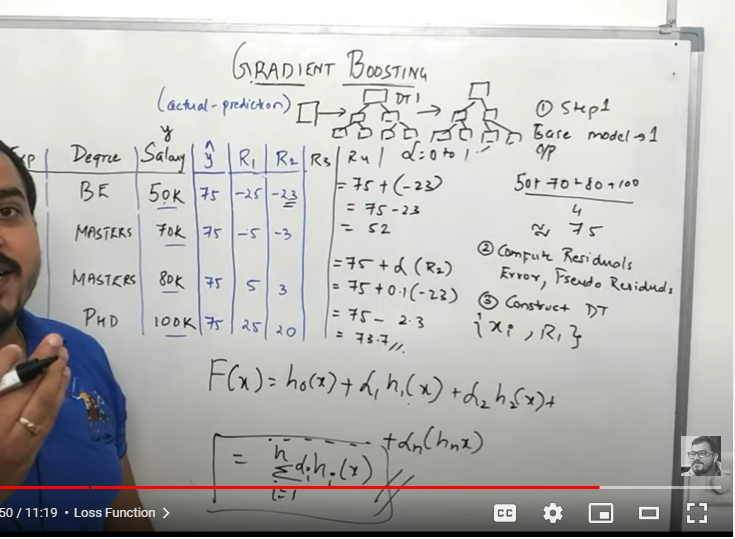

### **XGBoost**

- XGBoost is a decision-tree-based ensemble Machine Learning algorithm that uses a gradient boosting framework. In prediction problems involving unstructured data (images, text, etc.) artificial neural networks tend to outperform all other algorithms or frameworks.
- Extreme Gradient(XG) Boost is good for solving multi class classification problems
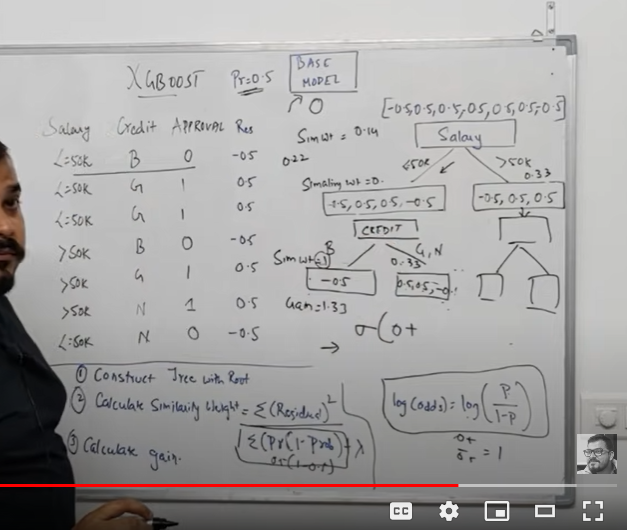